In [45]:
%matplotlib inline
import numpy as np
import scipy.stats
from scipy.stats import ttest_ind, ttest_1samp
import pandas as pd
from importlib import reload

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn3
import seaborn as sns

import statsmodels.stats as stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
import scipy.stats

import TreeMazeAnalyses2,Analyses.tree_maze_functions as tmf
import TreeMazeAnalyses2,Analyses.paper_stats as ps
import TreeMazeAnalyses2.Analyses.experiment_info as ei
import TreeMazeAnalyses2.Analyses.plot_functions as pf
import TreeMazeAnalyses2.Utils.robust_stats as rs

import ipywidgets as widgets
from ipywidgets import interact, fixed, interact_manual

from joblib import delayed, Parallel

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)

In [46]:
ei = reload(ei)
info = ei.SummaryInfo()
info.update_paths()

In [47]:
t = info.get_tm_scores()

In [65]:
t = t[t.unit_type=='cell'].copy()
for z in ['cue','rw']:

    str_vals = {'Inco': -1, '~Inco': -1 / 3, '~Co': 1 / 3, 'Co': 1}
    str_vals_list = list(str_vals.keys())
    var = f'fr_uz_tau_{z}_correct'
    new_var = f'{z}_c'
    dependent_var = f'remap_{z}'

    t[new_var] = ''
    for k, v in str_vals.items():
        t.loc[t[var] == v, new_var] = k

    t[new_var].astype(pd.CategoricalDtype(categories=str_vals_list, ordered=True))

    x = t.loc[t[new_var]=='Co', dependent_var].dropna()
    y = t.loc[t[new_var]=='Inco', dependent_var].dropna()
    print(f"strict {z}\n", scipy.stats.ks_2samp(x,y))

    x = t.loc[t[var]>0, dependent_var].dropna()
    y = t.loc[t[var]<0, dependent_var].dropna()
    print(f"liberal {z}\n", scipy.stats.ks_2samp(x,y))
#cond1=t[]  
#scipy.stats.ks_2samp(t.loc[])

strict cue
 KstestResult(statistic=0.06570347437220503, pvalue=0.9870316647302003)
liberal cue
 KstestResult(statistic=0.09788359788359788, pvalue=0.1716198368701316)
strict rw
 KstestResult(statistic=0.1392857142857143, pvalue=0.5595300027674184)
liberal rw
 KstestResult(statistic=0.0757944969032389, pvalue=0.5357919259863503)


In [64]:
x = t.loc[t[new_var]=='Co', dependent_var].dropna()
y = t.loc[t[new_var]=='Inco', dependent_var].dropna()
print(f"strict {z}\n", scipy.stats.ks_2samp(x,y))

x = t.loc[t[var]>0, dependent_var].dropna()
y = t.loc[t[var]<0, dependent_var].dropna()
print(f"liberal {z}\n", scipy.stats.ks_2samp(x,y))

strict cue
 KstestResult(statistic=0.06570347437220503, pvalue=0.9870316647302003)
liberal cue
 KstestResult(statistic=0.09788359788359788, pvalue=0.1716198368701316)


In [62]:
x = t.loc[t[var]>0, dependent_var].dropna()
y = t.loc[t[var]<0, dependent_var].dropna()
scipy.stats.ks_2samp(x,y)

KstestResult(statistic=0.09788359788359788, pvalue=0.1716198368701316)

In [68]:
%%time
session = 'Li_T3g_053018'
si = info.get_session(session)
t =si.get_zone_decoder_dec_rw()

CPU times: user 274 ms, sys: 3.99 ms, total: 278 ms
Wall time: 277 ms


In [70]:
t['cue_match']=t['cue']==t['pred']

0        True
1        True
2        True
3       False
4       False
        ...  
2895    False
2896    False
2897    False
2898    False
2899    False
Length: 8700, dtype: bool

In [66]:
%%time
session = 'Li_T3g_053018'
si = info.get_session(session)
t =si.get_zone_neural_decoder()

CPU times: user 288 ms, sys: 0 ns, total: 288 ms
Wall time: 287 ms


In [67]:
t

,feature_type,target_type,feature_add,trial_type,fold,trial,cue,dec,correct,long,zones,target,pred,acc,bac,dist,pr_target,pr_pred,logit_dist,ldn
0,neural,zones,None,out,0,3.0,L,L,1.0,0.0,D,D,D,1.0,1.000000,0.000000,0.140427,0.140427,0.000000,1.000000
1,neural,zones,None,out,0,3.0,L,L,1.0,0.0,G,G3,D,0.0,0.079464,808.236425,0.026777,0.048673,0.620339,22.931050
2,neural,zones,None,out,0,3.0,L,L,1.0,0.0,G,G4,b_0,0.0,0.079464,826.062834,0.025460,0.042593,0.532298,4.166455
3,neural,zones,None,out,0,3.0,L,L,1.0,0.0,H,H,a_0,0.0,0.533333,109.655172,0.063004,0.068584,0.090840,0.729476
4,neural,zones,None,out,0,3.0,L,L,1.0,0.0,a_0,a_0,a_0,1.0,0.766667,0.000000,0.364574,0.364574,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905,neural,zones,rw,in,4,143.0,R,R,1.0,1.0,be_5,b_5,g_2,0.0,0.100000,768.988951,0.028256,0.062326,0.826775,-2.541959
2906,neural,zones,rw,in,4,143.0,R,R,1.0,1.0,cdfg_0,c_0,g_2,0.0,0.062500,901.495039,0.019740,0.066220,1.258936,-3.222018
2907,neural,zones,rw,in,4,143.0,R,R,1.0,1.0,cdfg_1,c_1,d_2,0.0,0.019231,279.751286,0.039607,0.078054,0.719256,-0.513078
2908,neural,zones,rw,in,4,143.0,R,R,1.0,1.0,cdfg_2,c_2,f_2,0.0,0.060897,796.157030,0.040467,0.054165,0.305938,-2.624310


In [3]:
%%time
session = 'Li_T3g_053018'
si = info.get_session(session)
t =si.get_zone_neural_decoder(verbose=True, overwrite=True)

Decoder Fitting: fea=neural, fea_add=None, target=zones, trial_type=out  Fitting Complete.  8.38s
Decoder Fitting: fea=neural, fea_add=None, target=zones, trial_type=out_co  Fitting Complete.  7.74s
Decoder Fitting: fea=neural, fea_add=cue, target=zones, trial_type=out  Fitting Complete.  8.94s
Decoder Fitting: fea=neural, fea_add=cue, target=zones, trial_type=out_co  Fitting Complete.  8.34s
Decoder Fitting: fea=neural, fea_add=None, target=zones, trial_type=in  Fitting Complete.  2.59s
Decoder Fitting: fea=neural, fea_add=rw, target=zones, trial_type=in  Fitting Complete.  2.75s
CPU times: user 2min 45s, sys: 3.03 s, total: 2min 48s
Wall time: 52.7 s


<AxesSubplot:xlabel='zones', ylabel='pr_pred'>

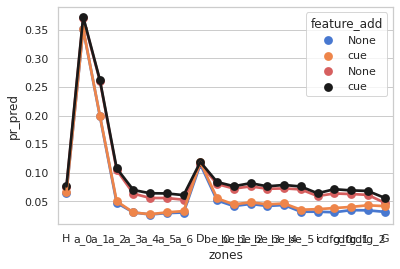

In [42]:
t2 = t[(t.trial_type=='out')].groupby(['zones', 'feature_add']).mean().reset_index()

sns.pointplot(data=t2, x='zones', y='pr_target', hue='feature_add')

sns.pointplot(data=t2, x='zones', y='pr_pred', hue='feature_add', palette=['r','k'])


<AxesSubplot:xlabel='zones', ylabel='bac'>

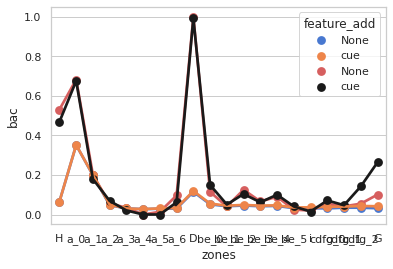

In [41]:
sns.pointplot(data=t2, x='zones', y='pr_target', hue='feature_add')

t2 = t[(t.trial_type=='out')].groupby(['zones', 'feature_add']).mean().reset_index()

sns.pointplot(data=t2, x='zones', y='bac', hue='feature_add', palette=['r','k'])

<AxesSubplot:xlabel='zones', ylabel='logit_dist'>

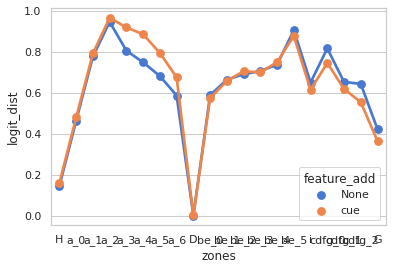

In [11]:
t2 = t[(t.trial_type=='out')].groupby(['zones', 'feature_add']).mean().reset_index()

sns.pointplot(data=t2, x='zones', y='logit_dist', hue='feature_add')

<AxesSubplot:xlabel='zones', ylabel='dist'>

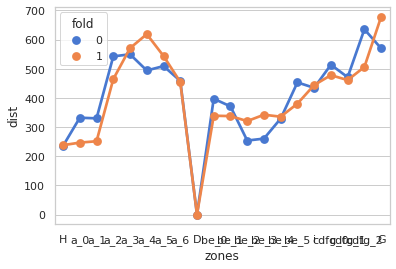

In [26]:
t2 = t[(t.trial_type=='out_co')].groupby(['zones', 'feature_add', 'fold']).mean().reset_index()

sns.pointplot(data=t2[t2.feature_add=='None'], x='zones', y='dist', hue='fold')

<AxesSubplot:xlabel='zones', ylabel='dist'>

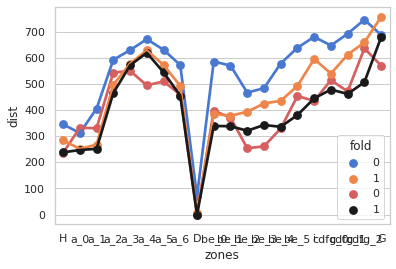

In [31]:
t2 = t[(t.trial_type=='out_co')].groupby(['zones', 'feature_add', 'fold']).mean().reset_index()

sns.pointplot(data=t2[t2.feature_add=='cue'], x='zones', y='dist', hue='fold')
sns.pointplot(data=t2[t2.feature_add=='None'], x='zones', y='dist', hue='fold', palette=['r','k'])

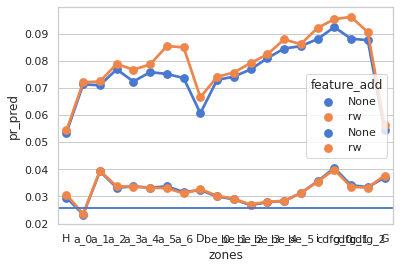

In [38]:
t2 = t[(t.trial_type=='in')].groupby(['zones', 'feature_add']).mean().reset_index()

sns.pointplot(data=t2, x='zones', y='pr_target', hue='feature_add')
plt.axhline(1/39)
sns.pointplot(data=t2, x='zones', y='pr_pred', hue='feature_add')
plt.axhline(1/39)

In [3]:
%%time
session = 'Li_T3g_053018'
si = info.get_session(session)
si.get_zone_decoder_dec_rw(verbose=True, overwrite=True)

Decoder Fitting: fea=neural, fea_add=None, target=dec, trial_type=out  Fitting Complete.  2.46s
Decoder Fitting: fea=neural, fea_add=None, target=dec, trial_type=out_co  Fitting Complete.  1.27s
Decoder Fitting: fea=neural, fea_add=None, target=rw, trial_type=in  Fitting Complete.  1.83s
CPU times: user 47.2 s, sys: 1.95 s, total: 49.2 s
Wall time: 18 s


,feature_type,target_type,feature_add,trial_type,fold,trial,cue,dec,correct,long,zones,target,pred,acc,bac,dist,pr_target,pr_pred,logit_dist,ldn
0,neural,dec,None,out,2,0.0,R,L,0.0,NaN,H,L,R,0.0,0.497475,1.0,0.475477,0.524523,0.196341,-1.0
1,neural,dec,None,out,4,1.0,R,L,0.0,NaN,H,L,R,0.0,0.533333,1.0,0.468443,0.531557,0.252789,-1.0
2,neural,dec,None,out,1,2.0,R,R,1.0,1.0,H,R,R,1.0,0.466667,0.0,0.552673,0.552673,0.000000,1.0
3,neural,dec,None,out,0,3.0,L,L,1.0,0.0,H,L,R,0.0,0.522727,1.0,0.465553,0.534447,0.276010,-1.0
4,neural,dec,None,out,3,4.0,L,L,1.0,1.0,H,L,R,0.0,0.677778,1.0,0.485074,0.514926,0.119446,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2895,neural,rw,None,in,3,140.0,R,R,1.0,0.0,G,RW,RW,1.0,0.387681,0.0,0.965637,0.965637,0.000000,1.0
2896,neural,rw,None,in,1,141.0,L,L,1.0,1.0,G,RW,RW,1.0,0.507246,0.0,0.999165,0.999165,0.000000,1.0
2897,neural,rw,None,in,0,142.0,R,R,1.0,1.0,G,RW,NRW,0.0,0.568323,1.0,0.110101,0.889899,4.179430,-1.0
2898,neural,rw,None,in,4,143.0,R,R,1.0,1.0,G,RW,RW,1.0,0.719697,0.0,0.539269,0.539269,0.000000,1.0


In [6]:
ta = tmf.TrialAnalyses(si)

In [38]:
%%time
tmf = reload(tmf)
ze = tmf.ZoneEncoder(session_info=si, trial_analyses=ta, n_folds=5, feature_params=dict(trial_seg='in', trial_balance='correct'))

CPU times: user 1.14 s, sys: 35.9 ms, total: 1.17 s
Wall time: 1.17 s


In [55]:
tmf = reload(tmf)
decoder = tmf.ZoneDecoder(zone_encoder=ze,
                                  feature_type='neural',
                                  target_type='rw',
                                  feature_adds='None',
                                  )

decoder.get_decoder_model_fit()
decoder.get_trial_zone_evidence_table()
decoder.get_cummulative_trial_decoder2()
decoder_results_table = decoder.trial_zone_cummulative_perf_table.copy()

<AxesSubplot:xlabel='zones', ylabel='bac'>

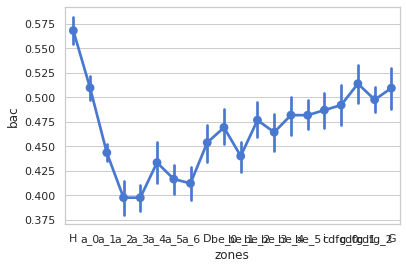

In [72]:
sns.pointplot(data=decoder_results_table, x='zones', y='bac')

In [40]:
t = decoder.get_trial_zone_evidence_table()

In [54]:
self = decoder
evidence_table=t
X = {}
for target_class in self.target_classes:
    X[target_class] = evidence_table.pivot_table(index='trial', columns='zones', values=target_class)
    X[target_class] = logit(X[target_class])
    X[target_class] = X[target_class].fillna(0)
    X[target_class] = X[target_class].cumsum(axis=1)

trials = X[target_class].index
n_trials = X[target_class].shape[0]
n_zones = X[target_class].shape[1]
n_classes = len(self.target_classes)

prob_by_class = np.zeros((n_classes, n_trials, n_zones))
for ii, target_class in enumerate(self.target_classes):
    prob_by_class[ii] = X[target_class]

prob_df = pd.DataFrame()
for ii, target_class in enumerate(self.target_classes):
    class_probs = pd.DataFrame(prob_by_class[ii], index=trials, columns=zone_names)
    class_probs = class_probs.reset_index().melt(id_vars=['trial'], var_name='zones',
                                                 value_name=target_class)
    if ii == 0:
        prob_df = class_probs
    else:
        prob_df[target_class] = class_probs[target_class]

target = self.trial_info_table[self.target_type][self.ze.valid_trials]
preds = np.array(self.target_classes)[prob_by_class.argmax(axis=0)]
preds = pd.DataFrame(data=preds, index=trials, columns=zone_names)

NameError: name 'logit' is not defined

In [53]:
evidence_table.pivot_table(index='trial', columns='zones', values=target_class)

zones,H,a_0,a_1,a_2,a_3,a_4,a_5,a_6,D,be_0,be_1,be_2,be_3,be_4,be_5,i,cdfg_0,cdfg_1,cdfg_2,G
trial,,,,,,,,,,,,,,,,,,,,
0.0,0.493387,0.425437,0.490162,0.495582,0.511338,0.504475,0.495798,0.488587,0.491643,0.491321,0.485577,0.497061,0.507835,0.487609,0.496789,0.477785,0.501283,0.500062,0.501197,0.500920
1.0,0.470824,0.528992,0.497802,0.451296,0.465925,0.515578,0.484994,0.499568,0.502048,0.503790,0.480659,0.492083,0.494703,0.616520,0.572634,0.595144,0.556039,0.584056,0.608060,0.502353
2.0,0.526940,0.498891,0.520547,0.504633,0.477756,0.554546,0.511891,0.510283,0.526609,0.517137,0.535014,0.565000,0.549876,0.512080,0.576681,0.504016,NaN,0.515090,0.496307,0.528011
3.0,0.491759,0.494394,0.522845,0.504775,0.511263,0.506763,0.491899,0.488710,0.510825,0.518420,0.505011,0.511645,0.504468,0.493094,0.523458,0.538061,0.517581,0.488214,0.479897,0.497581
4.0,0.518117,0.486875,0.499309,0.496723,0.474444,0.522574,0.515538,0.517792,0.491680,0.491763,0.490324,0.499074,0.499646,0.522191,0.469891,0.499860,0.514458,0.515033,0.563397,0.516035
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140.0,0.477900,0.510461,0.602323,0.578342,0.512420,0.531016,0.565397,0.523619,0.545952,0.526622,0.509091,0.535822,0.543120,0.518676,0.608918,0.569649,0.534730,0.568261,0.570434,0.492475
141.0,0.550440,0.545495,0.471490,0.493031,0.549269,0.531415,0.589206,0.615155,0.548002,0.482690,0.534662,0.675974,0.616725,0.625116,0.621069,0.593267,0.717716,0.763237,0.673608,0.502673
142.0,0.469654,0.439457,0.450285,0.476491,0.464169,0.547251,0.495114,0.469354,0.464637,0.462615,0.444312,0.462472,0.473905,0.478597,0.493343,0.454024,0.470945,0.466257,0.501469,0.494753


In [50]:
evidence_table.pivot(index='trial', columns='zones', values=target_class)

ValueError: Index contains duplicate entries, cannot reshape

In [31]:
decoder.get_fold_decoder_predictions(0, 'train')

array(['RW', 'NRW', 'NRW', ..., 'NRW', 'NRW', 'NRW'], dtype='<U32')

In [36]:
decoder.get_targets(0,'test')

array(['RW', 'RW', 'RW', ..., 'RW', 'RW', 'RW'], dtype='<U32')

In [20]:
ze.trial_table.loc[ze.xval_trial_table[4]=='train'].correct.sum()

24.0

In [2]:
t = info.get_zone_decoder_cue(overwrite=True)

NameError: name 'info' is not defined

In [170]:
t['n_units_cat'] = pd.qcut(t.n_units,3)

<AxesSubplot:xlabel='zones', ylabel='bac'>

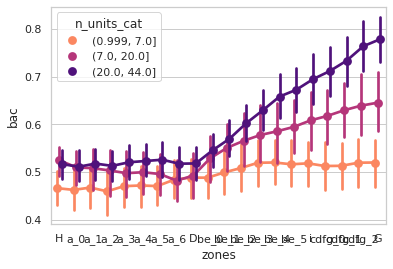

In [190]:
# sns.lineplot(data=t[t.target_type=='dec'], x='zones', y='acc', units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[t.target_type=='dec'], x='zones', y='bac', hue='n_units_cat', palette="magma_r", dodge=0.3)

<AxesSubplot:xlabel='zones', ylabel='bac'>

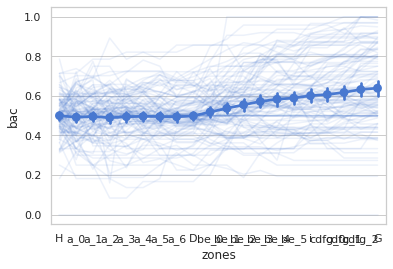

In [143]:
sns.lineplot(data=t[t.target_type=='dec'], x='zones', y='bac', units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[t.target_type=='dec'], x='zones', y='bac')

<AxesSubplot:xlabel='zones', ylabel='ldn'>

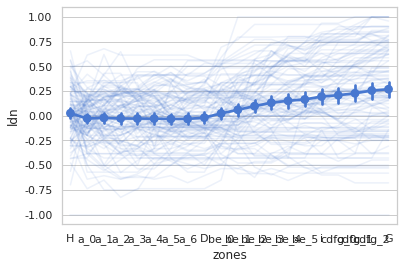

In [149]:
sns.lineplot(data=t[t.target_type=='dec'], x='zones', y='ldn', units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[t.target_type=='dec'], x='zones', y='ldn')

<AxesSubplot:xlabel='zones', ylabel='acc'>

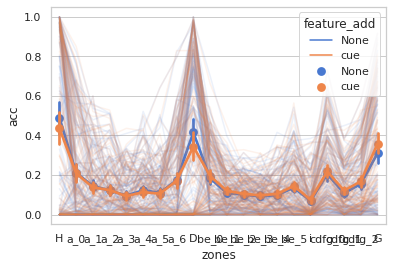

In [151]:
sns.lineplot(data=t[t.target_type=='zones'], x='zones', y='acc', hue='feature_add',units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[t.target_type=='zones'], x='zones', y='acc', hue='feature_add')

<AxesSubplot:xlabel='zones', ylabel='dist'>

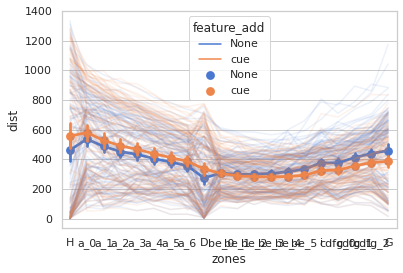

In [157]:
sns.lineplot(data=t[t.target_type=='zones'], x='zones', y='dist', hue='feature_add',units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[t.target_type=='zones'], x='zones', y='dist', hue='feature_add')
#plt.ylim([-1, 5])

<AxesSubplot:xlabel='zones', ylabel='dist'>

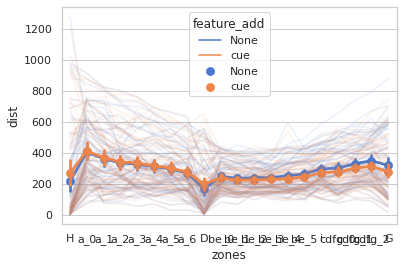

In [167]:
sns.lineplot(data=t[(t.target_type=='zones') & (t.n_units>8)], x='zones', y='dist', hue='feature_add',units='session', estimator=None, alpha=0.1)
sns.pointplot(data=t[(t.target_type=='zones') & (t.n_units>8)], x='zones', y='dist', hue='feature_add')
#plt.ylim([-10,10])

AttributeError: module 'Analyses.tree_maze_functions' has no attribute 'zone_decoder_dec_rw_analyses'

In [74]:
t = si.get_zone_decoder_cue()

In [105]:
t1 = t[t.target_type=='dec'].copy()
t1 = t1.groupby(['zones']).mean().reset_index()

In [106]:
t1

,zones,fold,trial,correct,long,acc,bac,dist,pr_target,pr_pred,logit_dist,ldn
0,H,0.0,69.16129,0.0,NaN,0.612903,0.547619,0.387097,0.502794,0.518262,0.061977,0.225806
1,a_0,0.0,69.16129,0.0,NaN,0.806452,0.672619,0.193548,0.549688,0.573059,0.094867,0.612903
2,a_1,0.0,69.16129,0.0,NaN,0.838710,0.693452,0.161290,0.577309,0.612666,0.145496,0.677419
3,a_2,0.0,69.16129,0.0,NaN,0.806452,0.723214,0.193548,0.591669,0.639435,0.198321,0.612903
4,a_3,0.0,69.16129,0.0,NaN,0.806452,0.723214,0.193548,0.606339,0.666994,0.256624,0.612903
5,a_4,0.0,69.16129,0.0,NaN,0.806452,0.723214,0.193548,0.615395,0.678184,0.269096,0.612903
6,a_5,0.0,69.16129,0.0,NaN,0.806452,0.723214,0.193548,0.619928,0.688453,0.298944,0.612903
7,a_6,0.0,69.16129,0.0,NaN,0.806452,0.723214,0.193548,0.620040,0.698247,0.349442,0.612903
8,D,0.0,69.16129,0.0,NaN,0.774194,0.651786,0.225806,0.628056,0.710792,0.378054,0.548387
9,be_0,0.0,69.16129,0.0,NaN,0.741935,0.630952,0.258065,0.615676,0.713070,0.453714,0.483871


<AxesSubplot:xlabel='zones', ylabel='acc'>

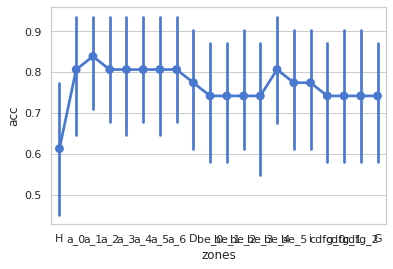

In [99]:
sns.pointplot(data=t1, x='zones', y='acc')

In [118]:
t.loc[t['feature_add'].isna(), 'feature_add'] = 'None'

In [120]:
t.groupby(['zones', 'target_type', 'feature_add'], observed=True)['acc', 'bac', 'dist', 'logit_dist', 'ldn', 'pr_target'].mean().reset_index()

,zones,target_type,feature_add,acc,bac,dist,logit_dist,ldn,pr_target
0,H,dec,None,0.612903,0.547619,0.387097,0.061977,0.225806,0.502794
1,H,zones,None,0.531034,0.531034,245.388110,0.144740,1.311868,0.065216
2,H,zones,cue,0.468966,0.468966,330.808301,0.159019,0.979343,0.065681
3,a_0,dec,None,0.806452,0.672619,0.193548,0.094867,0.612903,0.549688
4,a_0,zones,None,0.682759,0.682759,277.912508,0.463707,0.843915,0.351300
...,...,...,...,...,...,...,...,...,...
55,cdfg_2,zones,None,0.045662,0.054695,538.608231,0.642998,-0.591008,0.034298
56,cdfg_2,zones,cue,0.127854,0.137136,379.169857,0.553645,-0.089346,0.043153
57,G,dec,None,0.741935,0.630952,0.258065,0.841363,0.483871,0.643030
58,G,zones,None,0.076923,0.100546,573.187012,0.421364,-0.604699,0.031724


In [108]:
t2 = t[t.target_type=='zones'].copy()
t2 = t2.groupby(['zones', 'target_type']).mean().reset_index()
t2

,zones,target_type,fold,trial,correct,long,acc,bac,dist,pr_target,pr_pred,logit_dist,ldn
0,H,zones,1.972414,72.000000,0.786207,0.570175,0.500000,0.500000,288.098206,0.065449,0.075426,0.151880,1.145606
1,a_0,zones,1.972414,72.000000,0.786207,0.570175,0.679310,0.679310,274.625160,0.351595,0.371981,0.471381,2.923089
2,a_1,zones,1.972414,72.000000,0.786207,0.570175,0.193103,0.193103,299.144635,0.199332,0.261406,0.783891,-4.363461
3,a_2,zones,1.972414,72.000000,0.786207,0.570175,0.062069,0.062069,477.935772,0.048800,0.106358,0.955525,1.097607
4,a_3,zones,1.972414,72.000000,0.786207,0.570175,0.027586,0.027586,587.521951,0.030628,0.066711,0.861508,-1.187461
5,a_4,zones,1.972414,72.000000,0.786207,0.570175,0.000000,0.000000,641.677674,0.027260,0.060078,0.816698,-0.914720
6,a_5,zones,1.972414,72.000000,0.786207,0.570175,0.006897,0.006897,554.203116,0.030191,0.059871,0.736760,-0.910173
7,a_6,zones,1.972414,72.000000,0.786207,0.570175,0.082759,0.082759,497.829167,0.031752,0.056918,0.630131,2.202411
8,D,zones,1.972414,72.000000,0.786207,0.570175,0.996552,0.996552,2.787022,0.116861,0.116871,0.000205,0.997804
9,be_0,zones,1.944828,72.848276,0.772414,0.562500,0.172414,0.131927,349.611446,0.053449,0.082139,0.580559,-2.474380


<AxesSubplot:xlabel='zones', ylabel='ldn'>

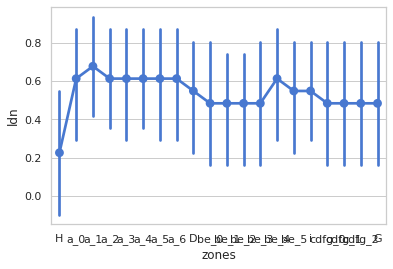

In [103]:
sns.pointplot(data=t1, x='zones', y='ldn')

In [82]:
t['target_type'].value_counts()

zones    6332
dec       620
Name: target_type, dtype: int64

In [87]:
t2 =t.groupby(['feature_type',
                                                                           'target_type', 'feature_add', 'fold', 'zones', 'cue'])[
                            'acc', 'bac', 'dist', 'logit_dist', 'ldn'].mean().reset_index()

In [88]:
t2[t2.target_type=='dec']

,feature_type,target_type,feature_add,fold,zones,cue,acc,bac,dist,logit_dist,ldn
0,neural,dec,cue,0,H,L,NaN,NaN,NaN,NaN,NaN
1,neural,dec,cue,0,H,R,NaN,NaN,NaN,NaN,NaN
2,neural,dec,cue,0,a_0,L,NaN,NaN,NaN,NaN,NaN
3,neural,dec,cue,0,a_0,R,NaN,NaN,NaN,NaN,NaN
4,neural,dec,cue,0,a_1,L,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
195,neural,dec,cue,4,cdfg_1,R,NaN,NaN,NaN,NaN,NaN
196,neural,dec,cue,4,cdfg_2,L,NaN,NaN,NaN,NaN,NaN
197,neural,dec,cue,4,cdfg_2,R,NaN,NaN,NaN,NaN,NaN
198,neural,dec,cue,4,G,L,NaN,NaN,NaN,NaN,NaN


In [77]:
t.groupby?

Signature:
t.groupby(
    by=None,
    axis: 'Axis' = 0,
    level: 'Level | None' = None,
    as_index: 'bool' = True,
    sort: 'bool' = True,
    group_keys: 'bool' = True,
    squeeze: 'bool | lib.NoDefault' = <no_default>,
    observed: 'bool' = False,
    dropna: 'bool' = True,
) -> 'DataFrameGroupBy'
Docstring:
Group DataFrame using a mapper or by a Series of columns.

A groupby operation involves some combination of splitting the
object, applying a function, and combining the results. This can be
used to group large amounts of data and compute operations on these
groups.

Parameters
----------
by : mapping, function, label, or list of labels
    Used to determine the groups for the groupby.
    If ``by`` is a function, it's called on each value of the object's
    index. If a dict or Series is passed, the Series or dict VALUES
    will be used to determine the groups (the Series' values are first
    aligned; see ``.align()`` method). If an ndarray is passed, the
    values are

In [68]:
%%time
tmf = reload(tmf)
t = tmf.zone_cue_decoder_analyses(si)

Decoder Fitting: fea=neural, fea_add=None, target=dec.  Fitting Complete.  0.76s
Decoder Fitting: fea=neural, fea_add=None, target=zones.  Fitting Complete.  32.00s
Decoder Fitting: fea=neural, fea_add=cue, target=zones.  Fitting Complete.  37.46s
CPU times: user 2min 5s, sys: 1.05 s, total: 2min 6s
Wall time: 1min 19s


In [71]:
t

,subject,session,task,unit_type,cl_name,cue,rw,perf
uuid,,,,,,,,
0,Li,Li_T3g_052818,T3g,mua,Li_T3g_052818-tt2_d16.5_cl11,-0.085066,0.177542,0.716667
1,Li,Li_T3g_052818,T3g,mua,Li_T3g_052818-tt2_d16.5_cl14,-0.100770,0.075356,0.716667
16,Li,Li_T3g_052918,T3g,cell,Li_T3g_052918-tt2_d16.5_cl18,0.000541,0.010475,0.848315
17,Li,Li_T3g_052918,T3g,cell,Li_T3g_052918-tt8_d16.25_cl0,-0.038671,-0.084652,0.848315
18,Li,Li_T3g_052918,T3g,cell,Li_T3g_052918-tt8_d16.25_cl12,-0.068931,0.024321,0.848315
...,...,...,...,...,...,...,...,...
4380,Ca,Ca_T3g_040919,T3g,mua,Ca_T3g_040919-tt11_d18.5_cl8,NaN,NaN,0.831373
4381,Ca,Ca_T3g_041119,T3g,mua,Ca_T3g_041119-tt11_d18.5_cl13,0.002725,0.073820,0.704545
4382,Ca,Ca_T3g_041619,T3g,mua,Ca_T3g_041619-tt11_d18.75_cl4,-0.048476,0.006082,0.627660


In [4]:
si.get_zone_decoder()

,encoder_type,feature_type,target_type,fold,trial,cue,dec,correct,long,zones,target,pred,acc,bac,dist,pr_target,pr_pred,logit_dist
0,Z0,encoder,cue,2,0.0,R,L,0.0,NaN,H,R,L,0.0,0.500000,1.000000,0.482918,0.517082,0.136705
1,Z0,encoder,cue,4,1.0,R,L,0.0,NaN,H,R,L,0.0,0.500000,1.000000,0.459055,0.540945,0.328293
2,Z0,encoder,cue,1,2.0,R,R,1.0,1.0,H,R,L,0.0,0.500000,1.000000,0.443359,0.556641,0.455085
3,Z0,encoder,cue,0,3.0,L,L,1.0,0.0,H,L,L,1.0,0.500000,0.000000,0.552053,0.552053,0.000000
4,Z0,encoder,cue,3,4.0,L,L,1.0,1.0,H,L,L,1.0,0.500000,0.000000,0.575609,0.575609,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3142,neural,neural,zones,4,141.0,L,L,1.0,1.0,cdfg_1,f_1,g_0,0.0,0.039706,225.708831,0.039450,0.068235,0.578341
3143,neural,neural,zones,4,141.0,L,L,1.0,1.0,cdfg_1,g_1,g_0,0.0,0.039706,75.911019,0.056681,0.095593,0.564782
3144,neural,neural,zones,4,141.0,L,L,1.0,1.0,cdfg_2,f_2,f_2,1.0,0.146429,0.000000,0.090890,0.090890,0.000000
3145,neural,neural,zones,4,141.0,L,L,1.0,1.0,cdfg_2,g_2,g_0,0.0,0.146429,128.948575,0.039093,0.062337,0.491109


In [29]:
%%time
tmf = reload(tmf)
ze = tmf.ZoneEncoder(session_info=si, n_folds=5)

CPU times: user 20.9 s, sys: 440 ms, total: 21.4 s
Wall time: 4.68 s


In [30]:
%%time
zd = tmf.ZoneDecoder(zone_encoder=ze, session_info=si, feature_type='neural', target_type='zones')
zd.get_decoder_model_fit()
t0 = zd.get_trial_zone_evidence_table()

zd = tmf.ZoneDecoder(zone_encoder=ze, session_info=si, feature_type='neural', target_type='zones', feature_adds='cue')
zd.get_decoder_model_fit()
t1 = zd.get_trial_zone_evidence_table()

CPU times: user 1min 14s, sys: 240 ms, total: 1min 14s
Wall time: 1min 5s


In [32]:
%%time
zd = tmf.ZoneDecoder(zone_encoder=ze, session_info=si, feature_type='neural', target_type='dec', )
zd.get_decoder_model_fit()
t2 = zd.get_cummulative_trial_decoder2()

CPU times: user 6.58 s, sys: 96.2 ms, total: 6.67 s
Wall time: 3.05 s


In [34]:
%%time
tmf = reload(tmf)
ze = tmf.ZoneEncoder(session_info=si, train_correct_only=True)

CPU times: user 20.6 s, sys: 365 ms, total: 21 s
Wall time: 4.32 s


In [41]:
%%time
zd = tmf.ZoneDecoder(zone_encoder=ze, session_info=si, feature_type='neural', target_type='dec')
zd.get_decoder_model_fit()
t3 = zd.get_cummulative_trial_decoder2()

zd = tmf.ZoneDecoder(zone_encoder=ze, session_info=si, feature_type='neural', target_type='cue')
zd.get_decoder_model_fit()
t4 = zd.get_cummulative_trial_decoder2()

CPU times: user 4.56 s, sys: 80.4 ms, total: 4.64 s
Wall time: 1.63 s


<AxesSubplot:xlabel='zones', ylabel='ldn'>

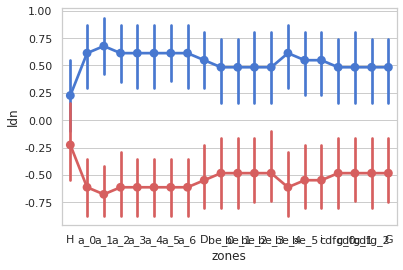

In [42]:
sns.pointplot(x='zones', y='ldn', data=t3)
sns.pointplot(x='zones', y='ldn', data=t4, color='r')

<AxesSubplot:xlabel='zones', ylabel='logit_dist'>

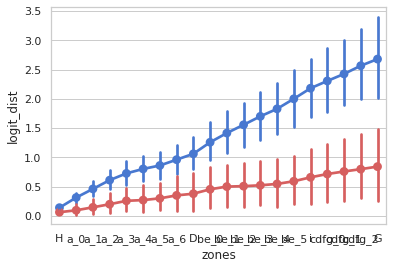

In [37]:
sns.pointplot(x='zones', y='logit_dist', data=t2)
sns.pointplot(x='zones', y='logit_dist', data=t3, color='r')

<AxesSubplot:xlabel='zones', ylabel='acc'>

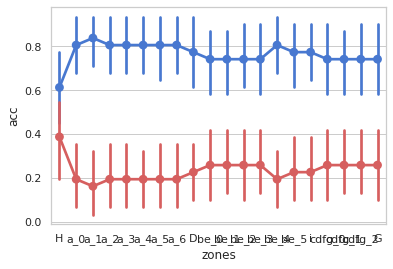

In [44]:
sns.pointplot(x='zones', y='acc', data=t3)
sns.pointplot(x='zones', y='acc', data=t4, color='r')

<AxesSubplot:xlabel='zones', ylabel='pr_target'>

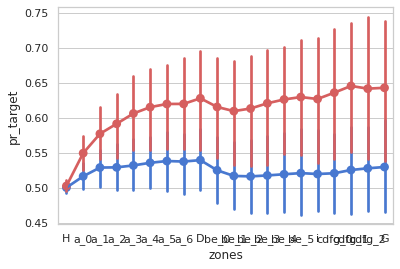

In [39]:
sns.pointplot(x='zones', y='pr_target', data=t2)
sns.pointplot(x='zones', y='pr_target', data=t3, color='r')


In [54]:
pd.cut?

Signature:
pd.cut(
    x,
    bins,
    right: bool = True,
    labels=None,
    retbins: bool = False,
    precision: int = 3,
    include_lowest: bool = False,
    duplicates: str = 'raise',
    ordered: bool = True,
)
Docstring:
Bin values into discrete intervals.

Use `cut` when you need to segment and sort data values into bins. This
function is also useful for going from a continuous variable to a
categorical variable. For example, `cut` could convert ages to groups of
age ranges. Supports binning into an equal number of bins, or a
pre-specified array of bins.

Parameters
----------
x : array-like
    The input array to be binned. Must be 1-dimensional.
bins : int, sequence of scalars, or IntervalIndex
    The criteria to bin by.

    * int : Defines the number of equal-width bins in the range of `x`. The
      range of `x` is extended by .1% on each side to include the minimum
      and maximum values of `x`.
    * sequence of scalars : Defines the bin edges allowing for non-uni

In [56]:
t3['trial_groups'] = pd.qcut(t3.trial,2, labels=['early', 'late'])
t4['trial_groups'] = pd.qcut(t4.trial,2, labels=['early', 'late'])

<AxesSubplot:xlabel='zones', ylabel='acc'>

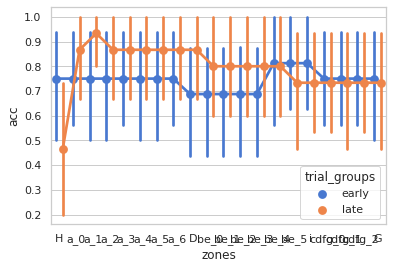

In [57]:
sns.pointplot(x='zones', y='acc', data=t3, hue='trial_groups', dodge=0.4)

<AxesSubplot:xlabel='zones', ylabel='acc'>

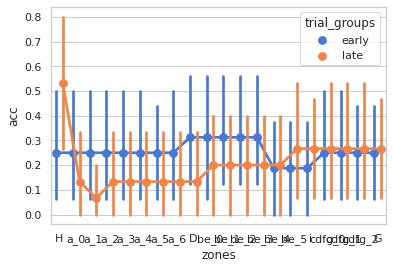

In [58]:
sns.pointplot(x='zones', y='acc', data=t4, hue='trial_groups', dodge=0.4)

<AxesSubplot:xlabel='trial_groups', ylabel='correct'>

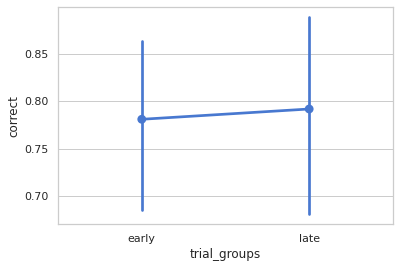

In [61]:
tc = zd.trial_info_table
tc['trial_groups'] = pd.qcut(tc.index,2, labels=['early', 'late'])
sns.pointplot(x='trial_groups', y='correct', data=tc)

In [60]:
t4

,trial,target,zones,pred,pr_pred,pr_target,acc,dist,logit_dist,fold,bac,ldn,trial_groups
0,0.0,R,H,R,0.515809,0.515809,1.0,0.0,0.000000,0,0.452381,1.0,early
1,1.0,R,H,R,0.513105,0.513105,1.0,0.0,0.000000,0,0.452381,1.0,early
2,5.0,L,H,R,0.509106,0.490894,0.0,1.0,0.072860,0,0.452381,-1.0,early
3,10.0,R,H,R,0.513554,0.513554,1.0,0.0,0.000000,0,0.452381,1.0,early
4,22.0,R,H,R,0.512689,0.512689,1.0,0.0,0.000000,0,0.452381,1.0,early
...,...,...,...,...,...,...,...,...,...,...,...,...,...
615,124.0,L,G,L,0.787354,0.787354,1.0,0.0,0.000000,0,0.369048,1.0,late
616,125.0,R,G,L,0.885998,0.114002,0.0,1.0,4.100997,0,0.369048,-1.0,late
617,136.0,L,G,L,0.953298,0.953298,1.0,0.0,0.000000,0,0.369048,1.0,late
618,137.0,L,G,L,0.921501,0.921501,1.0,0.0,0.000000,0,0.369048,1.0,late


ValueError: x and y must be the same size

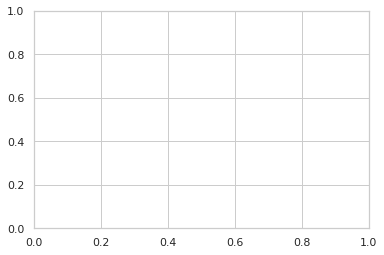

In [59]:
plt.scatter(t4.pr_target[t4.zones=='D'], tc.correct.loc[:144])

In [357]:
np.random.randn?

Docstring:
randn(d0, d1, ..., dn)

Return a sample (or samples) from the "standard normal" distribution.

.. note::
    This is a convenience function for users porting code from Matlab,
    and wraps `standard_normal`. That function takes a
    tuple to specify the size of the output, which is consistent with
    other NumPy functions like `numpy.zeros` and `numpy.ones`.

.. note::
    New code should use the ``standard_normal`` method of a ``default_rng()``
    instance instead; please see the :ref:`random-quick-start`.

If positive int_like arguments are provided, `randn` generates an array
of shape ``(d0, d1, ..., dn)``, filled
with random floats sampled from a univariate "normal" (Gaussian)
distribution of mean 0 and variance 1. A single float randomly sampled
from the distribution is returned if no argument is provided.

Parameters
----------
d0, d1, ..., dn : int, optional
    The dimensions of the returned array, must be non-negative.
    If no argument is given a single Python

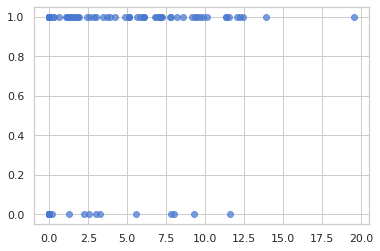

In [355]:
plt.scatter(t2.logit_dist[t2.zones=='G'], tc.correct.loc[:144],alpha=0.7)

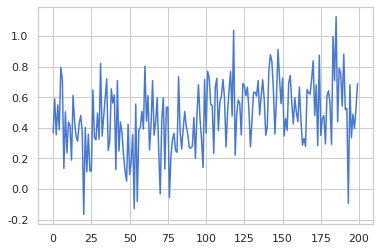

In [376]:
def foo(x):
    y = 0.4 + 0.2*x
    return np.random.normal(y, 0.2,len(y))

plt.plot(foo(np.concatenate((np.zeros(100),np.ones(100)))))

In [365]:
tc.correct.loc[:144]

0      0.0
1      0.0
2      1.0
3      1.0
4      1.0
      ... 
140    1.0
141    1.0
142    1.0
143    1.0
144    0.0
Name: correct, Length: 145, dtype: float64

In [366]:
zd.trial_info_table.correct[zd.ze.xval_trial_table[1]=='test'].mean()

0.8620689655172413

<AxesSubplot:xlabel='zones', ylabel='bac'>

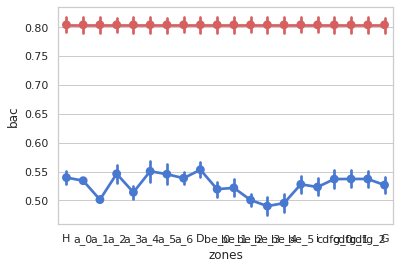

In [291]:
sns.pointplot(x='zones', y='bac', data=t2)
sns.pointplot(x='zones', y='bac', data=t3, color='r')


In [276]:
t0['ldn']=1 - t0.logit_dist/(tmf.logit(t0.pr_pred)-tmf.logit(1/39))
t1['ldn']=1 - t0.logit_dist/(tmf.logit(t1.pr_pred)-tmf.logit(1/39))

In [267]:
t0['bacn'] = t0['bac']/(1/39)
t1['bacn'] = t1['bac']/(1/39)

<AxesSubplot:xlabel='zones', ylabel='bac'>

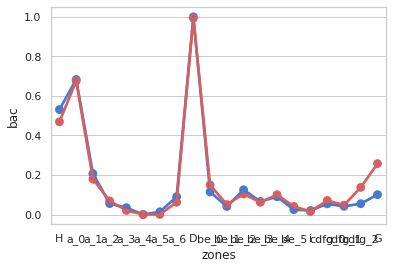

In [263]:
sns.pointplot(x='zones', y='bac', data=t0)
sns.pointplot(x='zones', y='bac', data=t1, color='r')

<AxesSubplot:xlabel='zones', ylabel='logit_dist'>

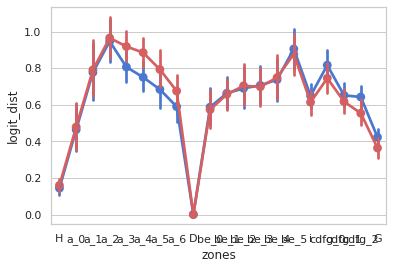

In [265]:
sns.pointplot(x='zones', y='logit_dist', data=t0)
sns.pointplot(x='zones', y='logit_dist', data=t1, color='r')

<AxesSubplot:xlabel='zones', ylabel='dist'>

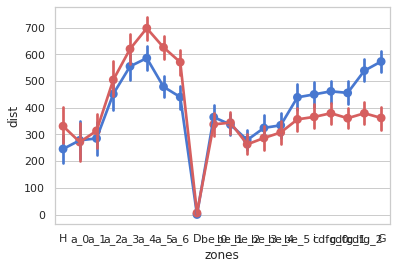

In [266]:
sns.pointplot(x='zones', y='dist', data=t0)
sns.pointplot(x='zones', y='dist', data=t1, color='r')

<AxesSubplot:xlabel='zones', ylabel='ldn'>

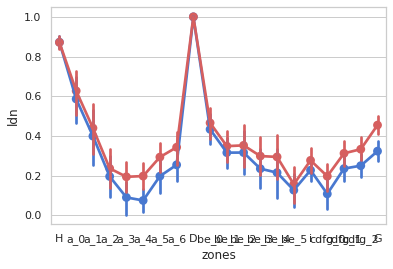

In [277]:
sns.pointplot(x='zones', y='ldn', data=t0)
sns.pointplot(x='zones', y='ldn', data=t1, color='r')

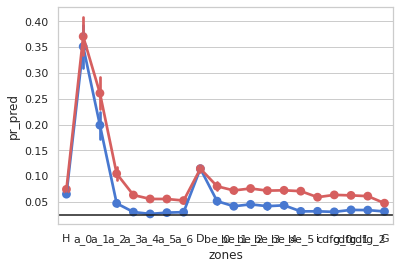

In [281]:
sns.pointplot(x='zones', y='pr_target', data=t0)
sns.pointplot(x='zones', y='pr_pred', data=t0, color='r')
plt.axhline(1/39, color='k')

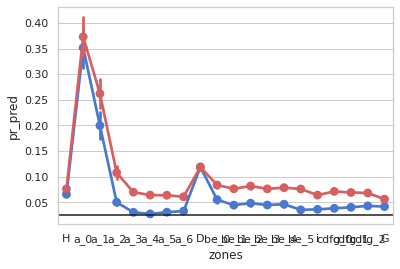

In [282]:
sns.pointplot(x='zones', y='pr_target', data=t1)
sns.pointplot(x='zones', y='pr_pred', data=t1, color='r')
plt.axhline(1/39, color='k')

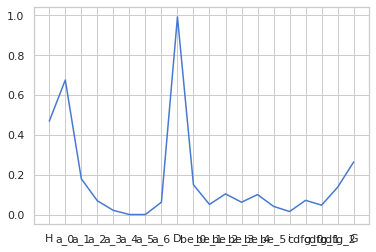

In [256]:
plt.plot(zd.trial_zone_perf_table.groupby('zones').mean().bac)

In [251]:
zd.trial_zone_perf_table.groupby('fold').mean()

,trial,H,a_0,a_1,a_2,a_3,a_4,a_5,a_6,D,...,g_0,g_1,g_2,G4,dist,acc,pr_target,pr_pred,logit_dist,bac
fold,,,,,,,,,,,,,,,,,,,,,
0,80.767692,0.027347,0.044276,0.035096,0.027811,0.023942,0.022671,0.021698,0.021979,0.022207,...,0.025743,0.024956,0.025641,0.024894,390.820868,0.178462,0.068484,0.097645,0.600087,0.179008
1,66.325000,0.028010,0.040048,0.035346,0.026244,0.023285,0.022965,0.022253,0.021088,0.023400,...,0.024009,0.023399,0.024496,0.024110,384.356065,0.182812,0.062439,0.092704,0.656501,0.171594
2,72.241214,0.029151,0.049641,0.042138,0.027294,0.022059,0.022273,0.023336,0.022684,0.022655,...,0.027835,0.023256,0.025213,0.025054,373.321251,0.185304,0.070718,0.098621,0.574519,0.180698
3,67.329564,0.025688,0.039236,0.034941,0.025732,0.024522,0.023205,0.021687,0.021312,0.022665,...,0.023748,0.024772,0.023357,0.023485,406.605173,0.156704,0.062005,0.095718,0.728866,0.149092
4,72.884311,0.028115,0.047785,0.041950,0.027640,0.023236,0.022485,0.022264,0.022051,0.024601,...,0.022968,0.022714,0.023363,0.022674,361.130411,0.191759,0.070203,0.100676,0.608145,0.180774


In [244]:
t2 = zd.get_trial_zone_evidence_table()

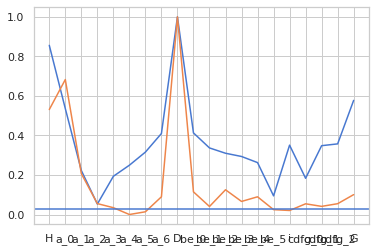

In [183]:
tt = t.groupby('zones').mean()
plt.plot(1-tt.logit_dist)
plt.plot(tt.bac)
plt.axhline(1/39)

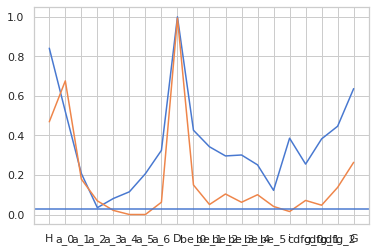

In [245]:
tt = t2.groupby('zones').mean()
plt.plot(1-tt.logit_dist)
plt.plot(tt.bac)
plt.axhline(1/39)

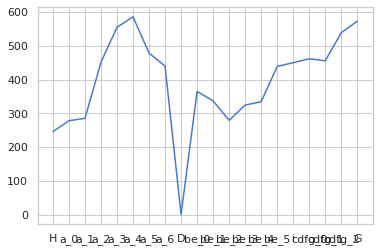

In [170]:
plt.plot(tt.dist)

<AxesSubplot:>

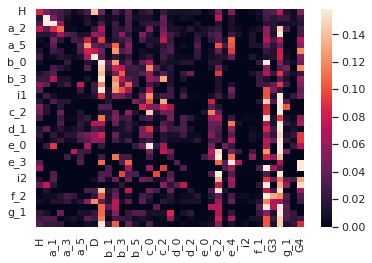

In [174]:
sns.heatmap(zd.get_confusion_mat(), robust=True)

In [3]:
t = info.get_zone_encoder()

In [7]:
t[(t.max_lag==50) & (t.cue_type=='fixed')].head(20)

,session_unit_id,unit_type,max_lag,cue_type,rw_type,sp_type,trial_seg,score,subject,session,session_pct_cov,tt,tt_cl,cl_name,task,unit_id
8,0,mua,50,fixed,none,none,out,0.084880,Li,Li_T3g_052818,NaN,2,11,Li_T3g_052818-tt2_d16.5_cl11,T3g,0
23,1,mua,50,fixed,none,none,out,0.021499,Li,Li_T3g_052818,NaN,2,14,Li_T3g_052818-tt2_d16.5_cl14,T3g,1
38,0,cell,50,fixed,none,none,out,0.116149,Li,Li_T3g_052918,NaN,2,18,Li_T3g_052918-tt2_d16.5_cl18,T3g,2
53,1,cell,50,fixed,none,none,out,0.397331,Li,Li_T3g_052918,NaN,8,0,Li_T3g_052918-tt8_d16.25_cl0,T3g,3
68,2,cell,50,fixed,none,none,out,0.052531,Li,Li_T3g_052918,NaN,8,12,Li_T3g_052918-tt8_d16.25_cl12,T3g,4
83,3,cell,50,fixed,none,none,out,0.169876,Li,Li_T3g_052918,NaN,8,16,Li_T3g_052918-tt8_d16.25_cl16,T3g,5
98,4,cell,50,fixed,none,none,out,0.102265,Li,Li_T3g_052918,NaN,8,17,Li_T3g_052918-tt8_d16.25_cl17,T3g,6
113,5,cell,50,fixed,none,none,out,0.305968,Li,Li_T3g_052918,NaN,14,0,Li_T3g_052918-tt14_d16.75_cl0,T3g,7
128,6,mua,50,fixed,none,none,out,0.074984,Li,Li_T3g_052918,NaN,3,10,Li_T3g_052918-tt3_d16.75_cl10,T3g,8
143,7,mua,50,fixed,none,none,out,0.026828,Li,Li_T3g_052918,NaN,7,8,Li_T3g_052918-tt7_d17.25_cl8,T3g,9


In [11]:
tt = si.get_zone_encoder()
tt

,unit,split,fold,metric,score,max_lag,decay_func,cue_type,rw_type,sp_type,dir_type,trial_seg,unit_type
0,0,train,0,r2,0.335013,-50,inverse,none,none,none,none,out,cell
1,1,train,0,r2,0.010346,-50,inverse,none,none,none,none,out,cell
2,2,train,0,r2,0.061768,-50,inverse,none,none,none,none,out,cell
3,3,train,0,r2,0.032285,-50,inverse,none,none,none,none,out,cell
4,4,train,0,r2,0.102819,-50,inverse,none,none,none,none,out,cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3415,4,test,9,r2,0.116774,50,inverse,none,none,none,inter,all,cell
3416,5,test,9,r2,0.013505,50,inverse,none,none,none,inter,all,mua
3417,6,test,9,r2,-0.033961,50,inverse,none,none,none,inter,all,mua
3418,7,test,9,r2,0.081160,50,inverse,none,none,none,inter,all,mua


In [145]:
%%time
tmf = reload(tmf)
ze = tmf.ZoneEncoder(si, feature_params=dict(max_lag=50, cue_type='fixed'), norm_response='z', n_folds=5)
ze.get_model_fits()
X1 = pd.DataFrame(data=ze.get_avg_coefs(), columns = ze.feature_names)

CPU times: user 28.4 s, sys: 440 ms, total: 28.9 s
Wall time: 5.64 s


In [146]:
X1[['RC','LC']]

,RC,LC
0,-0.024687,-0.046737
1,0.130535,0.094091
2,-0.269871,-0.270331
3,-0.268429,-0.335123
4,-0.324786,-0.325503
5,0.038123,0.001796
6,-0.103492,-0.207138
7,-0.125613,-0.144618
8,-0.094829,0.008634


In [149]:
%%time
ze.update_features(**dict(max_lag=50, rw_type='fixed', trial_seg='in'))
ze.get_model_fits()
Y = pd.DataFrame(data=ze.get_avg_coefs(), columns = ze.feature_names)

CPU times: user 7.97 s, sys: 92 ms, total: 8.06 s
Wall time: 1.61 s


In [150]:
Y[['RW', 'NR']]

,RW,NR
0,0.026293,0.104244
1,0.215281,0.355837
2,-0.229274,-0.158793
3,-0.008792,0.104554
4,-0.098051,0.013815
5,0.076238,0.324019
6,0.214658,0.313800
7,-0.216766,-0.141262
8,0.050176,-0.111515


In [151]:
Z=pd.DataFrame(0.0,index=range(ze.n_units), columns=['cue', 'rw'])
Z['cue'] = X['RC'] - X['LC']
Z['rw'] = Y['RW'] - Y['NR']
Z

,cue,rw
0,0.299403,-0.077951
1,1.009976,-0.140556
2,-0.072839,-0.070481
3,1.709328,-0.113346
4,0.489399,-0.111867
5,0.585503,-0.247781
6,3.298760,-0.099141
7,0.167836,-0.075504
8,-1.779610,0.161691


In [14]:
c =ze.get_avg_coefs()

In [26]:
X[['LC','RC']]

,variable,value
0,LC,8.011886
1,LC,28.122105
2,LC,9.602823
3,LC,38.891687
4,LC,36.965470
5,LC,11.207839
6,LC,38.517741
7,LC,12.562931
8,LC,21.944826
9,RC,8.818666


In [3]:
# cue selected units based on rate and remapping profile for variety of responses
selected_units = [500, 499, 2804, 1038] ## uuids

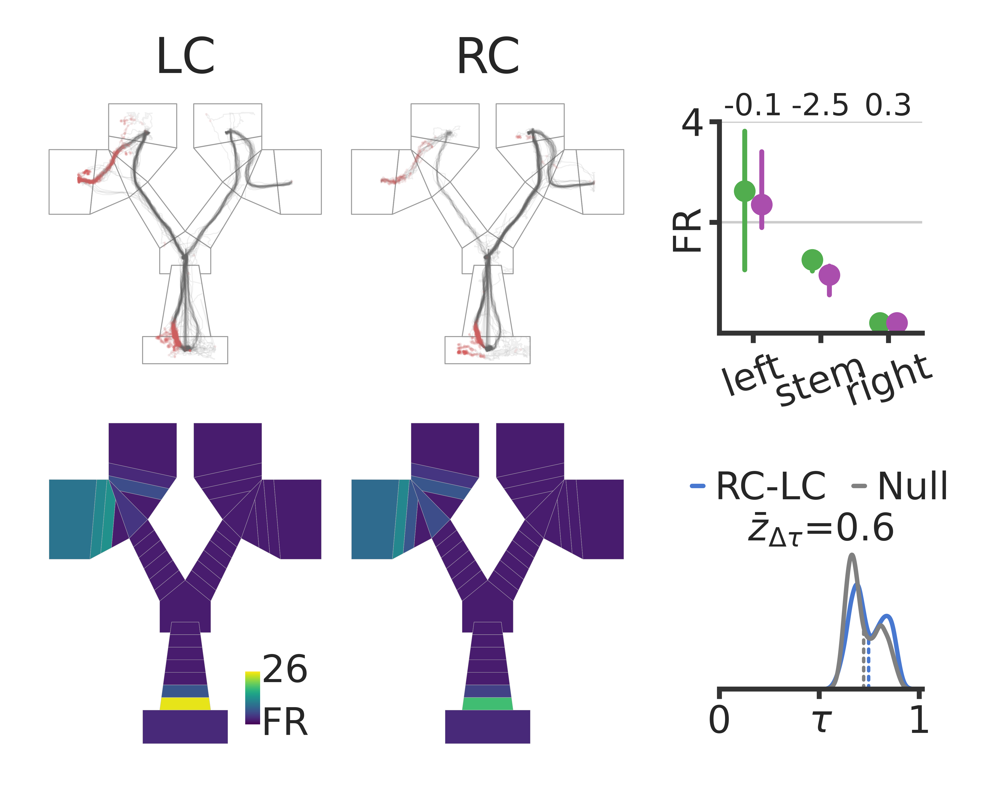

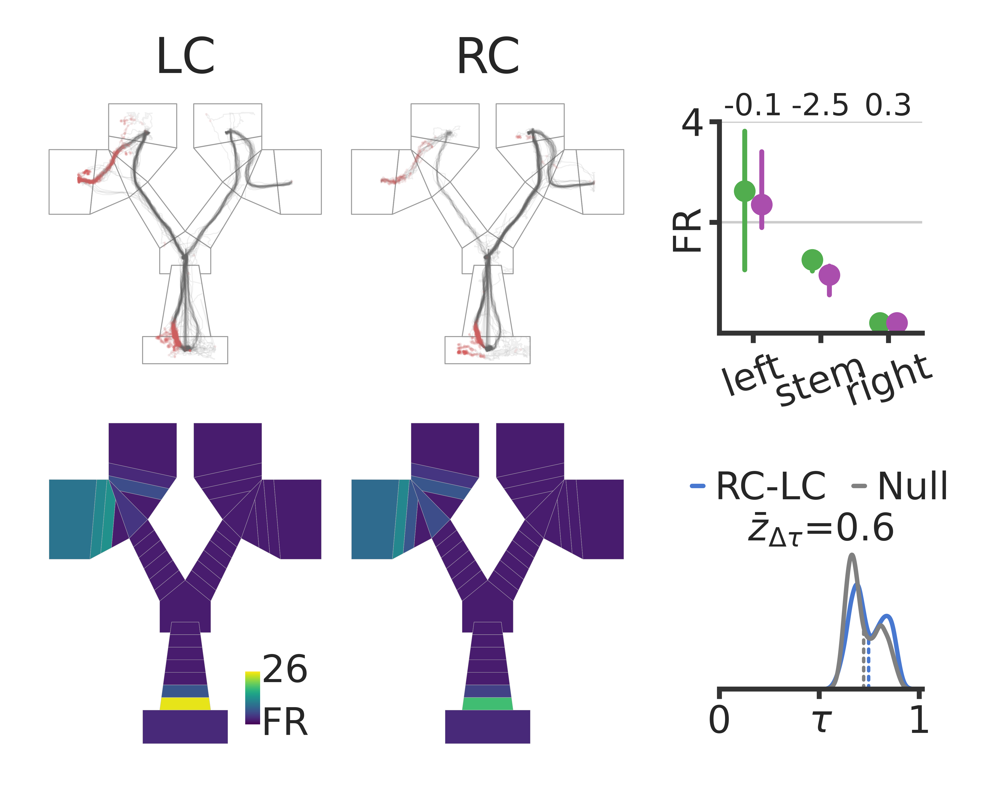

In [5]:
pf = reload(pf)
ff = pf.ZoneRatesFigures()

ff.plot_unit_rate_and_remap(500, comp ='cue',save_flag=True, save_format='svg')


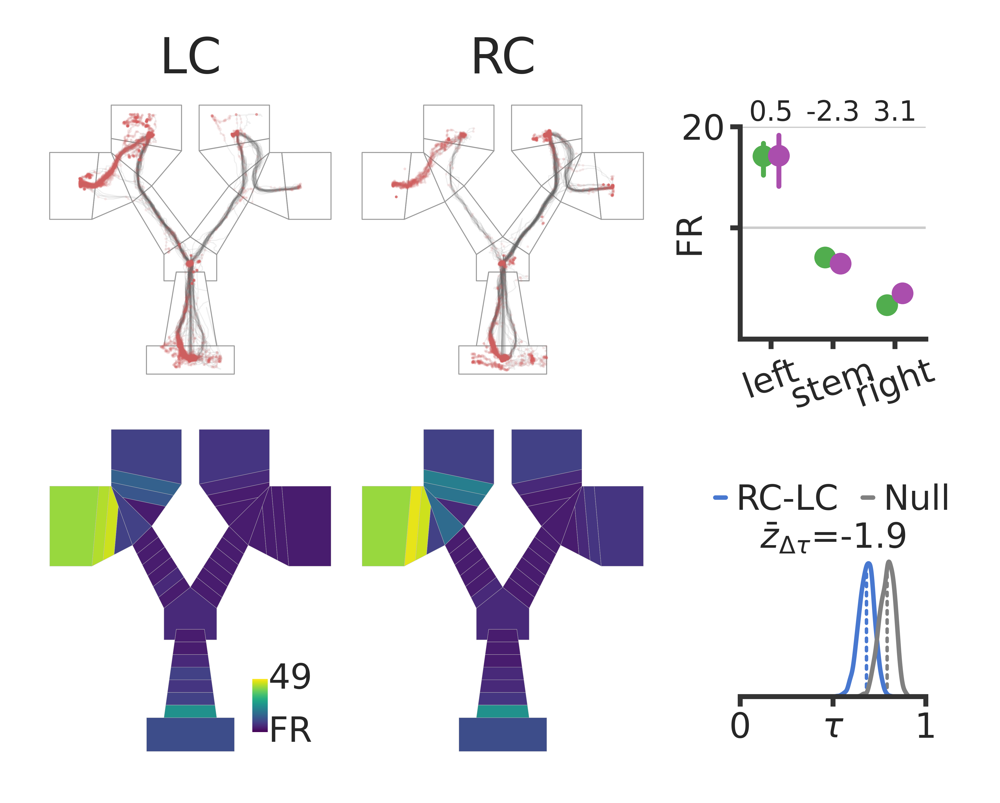

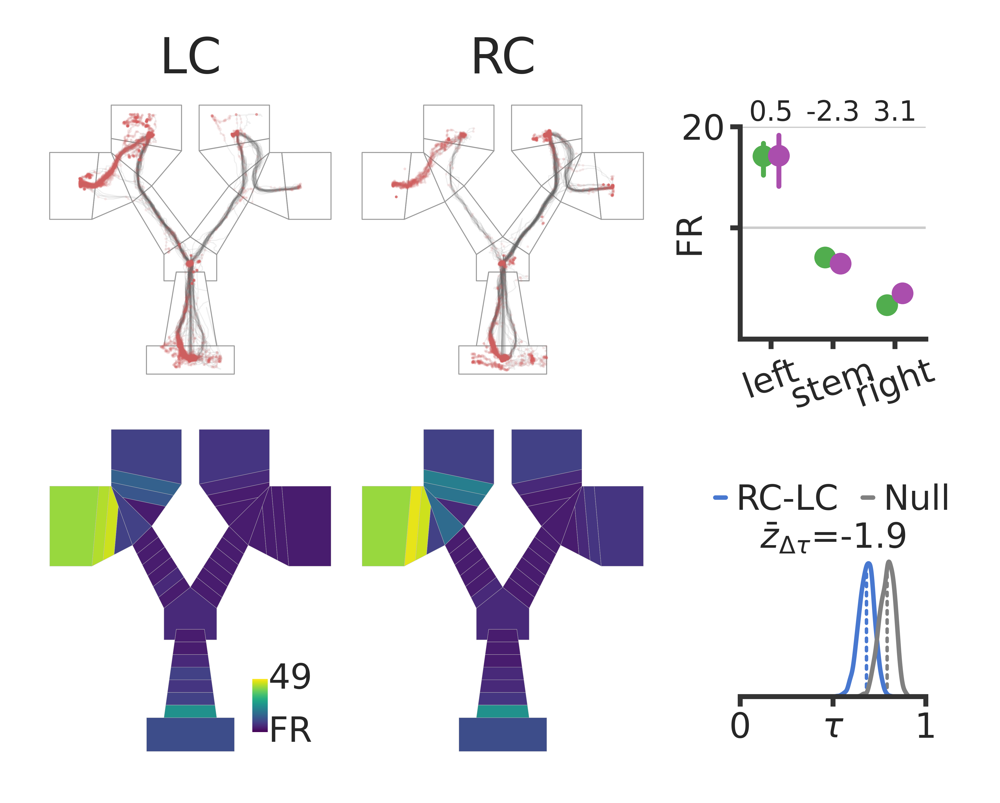

In [5]:
pf = reload(pf)
pf.plot_unit_comp_summary(500, 'cue')


In [ ]:
uuid = 499
comp ='cue'

unit_info = info.tdf.loc[uuid]
session, suid = unit_info[['session', 'suid']]
si = info.get_session(session)
ta = si.get_trial_analyses()

In [15]:
mzr_boot_by_cond, taus = tmf.get_unit_zr_boot_comp_dists(ta, suid, comp, n_boot=50)

In [24]:
si = info.get_session(session)
ta = si.get_trial_analyses()

In [5]:
t = info.get_zone_rates_remap()

In [10]:
t.loc[t.cl_name=='Li_T3g_052818-tt2_d16.5_cl11', 'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zt'].iloc[0]

-4.473117470748926

In [4]:
2%2

0

In [105]:

for cond in conds:
    mzr_boot_by_cond[cond] = pd.DataFrame(index=range(n_boot),  columns=ta.tmz.all_segs_names)
    for boot in range(n_boot):
        trials = cond_boot_trials[cond][:,boot]
        mzr_boot_by_cond[cond].loc[boot] = ta.get_unit_trial_zone_rates(unit=suid, trials=trials, trial_seg='out').mean()
    mzr_boot_by_cond[cond] = mzr_boot_by_cond[cond].astype(float)     

taus = np.zeros(n_boot)
for boot in range(n_boot):
    taus[boot] = rs.kendall(mzr_boot_by_cond['CR'].loc[boot],mzr_boot_by_cond['CL'].loc[boot])

In [115]:
rs.kendall(mzr_boot_by_cond['CR'].loc[boot], mzr_boot_by_cond['CL'].loc[boot])

0.7749339939334754

<AxesSubplot:ylabel='Count'>

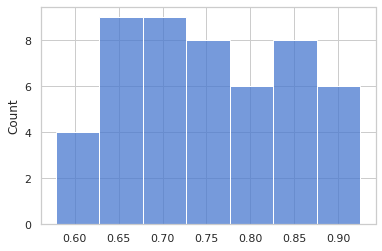

In [118]:
sns.histplot(taus)

In [26]:

ta.get_condition_trials('CL')

array([  1,   2,   5,   8,  10,  13,  15,  17,  19,  28,  33,  34,  35,
        36,  41,  45,  49,  51,  52,  56,  57,  58,  59,  60,  62,  65,
        69,  72,  75,  76,  79,  81,  82,  83,  84,  85,  86,  88,  91,
        92,  93,  94,  97,  99, 100, 101, 102, 105, 106, 107, 108, 111,
       114, 119, 124, 125, 126, 128, 129, 130, 132, 135, 137, 141, 142,
       143, 145, 146, 147, 148, 150, 152, 154, 155, 157, 158, 159, 162,
       163, 165, 166, 168, 170, 171, 173, 177, 178, 179, 180, 182, 184,
       185, 186, 188, 189, 193, 194])

In [59]:
seg_units = info.get_segment_selective_units()
seg_units

,rank,uuid,cl_name,ts,ms,val
0,1,1789,NE_T3g_061518-tt2_d13.5_cl4,out,left,-15.300865
1,2,1752,NE_T3g_061418-tt2_d13.5_cl4,out,left,-14.886025
2,3,3891,Cl_T3g_020719-tt4_d16.25_cl2,out,left,-13.955832
3,4,3804,Cl_T3g_013019-tt10_d15.25_cl17,out,left,-13.213436
4,5,3433,Cl_T3g_010619-tt4_d14.25_cl0,out,left,-12.115103
5,6,2908,Cl_T3g_120718-tt12_d12.75_cl15,out,left,-11.918851
6,7,2812,Cl_T3g_120518-tt12_d12.75_cl21,out,left,-11.714792
7,8,804,Li_T3g_062718-tt8_d17.0_cl17,out,left,-11.601678
8,1,3786,Cl_T3g_012919-tt10_d15.25_cl8,out,stem,-17.79718
9,2,1654,NE_T3g_061218-tt7_d12.0_cl14,out,stem,-17.526722


In [6]:
zrc = info.get_zone_rates_remap()
cue_units = info.get_comp_selective_units(comp='cue', n_units=20)
seg_units = info.get_segment_selective_units(n_units=20)
tdf = info.get_data_template_df()

In [7]:
ix = np.intersect1d(cue_units.uuid, seg_units[seg_units.ts=='out'].uuid)
ix

array([17, 499, 500, 676, 801, 1654, 1789, 1819, 2003, 3473, 3711, 3786,
       3804, 3891], dtype=object)

In [9]:
cue_units[cue_units.uuid.isin(ix)]

,ms,cue,rank,cl_name,uz_val,uuid
12,left,CL,13,Li_T3g_062018-tt14_d17.25_cl14,-2.623376,676
29,left,CR,10,Cl_T3g_013019-tt10_d15.25_cl17,3.452175,3804
34,left,CR,15,Cl_T3g_010819-tt4_d14.75_cl0,3.211572,3473
37,left,CR,18,Cl_T3g_020719-tt4_d16.25_cl2,3.0506,3891
55,stem,CL,16,Li_T3g_061418-tt8_d16.5_cl5,-2.519068,500
62,stem,CR,3,Li_T3g_052918-tt8_d16.25_cl0,5.196802,17
66,stem,CR,7,Cl_T3g_012419-tt10_d15.0_cl9,4.057341,3711
74,stem,CR,15,NE_T3g_061218-tt7_d12.0_cl14,3.31671,1654
76,stem,CR,17,NE_T3g_061518-tt2_d13.5_cl4,3.148664,1789
105,right,CR,6,Li_T3g_061418-tt8_d16.5_cl2,3.081565,499


In [14]:
cue_rs = 'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm'
cl_names = tdf.loc[ix].cl_name
zrc.loc[zrc.cl_name.isin(cl_names), cue_rs]

3      -0.572054
172    -1.850277
173     0.641996
246          NaN
329    -3.241607
752    -2.631600
806    -1.388859
814    -0.652439
924    -0.215868
1485   -2.753823
1581   -0.776208
1630   -3.715255
1648   -1.356389
1687   -4.817860
Name: CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm, dtype: float64

In [19]:
cl_names = zrc.sort_values(cue_rs)['cl_name'][:10]

tdf.loc[tdf.cl_name.isin(cl_names)].index

Int64Index([1038, 1468, 1476, 3447, 3487, 3713, 3785, 3890, 3891, 3894], dtype='int64', name='uuid')

In [21]:
zrc = info.get_zone_rates_remap()
cue_units = info.get_comp_selective_units(comp='rw', n_units=20)
seg_units = info.get_segment_selective_units(n_units=20)
tdf = info.get_data_template_df()

ix = np.intersect1d(cue_units.uuid, seg_units[seg_units.ts=='out'].uuid)
ix

array([135, 223, 225, 227, 499, 500, 748, 804, 931, 1179, 1192, 1653,
       1654, 1752, 1753, 1789, 1819, 2002, 2907, 3476, 3711, 3787, 3890,
       3891], dtype=object)

In [23]:
cue_rs = 'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zm'
cl_names = zrc.sort_values(cue_rs)['cl_name'][:10]

tdf.loc[tdf.cl_name.isin(cl_names)].index

Int64Index([148, 402, 403, 987, 1828, 2029, 2031, 2033, 3788, 3891], dtype='int64', name='uuid')

In [7]:
seg_units[seg_units.uuid.isin(ix)]

,rank,uuid,cl_name,ts,ms,val
0,1,1789,NE_T3g_061518-tt2_d13.5_cl4,out,left,-15.300865
2,3,3891,Cl_T3g_020719-tt4_d16.25_cl2,out,left,-13.955832
3,4,3804,Cl_T3g_013019-tt10_d15.25_cl17,out,left,-13.213436
11,12,3473,Cl_T3g_010819-tt4_d14.75_cl0,out,left,-11.231152
20,1,3786,Cl_T3g_012919-tt10_d15.25_cl8,out,stem,-17.79718
21,2,1654,NE_T3g_061218-tt7_d12.0_cl14,out,stem,-17.526722
27,8,676,Li_T3g_062018-tt14_d17.25_cl14,out,stem,-14.859111
28,9,17,Li_T3g_052918-tt8_d16.25_cl0,out,stem,-14.638081
31,12,801,Li_T3g_062718-tt8_d17.0_cl1,out,stem,-14.104831
40,1,2003,NE_T3i_071018-tt11_d14.5_cl14,out,right,-13.212661


In [11]:
cue_rs = 'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm'
t = zrc.loc[zrc.unit_type=='cell'].sort_values(cue_rs).dropna()

In [15]:
t[[cue_rs, 'session', 'cl_name']]

,CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm,session,cl_name
1629,-4.841955,Cl_T3g_012919,Cl_T3g_012919-tt4_d15.75_cl12
1687,-4.817860,Cl_T3g_020719,Cl_T3g_020719-tt4_d16.25_cl2
1583,-4.773607,Cl_T3g_012419,Cl_T3g_012419-tt10_d15.0_cl21
1686,-4.708167,Cl_T3g_020719,Cl_T3g_020719-tt4_d16.25_cl0
436,-4.094967,Li_T3g_070618,Li_T3g_070618-tt8_d17.5_cl12
...,...,...,...
993,1.311486,Cl_T3g_112318,Cl_T3g_112318-tt10_d12.25_cl18
1752,1.588863,Cl_T3i_021519,Cl_T3i_021519-tt4_d16.75_cl4
614,1.624314,NE_T3g_052818,NE_T3g_052818-tt7_d11.75_cl15
612,1.690806,NE_T3g_052818,NE_T3g_052818-tt2_d13.0_cl10


In [16]:
tdf[tdf.cl_name=='Li_T3g_070618-tt8_d17.5_cl12']

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
1038,Li,Li_T3g_070618,T3g,70618,1,cell,8,12,17.5,Li_T3g_070618-tt8_d17.5_cl12


In [29]:
t[cue_rs]
info.get_info_from_cl_name(t.loc[1629, 'cl_name'])

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
3785,Cl,Cl_T3g_012919,T3g,12919,0,cell,4,12,15.75,Cl_T3g_012919-tt4_d15.75_cl12


In [36]:
tdf

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
0,Li,Li_T3g_052818,T3g,52818,0,mua,2,11,16.50,Li_T3g_052818-tt2_d16.5_cl11
1,Li,Li_T3g_052818,T3g,52818,1,mua,2,14,16.50,Li_T3g_052818-tt2_d16.5_cl14
2,Li,Li_OF_052818,OF,52818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8
3,Li,Li_OF_052818,OF,52818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4
4,Li,Li_OF_052818,OF,52818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18
...,...,...,...,...,...,...,...,...,...,...
4381,Ca,Ca_T3g_041119,T3g,41119,0,mua,11,13,18.50,Ca_T3g_041119-tt11_d18.5_cl13
4382,Ca,Ca_T3g_041619,T3g,41619,0,mua,11,4,18.75,Ca_T3g_041619-tt11_d18.75_cl4
4383,Ca,Ca_T3g_041919,T3g,41919,0,mua,11,13,19.25,Ca_T3g_041919-tt11_d19.25_cl13


In [3]:
metric_scores, ms = info.get_of_results()
unit_table = info.get_unit_table()

In [108]:
models = ['speed', 'hd', 'pos']
unit_type = 'cell'
metric='agg_sdp_coef'
model = 'agg_sdp'
split = 'train'
subjects = info.subjects

table = ms[ (ms.metric==metric) & (ms.unit_type==unit_type) & (ms.subject.isin(subjects)) & (ms.split=='train')]
table2 = ms[ (ms.model==model) & (ms.unit_type==unit_type) & (ms.subject.isin(subjects)) & (ms.split=='test') & (ms.metric=='r2')]



In [49]:
table2

,unit_id,subject,session,session_unit_id,unit_type,session_pct_cov,session_valid,tt,tt_cl,model,split,metric,value,cl_name
1015,0,Li,Li_OF_052818,0,cell,0.96,True,7,8,agg_sdp,train,r2,0.133574,Li_OF_052818-tt7_d17.25_cl8
1023,1,Li,Li_OF_052818,1,cell,0.96,True,8,4,agg_sdp,train,r2,0.063751,Li_OF_052818-tt8_d16.25_cl4
1031,2,Li,Li_OF_052818,2,cell,0.96,True,8,18,agg_sdp,train,r2,0.140516,Li_OF_052818-tt8_d16.25_cl18
3327,14,Li,Li_OF_052918,0,cell,0.97,True,3,5,agg_sdp,train,r2,0.038587,Li_OF_052918-tt3_d16.75_cl5
3335,15,Li,Li_OF_052918,1,cell,0.97,True,3,17,agg_sdp,train,r2,0.053754,Li_OF_052918-tt3_d16.75_cl17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189607,2149,Ca,Ca_OF_030619,0,cell,0.71,False,11,10,agg_sdp,train,r2,0.081503,Ca_OF_030619-tt11_d15.5_cl10
189615,2150,Ca,Ca_OF_030619,1,cell,0.71,False,11,13,agg_sdp,train,r2,0.047323,Ca_OF_030619-tt11_d15.5_cl13
189623,2151,Ca,Ca_OF_030619,2,cell,0.71,False,11,15,agg_sdp,train,r2,0.079871,Ca_OF_030619-tt11_d15.5_cl15
190783,2164,Ca,Ca_OF_031219,0,cell,0.93,True,11,4,agg_sdp,train,r2,0.037308,Ca_OF_031219-tt11_d16.25_cl4


In [5]:
def foo(uid):
    return table2.loc[table2.unit_id==uid, 'value'].values[0]
subject_colors = {}
for ii, s in enumerate(info.subjects):
    subject_colors[s] = sns.palettes.color_palette('deep')[ii]

In [6]:
table.columns

Index(['unit_id', 'subject', 'session', 'session_unit_id', 'unit_type',
       'session_pct_cov', 'session_valid', 'tt', 'tt_cl', 'model', 'split',
       'metric', 'value', 'cl_name'],
      dtype='object')

In [109]:
mm = table.pivot(index=['unit_id', 'subject'], columns=['model'], values='value')
mm = mm.reset_index()
mm['r2'] = mm.unit_id.map(foo)
mm['color'] = mm.subject.map(subject_colors)
mm

model,unit_id,subject,hd,pos,speed,r2,color
0,0,Li,-0.476825,1.223207,0.222397,0.029963,"(0.2980392156862745, 0.4470588235294118, 0.690..."
1,1,Li,0.512117,1.219179,-0.709691,0.005527,"(0.2980392156862745, 0.4470588235294118, 0.690..."
2,2,Li,-0.031437,1.174097,-0.149871,0.032967,"(0.2980392156862745, 0.4470588235294118, 0.690..."
3,14,Li,0.737932,0.603281,-0.251686,0.020815,"(0.2980392156862745, 0.4470588235294118, 0.690..."
4,15,Li,0.561194,0.589362,-0.098255,0.031516,"(0.2980392156862745, 0.4470588235294118, 0.690..."
...,...,...,...,...,...,...,...
668,2149,Ca,-0.120512,0.961694,0.204592,0.042643,"(0.5058823529411764, 0.4470588235294118, 0.701..."
669,2150,Ca,0.059701,1.061168,-0.096583,-0.007577,"(0.5058823529411764, 0.4470588235294118, 0.701..."
670,2151,Ca,0.252843,1.142405,-0.382756,0.019889,"(0.5058823529411764, 0.4470588235294118, 0.701..."
671,2164,Ca,0.214869,0.990801,-0.183313,0.003676,"(0.5058823529411764, 0.4470588235294118, 0.701..."


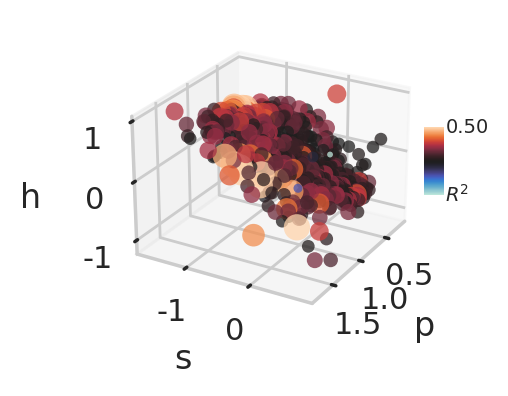

In [117]:
fig = plt.figure(figsize=(2,2.25), dpi=200)
ax = fig.add_subplot(projection='3d')

c = np.log2((1+mm.r2))
c[c>0.5]=0.5
c[c<-0.5] = -0.5

cmap = 'icefire'
#ax.scatter(mm.hd, mm.speed, mm.pos, s=20**(1+mm.r2), color = mm.subject.map(subject_colors), ec='None', alpha=0.6)
ax.scatter(mm.pos, mm.speed, mm.hd, c = c, s=20**(1+c), ec='None', alpha=0.75, cmap=cmap)

ax.set_xlabel('p',labelpad=0)
ax.set_ylabel('s',labelpad=0)
ax.set_zlabel('h', labelpad=0)
ax.view_init(25, 30)


cm_params = dict(color_map=cmap,
                 n_color_bins=25, nans_2_zeros=True, div=False,
                 max_value=0.5, min_value=-0.5, tick_fontsize=7, label_fontsize=7, skip_labels=True)

data_colors, color_array = pf.get_colors_from_data(c, **cm_params)
ax_p = ax.get_position()

w, h = ax_p.width, ax_p.height
x0, y0 = ax_p.x0, ax_p.y0
cax_p = [0.9, y0 + 0.3, 0.05, 0.15]
cax = fig.add_axes(cax_p)
#cax.set_in_layout(False)

pf.get_color_bar_axis(cax, color_array, **cm_params)

cax.text(1.05, 1, f"{color_array[-1]:0.2f}", fontsize=cm_params['tick_fontsize'], ha='left', va='center',
                 transform=cax.transAxes)
cax.text(1.05, 0, f'$R^2$', fontsize=cm_params['label_fontsize'], ha='left', va='center',
                     transform=cax.transAxes)
ax.tick_params(**dict(pad=0))

<AxesSubplot:xlabel='r2', ylabel='Count'>

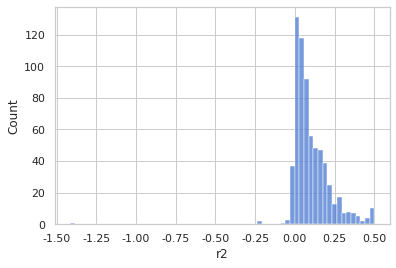

In [112]:
sns.histplot(c)

In [73]:
pf.add_colorbar(f, [])

Signature:
pf.add_colorbar(
    fig,
    pos_in_fig,
    cmap,
    ticks=None,
    ticklabels=None,
    ticklabel_fontsize=7,
    label=None,
    label_fontsize=8,
    aspect=3,
)
Docstring: <no docstring>
File:      ~/Documents/TreeMazeAnalyses2/Analyses/plot_functions.py
Type:      function


<AxesSubplot:xlabel='r2', ylabel='Density'>

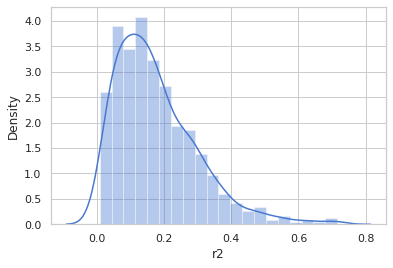

In [72]:
sns.distplot(np.log2(1+mm.r2))

In [29]:
import TreeMazeAnalyses2.Analyses.cross_task_functions as ctf

X = ctf.umap_cell_clusters(mm[models], n_umap_clusters=3)

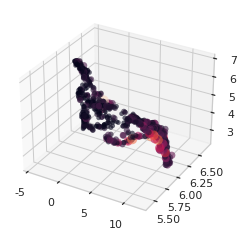

In [33]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(X[:,0], X[:,1], X[:,2], s=20**(1+mm.r2), c = 20**(1+mm.r2), ec='None', alpha=0.6)

In [64]:
ax.view_init?

Signature: ax.view_init(elev=None, azim=None)
Docstring:
Set the elevation and azimuth of the axes in degrees (not radians).

This can be used to rotate the axes programmatically.

'elev' stores the elevation angle in the z plane (in degrees).
'azim' stores the azimuth angle in the (x, y) plane (in degrees).

if 'elev' or 'azim' are None (default), then the initial value
is used which was specified in the :class:`Axes3D` constructor.
File:      ~/anaconda3/envs/tm_analyses/lib/python3.9/site-packages/mpl_toolkits/mplot3d/axes3d.py
Type:      method


In [11]:
df = info.get_comp_selective_units('dir')
template_df = info.get_data_template_df()


In [35]:
zone_rates

,uuid,ms,dir,cond,H,a_0,a_1,a_2,a_3,a_4,...,e_5,i2,f_0,f_1,f_2,G3,g_0,g_1,g_2,G4
0,3787,left,in,out,2.159694,0.0,0.0,0.026082,0.062914,0.052817,...,0.10969,0.013755,0.06048,0.04449,0.004921,0.106342,0.0,0.0,0.0,0.0
1,3787,left,in,in,0.13492,0.266874,0.222027,0.402304,0.477283,0.851193,...,7.463192,1.987656,0.976321,0.489439,0.041354,0.069096,2.748585,2.090498,0.398348,0.031189
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [31]:
ta.get_avg_trial_zone_rates(trials=trials, trial_seg=ts).loc[suid].values

array([1.34920402e-01, 2.66874149e-01, 2.22026623e-01, 4.02303938e-01,
       4.77283146e-01, 8.51193250e-01, 1.86631459e+00, 2.44170879e+00,
       8.53851789e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 2.71957109e-01,
       4.03225806e-01, 1.49572650e-01, 3.40321602e-01, 1.67755446e-01,
       6.09756098e-01, 3.72754761e-01, 8.10185185e-02, 8.65351333e-03,
       2.22122599e+01, 1.65519511e+01, 1.43088906e+01, 1.44206039e+01,
       1.47903944e+01, 7.46319239e+00, 1.98765563e+00, 9.76320625e-01,
       4.89439107e-01, 4.13535766e-02, 6.90962052e-02, 2.74858459e+00,
       2.09049751e+00, 3.98347681e-01, 3.11886202e-02])

In [29]:
suid, ii, uuid, cnt, 

(2, 0, 3787, 2)

In [22]:
zone_rates.loc[cnt, tmz.all_segs_names]  = ta.get_avg_trial_zone_rates(trials=trials, trial_seg=ts).loc[suid].values

In [25]:
zone_rates.loc[cnt, tmz.all_segs_names] 

H      NaN
a_0    NaN
a_1    NaN
a_2    NaN
a_3    NaN
a_4    NaN
a_5    NaN
a_6    NaN
D      NaN
b_0    NaN
b_1    NaN
b_2    NaN
b_3    NaN
b_4    NaN
b_5    NaN
i1     NaN
c_0    NaN
c_1    NaN
c_2    NaN
G1     NaN
d_0    NaN
d_1    NaN
d_2    NaN
G2     NaN
e_0    NaN
e_1    NaN
e_2    NaN
e_3    NaN
e_4    NaN
e_5    NaN
i2     NaN
f_0    NaN
f_1    NaN
f_2    NaN
G3     NaN
g_0    NaN
g_1    NaN
g_2    NaN
G4     NaN
Name: 2, dtype: object

In [14]:
trials = ta.get_condition_trials(condition='All')

In [16]:
z = ta.get_avg_trial_zone_rates(trials=trials, trial_seg='in').loc[suid].values

In [17]:
z

array([1.34920402e-01, 2.66874149e-01, 2.22026623e-01, 4.02303938e-01,
       4.77283146e-01, 8.51193250e-01, 1.86631459e+00, 2.44170879e+00,
       8.53851789e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 2.71957109e-01,
       4.03225806e-01, 1.49572650e-01, 3.40321602e-01, 1.67755446e-01,
       6.09756098e-01, 3.72754761e-01, 8.10185185e-02, 8.65351333e-03,
       2.22122599e+01, 1.65519511e+01, 1.43088906e+01, 1.44206039e+01,
       1.47903944e+01, 7.46319239e+00, 1.98765563e+00, 9.76320625e-01,
       4.89439107e-01, 4.13535766e-02, 6.90962052e-02, 2.74858459e+00,
       2.09049751e+00, 3.98347681e-01, 3.11886202e-02])

In [9]:
%%time
overwrite = True
t = {}
for comp in ['cue', 'rw', 'dir']:
    t[comp] = info.get_comp_selective_unit_rates(overwrite=overwrite, comp=comp)
    print(f"done with {comp}")

done with cue
done with rw
done with dir
CPU times: user 1h 6min 18s, sys: 1min 22s, total: 1h 7min 41s
Wall time: 10min 18s


In [24]:
t2 = t['cue']
t2.uuid.value_counts()

1820    8
2873    8
2988    8
2987    8
1998    2
17      2
2489    2
3711    2
1652    2
1997    2
1656    2
2000    2
1616    2
697     2
149     2
277     2
1617    2
1172    2
1615    2
392     2
3509    2
499     2
1819    2
479     2
2990    2
2493    2
3802    2
566     2
2736    2
2903    2
2455    2
1232    2
700     2
2904    2
2634    2
2628    2
3052    2
983     2
2738    2
1790    2
3709    2
3708    2
2989    2
801     2
Name: uuid, dtype: int64

In [26]:
df = info.get_comp_selective_units()

In [30]:
idx = df.loc[df.uuid==1820].index
df.loc[idx]

,ms,cue,rank,cl_name,uuid
24,stem,CL,1,NE_T3g_061818-tt11_d13.5_cl9,1820
40,right,CL,1,NE_T3g_061818-tt11_d13.5_cl9,1820


In [25]:
t2.loc[t2.uuid==1820]

,uuid,ms,cue,cond,H,a_0,a_1,a_2,a_3,a_4,...,e_5,i2,f_0,f_1,f_2,G3,g_0,g_1,g_2,G4
56,1820,stem,CL,CL,2.982549,35.746741,39.063963,30.300568,28.311307,22.891823,...,9.586831,13.811418,37.365908,33.299354,31.988438,26.004522,0.935316,1.311768,2.568971,2.020025
58,1820,right,CL,CL,2.982549,35.746741,39.063963,30.300568,28.311307,22.891823,...,9.586831,13.811418,37.365908,33.299354,31.988438,26.004522,0.935316,1.311768,2.568971,2.020025
94,1820,stem,CL,CL,2.982549,35.746741,39.063963,30.300568,28.311307,22.891823,...,9.586831,13.811418,37.365908,33.299354,31.988438,26.004522,0.935316,1.311768,2.568971,2.020025
57,1820,stem,CL,CR,3.149915,35.671032,40.284123,31.334441,30.108047,27.811695,...,11.709047,15.114600,44.110822,36.215917,32.823421,28.418602,1.160714,0.625000,1.819818,1.499709
59,1820,right,CL,CR,3.149915,35.671032,40.284123,31.334441,30.108047,27.811695,...,11.709047,15.114600,44.110822,36.215917,32.823421,28.418602,1.160714,0.625000,1.819818,1.499709
95,1820,stem,CL,CR,3.149915,35.671032,40.284123,31.334441,30.108047,27.811695,...,11.709047,15.114600,44.110822,36.215917,32.823421,28.418602,1.160714,0.625000,1.819818,1.499709
96,1820,right,CL,CL,2.982549,35.746741,39.063963,30.300568,28.311307,22.891823,...,9.586831,13.811418,37.365908,33.299354,31.988438,26.004522,0.935316,1.311768,2.568971,2.020025
97,1820,right,CL,CR,3.149915,35.671032,40.284123,31.334441,30.108047,27.811695,...,11.709047,15.114600,44.110822,36.215917,32.823421,28.418602,1.160714,0.625000,1.819818,1.499709


In [159]:
t2=t[t['cue']=='CL'].reset_index(drop=True)
t2.loc[0,'uuid']

700

Int64Index([24, 40], dtype='int64')

<AxesSubplot:>

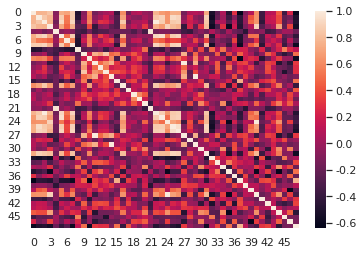

In [150]:
tmz = tmf.TreeMazeZones()
zones = tmz.all_segs_names
sns.heatmap(t[zones].astype('float')corr())

In [130]:
a.loc[a.uuid==1820, 'cue'].iloc[0]

'left'

In [55]:
t = info.get_segment_rate_comps()
t = t[t.unit_type=='cell']

In [70]:
a = t[(t.comp=='cue')&(t.segment=='left')].sort_values('uz_val').cl_name
a

2395      Li_T3g_062518-tt8_d16.75_cl14
9979      Cl_T3g_113018-tt12_d12.5_cl13
11065     Cl_T3g_120618-tt4_d12.75_cl12
1731      Li_T3g_061518-tt8_d16.75_cl13
10614     Cl_T3g_120418-tt4_d12.75_cl11
                      ...              
10376      Cl_T3g_120318-tt12_d12.5_cl4
11557      Cl_T3g_120918-tt4_d12.75_cl4
14797    Cl_T3g_013019-tt10_d15.25_cl12
11352     Cl_T3g_120718-tt4_d12.75_cl16
2398      Li_T3g_062518-tt8_d16.75_cl22
Name: cl_name, Length: 565, dtype: object

<AxesSubplot:xlabel='uz_val', ylabel='Density'>

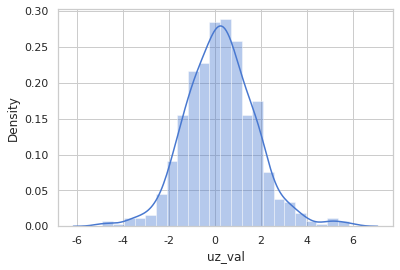

In [54]:
trial_seg = 'stem'
comp = 'cue'
unit_type = 'cell'

sns.distplot(t[(t.segment==trial_seg)&(t.comp==comp)&(t.unit_type==unit_type)].uz_val.sort_values())

In [33]:
#vc_formula= {'task': f"1+C(task)"}
vc_formula = {}#{'session': f"0+C(session)"}
z=z.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zo_p', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=z[z.ts=='in']).fit(reml=False)
print(m.summary())
print(m.wald_test_terms())

LinAlgError: Singular matrix

<AxesSubplot:xlabel='uz_val', ylabel='Density'>

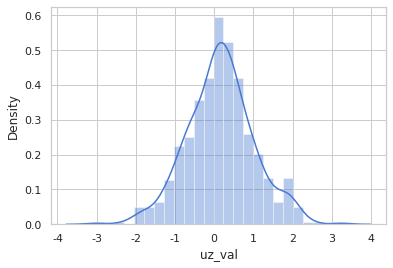

In [53]:
sns.distplot(t[(t.comp==comp)&(t.unit_type==unit_type)].groupby(['subject','session','unit_id']).mean().uz_val)

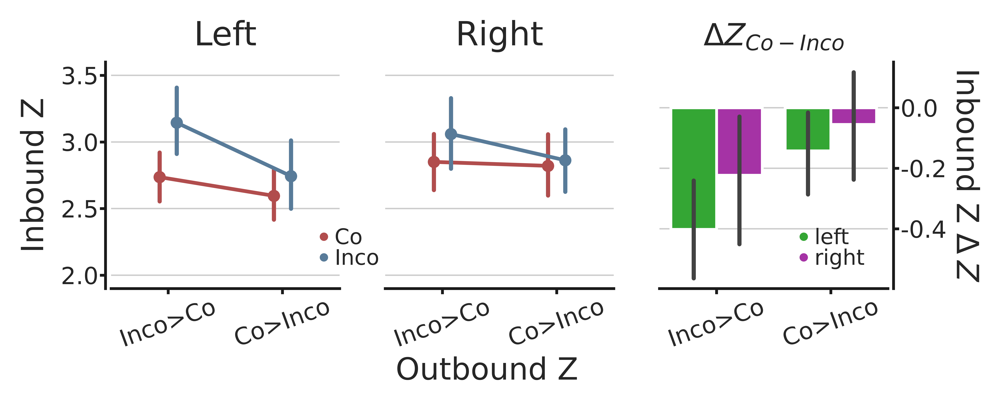

In [10]:
pf = reload(pf)

f = pf.CorrectGroupings()
f.plot_conditional_correct_rates(trial_seg='in', save_flag=True, save_format='svg')

In [11]:
t, z = info.get_conditional_correct_bigseg_rates()

In [34]:
#vc_formula= {'task': f"1+C(task)", 'unit': '1+C(uuid)'}
#vc_formula= {'task': f"1+C(task)"}
vc_formula = {'task': f"1+C(task)",
              'session': f"0+C(session)"}

t=t.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zo_p+cond', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=t[t.ts=='in']).fit()
print(m.summary())
print(m.wald_test_terms())

           Mixed Linear Model Regression Results
Model:              MixedLM Dependent Variable: z          
No. Observations:   7658    Method:             REML       
No. Groups:         5       Scale:              4.8508     
Min. group size:    199     Log-Likelihood:     -17025.5998
Max. group size:    3315    Converged:          No         
Mean group size:    1531.6                                 
-----------------------------------------------------------
                 Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------
Intercept         2.915    1.342  2.172 0.030  0.285  5.546
ms[T.right]       0.015    0.050  0.305 0.760 -0.083  0.114
unit_type[T.mua] -0.341    0.058 -5.933 0.000 -0.454 -0.229
zo_p[T.True]     -0.055    0.056 -0.979 0.328 -0.165  0.055
cond[T.Inco]      0.155    0.050  3.080 0.002  0.056  0.254
subject Var       4.646                                    
session Var       0.275    0.023                   

In [29]:
vc_formula = {'session': f"0+C(session)"}

t=t.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zo_p*cond+cond*task', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=t[t.ts=='in']).fit()
print(m.summary())
print(m.wald_test_terms())

               Mixed Linear Model Regression Results
Model:                 MixedLM    Dependent Variable:    z          
No. Observations:      7658       Method:                REML       
No. Groups:            5          Scale:                 4.8317     
Min. group size:       199        Log-Likelihood:        -17007.5937
Max. group size:       3315       Converged:             Yes        
Mean group size:       1531.6                                       
--------------------------------------------------------------------
                          Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------------
Intercept                  2.803    0.235 11.951 0.000  2.343  3.263
ms[T.right]                0.015    0.050  0.307 0.758 -0.083  0.114
unit_type[T.mua]          -0.339    0.058 -5.897 0.000 -0.452 -0.227
zo_p[T.True]               0.051    0.076  0.673 0.501 -0.098  0.200
cond[T.Inco]               0.330    0.082  4.040 0

In [20]:
#vc_formula= {'task': f"1+C(task)"}
vc_formula = {'task': f"1+C(task)",
              'session': f"0+C(session)"}
z=z.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zo_p', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=z[z.ts=='in']).fit(reml=False)
print(m.summary())
print(m.wald_test_terms())

           Mixed Linear Model Regression Results
Model:             MixedLM  Dependent Variable:  z         
No. Observations:  3811     Method:              ML        
No. Groups:        5        Scale:               6.6158    
Min. group size:   98       Log-Likelihood:      -9033.4393
Max. group size:   1651     Converged:           Yes       
Mean group size:   762.2                                   
-----------------------------------------------------------
                 Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------
Intercept        -0.426    0.251 -1.698 0.090 -0.918  0.066
ms[T.right]       0.089    0.083  1.073 0.283 -0.074  0.253
unit_type[T.mua]  0.067    0.094  0.718 0.473 -0.116  0.251
zo_p[T.True]      0.193    0.088  2.186 0.029  0.020  0.365
subject Var       0.212                                    
session Var       0.079    0.014                           
task Var          0.026    0.015                   

In [21]:
vc_formula = {'task': f"1+C(task)",
              'session': f"0+C(session)"}
t=t.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zi_p*cond', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=t[t.ts=='out']).fit()
print(m.summary())
print(m.wald_test_terms())

               Mixed Linear Model Regression Results
Model:                 MixedLM    Dependent Variable:    z          
No. Observations:      7644       Method:                REML       
No. Groups:            5          Scale:                 2.6436     
Min. group size:       199        Log-Likelihood:        -14730.4312
Max. group size:       3308       Converged:             Yes        
Mean group size:       1528.8                                       
--------------------------------------------------------------------
                          Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------------
Intercept                  2.645    0.456  5.796 0.000  1.751  3.540
ms[T.right]                0.043    0.037  1.168 0.243 -0.029  0.116
unit_type[T.mua]          -0.349    0.043 -8.131 0.000 -0.433 -0.265
zi_p[T.True]               0.025    0.062  0.408 0.683 -0.096  0.147
cond[T.Inco]               0.390    0.073  5.342 0

In [24]:
vc_formula = {'task': f"1+C(task)",
              'session': f"0+C(session)"}
z=z.dropna()

m = smf.mixedlm(formula='z~ms+unit_type+zi_p', groups='subject', 
                vc_formula=vc_formula, re_formula='1', data=z[z.ts=='out']).fit()
print(m.summary())
print(m.wald_test_terms())

           Mixed Linear Model Regression Results
Model:             MixedLM  Dependent Variable:  z         
No. Observations:  3801     Method:              REML      
No. Groups:        5        Scale:               1.6116    
Min. group size:   98       Log-Likelihood:      -6405.3486
Max. group size:   1645     Converged:           No        
Mean group size:   760.2                                   
-----------------------------------------------------------
                 Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------
Intercept        -0.393    0.355 -1.108 0.268 -1.089  0.302
ms[T.right]      -0.069    0.041 -1.684 0.092 -0.150  0.011
unit_type[T.mua]  0.036    0.047  0.762 0.446 -0.057  0.129
zi_p[T.True]      0.109    0.050  2.190 0.029  0.011  0.206
subject Var       0.526                                    
session Var       0.203    0.029                           
task Var          0.072                            

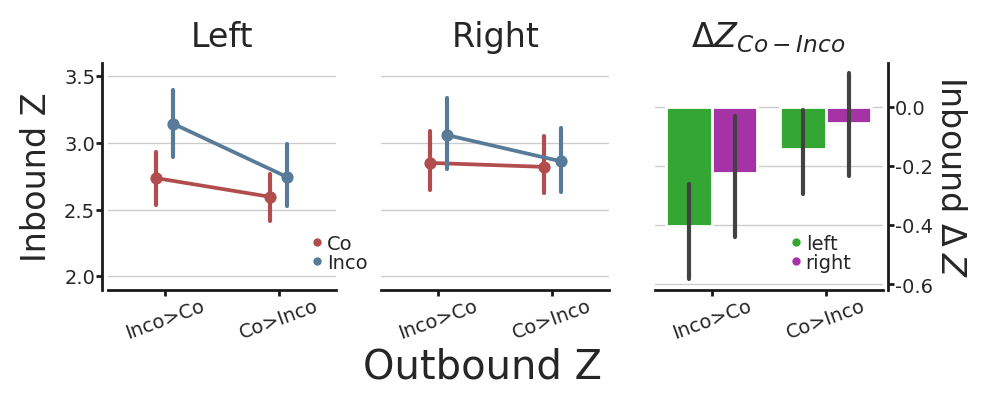

In [398]:

ts = 'in'

if ts=='in':
    conditional = 'zo_p'
    ylabel = 'Inbound Z'
    xlabel = 'Outbound Z'
else:
    conditional = 'zi_p'
    ylabel = 'Outbound Z'
    xlabel = 'Inbound Z'

palette = sns.palettes.color_palette(palette='Set1', n_colors=2, desat=0.5)

f, ax = plt.subplots(1,3, figsize=(5,1.5), dpi=200)
for ii, ms in enumerate(maze_segs):
    pf.setup_axes(ax[ii], fontsize=7)
    idx = (t3.ms==ms) & (t3.ts==ts)& (t3.unit_type=='cell')
    
    sns.pointplot(data=t3.loc[idx], x=conditional, 
                  y="z", hue='cond', ax=ax[ii], hue_order=conds, 
                  dodge=0.15, scale=0.5, errwidth=1.5, palette=palette)
    
    ax[ii].set_ylim([1.9,3.6])
    ax[ii].set_xticklabels(['Inco>Co', 'Co>Inco'], rotation=20,)
    ax[ii].set_xlabel('')
    ax[ii].set_ylabel(ylabel)
    ax[ii].get_legend().remove()
    ax[ii].set_title(ms.capitalize())

    
ax[0].spines['left'].set_position(('outward',2))
ax[1].spines['left'].set_visible(False)
ax[1].tick_params(**dict(axis='y', length=0))
ax[1].set_ylabel('')
ax[1].set_yticklabels([])
f.supxlabel(xlabel, y=-0.2)

legend_elements = []
marker_size = 3
for ii in range(2):
    legend_elements.append(
        mpl.lines.Line2D([0], [0], marker='o', color=palette[ii], lw=0, label=conds[ii],markersize=marker_size, mec=None, mew=0))

ax[0].legend(handles=legend_elements, loc='lower left', bbox_to_anchor=[0.8, 0, 0.2, 0.2], frameon=False, fontsize=7, labelspacing=0, handletextpad=0, handlelength=1)
ax[1].set_zorder(-1)


s=0.65
g = [0.2,s,.2]
p = [s,0.2,s]
colors = [g,p]
pf.setup_axes(ax[2],fontsize=7, spine_list=['bottom', 'right'])
sns.barplot(ax=ax[2],data=z[(z.ts=='in')&(z.unit_type=='cell')], x='zo_p', y='z', hue='ms', hue_order=maze_segs, dodge=True, palette=colors, saturation=1, errwidth=1.5)
ax[2].set_xticklabels(['Inco>Co', 'Co>Inco'], rotation=20,)
ax[2].set_xlabel('')
ax[2].set_ylabel(f'Inbound $\Delta \: Z$', rotation=270, labelpad=12)
ax[2].yaxis.set_label_position("right")
ax[2].yaxis.tick_right()
ax[2].spines['right'].set_position(('outward',2))
ax[2].set_title(f'$\Delta Z_{{Co-Inco}}$')
legend_elements = []
marker_size = 3
for ii in range(2):
    legend_elements.append(
        mpl.lines.Line2D([0], [0], marker='o', color=colors[ii], lw=0, label=maze_segs[ii],markersize=marker_size, mec=None, mew=0))

ax[2].legend(handles=legend_elements, loc='lower left', bbox_to_anchor=[0.5, 0, 0.2, 0.2], frameon=False, fontsize=7, labelspacing=0, handletextpad=0, handlelength=1)
#ax[1].set_zorder(-1)


Text(0.5, 1.0, '$\\Delta Z_{Co-Inco}$')

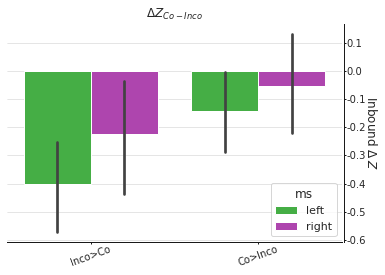

In [397]:
f, ax = plt.subplots()
s=0.75
g = [0.2,s,.2]
p = [s,0.2,s]
pf.setup_axes(ax, spine_list=['bottom', 'right'])
sns.barplot(ax=ax,data=z[(z.ts=='in')&(z.unit_type=='cell')], x='zo_p', y='z', hue='ms', hue_order=maze_segs, dodge=True, palette=[g,p])
ax.set_xticklabels(['Inco>Co', 'Co>Inco'], rotation=20,)
ax.set_xlabel('')
ax.set_ylabel(f'$\Delta Z_{{Co-Inco}}$')

ax.set_ylabel(f'Inbound $\Delta \: Z$', rotation=270, labelpad=12)
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()
ax.spines['right'].set_position(('outward',2))
ax.set_title(f'$\Delta Z_{{Co-Inco}}$')

(0.696078431372549, 0.30000000000000004, 0.30392156862745096)

In [215]:
f.supxlabel?

Signature: f.supxlabel(t, **kwargs)
Docstring:
Add a centered supxlabel to the figure.

Parameters
----------
t : str
    The supxlabel text.
x : float, default: 0.5
    The x location of the text in figure coordinates.
y : float, default: 0.01
    The y location of the text in figure coordinates.
horizontalalignment, ha : {'center', 'left', 'right'}, default: center
    The horizontal alignment of the text relative to (*x*, *y*).
verticalalignment, va : {'top', 'center', 'bottom', 'baseline'}, default: bottom
    The vertical alignment of the text relative to (*x*, *y*).
fontsize, size : default: :rc:`figure.titlesize`
    The font size of the text. See `.Text.set_size` for possible
    values.
fontweight, weight : default: :rc:`figure.titleweight`
    The font weight of the text. See `.Text.set_weight` for possible
    values.

Returns
-------
text
    The `.Text` instance of the supxlabel.

Other Parameters
----------------
fontproperties : None or dict, optional
    A dict of font 

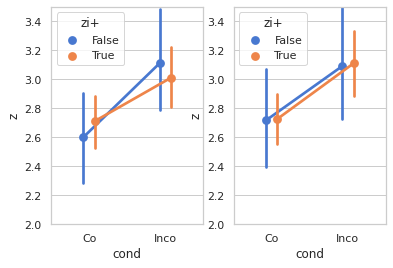

In [171]:
f, ax = plt.subplots(1,2)
for ii,ms in enumerate(maze_segs):
    idx = (t3.ms==ms) & (t3.ts=='out')& (t3.unit_type=='cell')
    sns.pointplot(data=t3.loc[idx], x="cond", 
                  y="z", hue='zi+', ax=ax[ii], dodge=0.15)
    ax[ii].set_ylim([2,3.5])

<AxesSubplot:xlabel='zo_p', ylabel='count'>

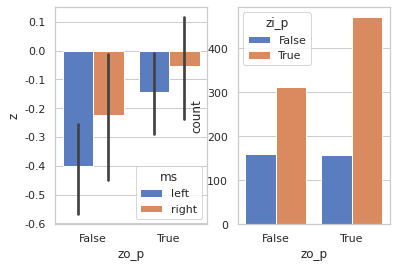

In [274]:
f, ax = plt.subplots(1,2)
sns.barplot(ax=ax[0],data=z[(z.ts=='in')&(z.unit_type=='cell')], x='zo_p', y='z', hue='ms')
sns.countplot(ax=ax[1],data=z[(z.ts=='in')&(z.unit_type=='cell')], hue='zi_p', x='zo_p')
# sns.stripplot(data=y[(y.ts=='in')&(y.unit_type=='cell')], x='zo+', y='z', hue='ms', alpha=0.2,)


<AxesSubplot:xlabel='zi+', ylabel='z'>

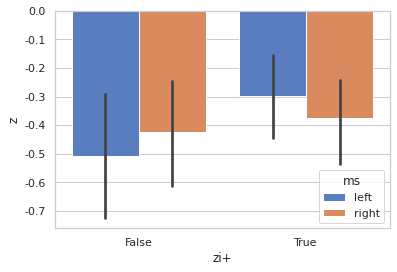

In [176]:
f, ax = plt.subplots()
sns.barplot(ax=ax,data=z[(z.ts=='out')&(z.unit_type=='cell')], x='zi+', y='z', hue='ms')

<AxesSubplot:xlabel='delta_Co_in', ylabel='z_in'>

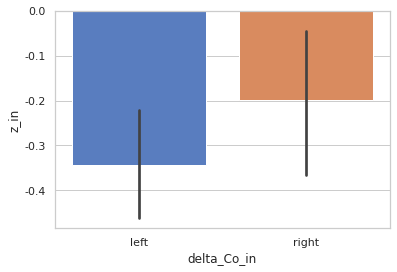

In [101]:
sns.barplot(data=X[X.unit_type=='cell'].loc[X.z_out<0], x='delta_Co_in', y='z_in')

<AxesSubplot:xlabel='delta_Co_in', ylabel='z_in'>

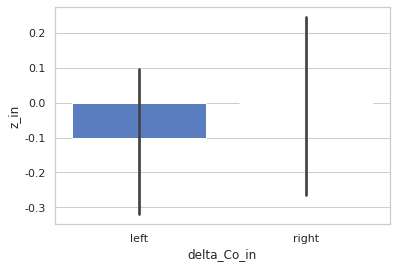

In [100]:
sns.barplot(data=X[X.unit_type=='cell'].loc[X.z_out>=0], x='delta_Co_in', y='z_in')

In [71]:
sm.MixedLM(data=data=X[X.unit_type=='cell'], m_)

<module 'statsmodels.api' from '/home/alexgonzalez/anaconda3/envs/tm_analyses/lib/python3.9/site-packages/statsmodels/api.py'>

<AxesSubplot:xlabel='unit_type', ylabel='delta_Co_in_left'>

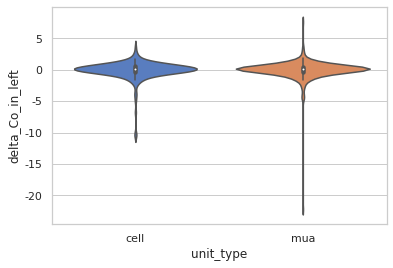

In [22]:
idx = x['delta_Co_out_left'] > 0
sns.barplot(data=x.loc[idx], x='')
sns.violinplot(y=x.loc[idx, 'delta_Co_in_left'], x=x.loc[idx, 'unit_type'])

In [29]:
ms = 'left'
idx = x[f'delta_Co_out_{ms}'] < 0
x.loc[idx, f'delta_Co_in_{ms}'].median()

-0.07289881649644059

In [414]:
ii=0
z_colors = sns.palettes.color_palette('colorblind')[:3]
cols = ff.colors + [z_colors[ii]]
cols

['tab:blue',
 'tab:orange',
 'tab:green',
 'tab:red',
 'tab:purple',
 'tab:brown',
 'tab:pink',
 'tab:gray',
 'tab:olive',
 'tab:cyan',
 (0.00392156862745098, 0.45098039215686275, 0.6980392156862745)]

In [409]:
ff.match_scores_table

,match_cl_id,subject,TM-remap_cue,TM-remap_rw,TM-stability_tm,TM-rate_cue,TM-rate_rw,TM-global_cue,TM-global_rw,TM-enc_uz_cue,...,OF-speed-map_r,OF-speed-r2,OF-metric_score_border,OF-metric_score_grid,OF-metric_score_hd,OF-metric_score_speed,OF-metric_score_pos,UMAP-1,UMAP-2,Cluster
0,0,Li,-0.477471,-0.992209,1.047540,0.043149,0.064612,0.036118,0.063609,-0.831522,...,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692,-2.638338,0.990572,0
1,1,Li,-0.137774,-1.618546,0.734345,0.024987,0.078723,0.006386,0.055165,-0.869318,...,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.442600,3.101047,3.932008,1
2,2,Li,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,0.063531,-0.907115,...,0.597518,0.020432,0.410825,-0.116138,0.052443,0.053874,0.425990,9.152409,4.889115,2
3,3,Li,-0.746639,-0.885057,0.796650,0.125429,0.096856,0.117374,0.074609,-0.302372,...,0.740471,0.067012,0.327252,NaN,0.033747,0.196234,0.290122,11.181856,5.648394,2
4,4,Li,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.294793,0.005219,-0.280860,-0.214551,0.855297,-0.019892,0.356961,-3.763964,1.916983,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,212,Ca,-0.290551,-0.706569,0.317611,-0.286214,-0.097742,-0.358769,-0.102196,-0.302372,...,0.559884,0.018422,0.404300,-0.188767,0.032119,0.038315,0.680981,7.853930,4.305125,2
213,213,Ca,0.621142,0.568547,0.205431,NaN,NaN,NaN,NaN,NaN,...,0.652530,0.013924,0.604265,-0.155380,0.058752,0.077930,0.535602,8.302361,4.307436,2
214,214,Ca,-0.057788,0.316063,0.169561,-0.007369,0.002454,-0.017487,NaN,-1.360672,...,0.638373,0.005161,0.497950,-0.044624,0.055150,0.044356,0.526737,5.213426,3.009110,1
215,215,Ca,-0.010541,0.006612,0.259065,-0.000106,-0.004049,-0.014130,-0.024333,-2.267787,...,0.639597,0.004767,0.515748,NaN,0.035599,-0.046795,0.400390,3.950651,2.857656,1


In [364]:
t = info.get_tm_scores()

In [373]:
str_vals = {'Inco': -1, '~Inco': -1 / 3, '~Co': 1 / 3, 'Co': 1}
str_vals_list = list(str_vals.keys())

valid_idx = t['remap_cue'].dropna().index
n_units = len(valid_idx)
t = t.loc[valid_idx]
for ii, z in enumerate(['cue', 'rw']):
    var = f'fr_uz_tau_{z}_correct'
    new_var = f'{z}_c'
    dependent_var = f'remap_{z}'

    t[new_var] = ''
    for k, v in str_vals.items():
        t.loc[t[var] == v, new_var] = k

    t[new_var] = t[new_var].astype(pd.CategoricalDtype(categories=str_vals_list, ordered=True))

In [394]:
cond = 'Co'
n_co =  ((t['cue_c']==cond).sum() + (t['rw_c']==cond).sum() )
n_cue_rw_co = ((t['cue_c']==cond) &  (t['rw_c']==cond)).sum()
p_cue_rw_co = n_cue_rw_co / n_co
n_cue_rw_co, n_co, p_cue_rw_co

(7, 93, 0.07526881720430108)

In [400]:
table = [[7, 86],[71,280]]
scipy.stats.fisher_exact(table)

(3.209957418932198e-01, 0.003359047947781114)

In [386]:
p_rw_co = (t['rw_c']==cond).sum() / n_co
p_rw_co

0.3870967741935484

In [393]:
cond = 'Inco'
n_inco =  ((t['cue_c']==cond).sum() + (t['rw_c']==cond).sum() )
n_cue_rw_inco = ((t['cue_c']==cond) &  (t['rw_c']==cond)).sum()
p_cue_rw_inco = n_cue_rw_inco / n_inco
n_cue_rw_inco, n_inco, p_cue_rw_inco

(71, 351, 0.2022792022792023)

In [397]:
#(1-p_cue_rw_inco) 
(351-71)

280

In [392]:
n_cue_rw_inco, n_inco

(71, 351)

In [389]:
(p_cue_rw_inco/(1-p_cue_rw_inco) ) / (p_cue_rw_co/(1-p_cue_rw_co))

3.1153061224489793

In [365]:
t = t[t.unit_type=='cell']
x = t['fr_uz_tau_cue_correct']
y = t['fr_uz_tau_rw_correct']

func_set = [[np.equal, np.equal], [np.greater, np.less]]
comps_val_set = [[1, -1], [0, 0]]

<AxesSubplot:xlabel='remap_cue', ylabel='Density'>

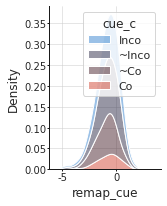

In [366]:
cue_c ='fr_uz_tau_cue_correct'
str_vals = {'Inco':-1,'~Inco':-1/3, '~Co':1/3, 'Co':1}
#vals = t[cue_c].value_counts().index
t['cue_c'] = ''
for k, v in str_vals.items():
    t.loc[t[cue_c]==v, 'cue_c'] = k

t['cue_c'] = t['cue_c'].astype(pd.CategoricalDtype(categories=str_vals, ordered=True))

f,ax=plt.subplots(figsize=(2,3))
pf.setup_axes(ax)
c = sns.color_palette('icefire')
sns.kdeplot(data=t, x='remap_cue', hue='cue_c', palette='icefire',fill=True, alpha=0.5, multiple='stack')


In [369]:
t = t.loc[t.remap_cue.dropna().index]
t

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,fr_uz_dir_right,fr_uz_rw_left,fr_uz_rw_stem,fr_uz_rw_right,fr_uz_tau_cue_correct,fr_uz_tau_rw_correct,n_trials,pct_correct,pct_sw_correct,cue_c
16,Li,Li_T3g_052918,T3g,52918,0,cell,2,18,16.50,Li_T3g_052918-tt2_d16.5_cl18,...,-1.627569,-0.035718,0.691382,0.765466,1.000000,0.333333,179.0,0.848315,0.843750,Co
17,Li,Li_T3g_052918,T3g,52918,1,cell,8,0,16.25,Li_T3g_052918-tt8_d16.25_cl0,...,7.252258,-1.523954,0.306155,-0.357217,-0.333333,-0.333333,179.0,0.848315,0.843750,~Inco
18,Li,Li_T3g_052918,T3g,52918,2,cell,8,12,16.25,Li_T3g_052918-tt8_d16.25_cl12,...,-1.374924,0.839365,-3.075738,1.816705,-0.333333,0.333333,179.0,0.848315,0.843750,~Inco
19,Li,Li_T3g_052918,T3g,52918,3,cell,8,16,16.25,Li_T3g_052918-tt8_d16.25_cl16,...,-5.103441,-1.976377,-0.675162,-2.786295,-0.333333,-1.000000,179.0,0.848315,0.843750,~Inco
20,Li,Li_T3g_052918,T3g,52918,4,cell,8,17,16.25,Li_T3g_052918-tt8_d16.25_cl17,...,-1.364286,-1.023906,0.533236,-2.592377,0.333333,-0.333333,179.0,0.848315,0.843750,~Co
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4296,Ca,Ca_T3g_030719,T3g,30719,0,cell,11,9,15.50,Ca_T3g_030719-tt11_d15.5_cl9,...,0.278607,-0.190826,-0.136615,-0.738549,-1.000000,-1.000000,60.0,0.525424,0.517241,Inco
4301,Ca,Ca_T3g_030819,T3g,30819,0,cell,11,15,15.75,Ca_T3g_030819-tt11_d15.75_cl15,...,2.185959,-2.135416,-0.176842,-0.360288,-0.333333,-1.000000,71.0,0.542857,0.588235,~Inco
4310,Ca,Ca_T3g_031219,T3g,31219,0,cell,11,2,16.25,Ca_T3g_031219-tt11_d16.25_cl2,...,0.470016,-2.325551,1.079070,-0.612372,-0.333333,-0.333333,81.0,0.475000,0.448276,~Inco
4360,Ca,Ca_T3g_032119,T3g,32119,0,cell,4,14,17.00,Ca_T3g_032119-tt4_d17.0_cl14,...,-8.997129,-2.879084,-2.173232,-1.661325,0.333333,-1.000000,296.0,0.878378,0.910256,~Co


In [372]:
(t['cue_c']=='Co').mean(), ((t['cue_c']=='Co') & t['cue_c']=='Co') 

0.10326086956521739

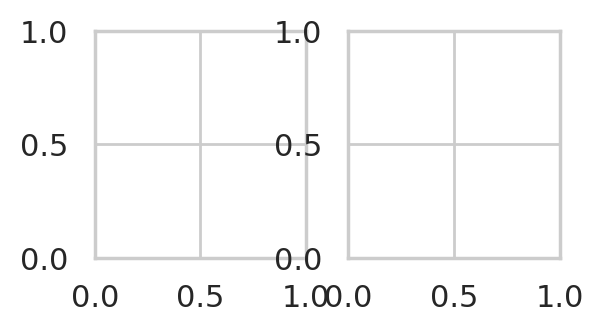

In [164]:
figsize = (3, 1.5)
f, ax = plt.subplots(1, 2, figsize=figsize, dpi=200)

In [ ]:
t['cue_c']

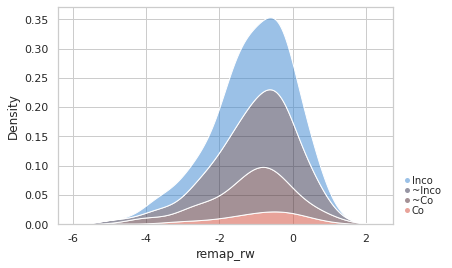

In [188]:
var ='fr_uz_tau_rw_correct'
new_var = 'rw_c'
dependent_var = 'remap_rw'

str_vals = {'Inco':-1,'~Inco':-1/3, '~Co':1/3, 'Co':1}
str_vals_list = list(str_vals.keys())
t[new_var] = ''
for k, v in str_vals.items():
    t.loc[t[var]==v, new_var] = k

t[new_var] = t[new_var].astype(pd.CategoricalDtype(categories=str_vals_list, ordered=True))

f,ax=plt.subplots()
c = sns.color_palette('icefire', n_colors=4)
sns.kdeplot(data=t, x=dependent_var, hue='rw_c', palette='icefire',fill=True, alpha=0.5, multiple='stack', legend=False)

legend_elements = []
alpha=0.5
marker_size=5
for ii in range(4):
    legend_elements.append(
        mpl.lines.Line2D([0], [0], marker='o', color=c[ii], lw=0, alpha=alpha, label=str_vals_list[ii],
                         markersize=marker_size, mec=None, mew=0))
ax.legend(handles=legend_elements, loc='lower left', bbox_to_anchor=[1, 0, 0.2, 1], frameon=False,
                     fontsize=10, labelspacing=0, handletextpad=0, handlelength=1)

In [220]:
t2 = t.loc[t.remap_cue.dropna().index]
t2[~t2.cue_c.isin(str_vals_list)]['session']

3170    Cl_T3g_121418_0
3171    Cl_T3g_121418_0
3172    Cl_T3g_121418_0
Name: session, dtype: object

In [227]:
b = info.get_behav_perf()

In [230]:
b[b.session=='Cl_T3g_121418_0']

,n_trials,n_sw_trials,n_vsw_trials,n_L_trials,n_R_trials,pct_correct,pct_sw_correct,pct_vsw_correct,pct_L_correct,pct_R_correct,session,task,subject,n_units,n_cells,n_mua
92,95,44,34,45,50,0.768421,0.818182,0.911765,0.8,0.74,Cl_T3g_121418_0,T3g,Cl,12,3,9


In [231]:
si = info.get_session('Cl_T3g_121418_0')

In [234]:
si.get_bigseg_cond_rates(overwrite=True)

,CR_out_left_m,CR_out_left_z,CR_out_left_n,CR_out_stem_m,CR_out_stem_z,CR_out_stem_n,CR_out_right_m,CR_out_right_z,CR_out_right_n,CR_in_left_m,...,All_out_right_n,All_in_left_m,All_in_left_z,All_in_left_n,All_in_stem_m,All_in_stem_z,All_in_stem_n,All_in_right_m,All_in_right_z,All_in_right_n
0,6.743429,NaN,1.0,5.329246,6.795208,50.0,NaN,NaN,0.0,5.963632,...,1.0,6.725534,6.241845,2.0,6.015156,4.250261,95.0,7.604967,NaN,1.0
1,3.784006,NaN,1.0,2.514010,4.786311,50.0,NaN,NaN,0.0,7.431104,...,1.0,5.195815,1.643634,2.0,3.814841,1.975775,95.0,9.210526,NaN,1.0
2,35.009755,NaN,1.0,18.699435,9.604642,50.0,NaN,NaN,0.0,28.546419,...,1.0,31.194411,8.330004,2.0,20.793676,5.168780,95.0,22.586120,NaN,1.0
3,2.569875,NaN,1.0,1.899389,3.232158,50.0,NaN,NaN,0.0,2.105263,...,1.0,2.532895,4.188248,2.0,2.521331,2.997870,95.0,6.533488,NaN,1.0
4,1.239669,NaN,1.0,1.634983,4.292523,50.0,NaN,NaN,0.0,1.052632,...,1.0,2.171053,1.372619,2.0,2.092797,2.730021,95.0,3.612139,NaN,1.0
5,5.743802,NaN,1.0,2.019096,3.579423,50.0,NaN,NaN,0.0,2.631579,...,1.0,2.796053,12.020815,2.0,1.686061,1.892334,95.0,2.302632,NaN,1.0
6,3.507519,NaN,1.0,1.976962,4.237837,50.0,NaN,NaN,0.0,3.674159,...,1.0,4.616685,3.463554,2.0,2.674750,2.598419,95.0,2.380986,NaN,1.0
7,4.594669,NaN,1.0,1.782105,3.174453,50.0,NaN,NaN,0.0,6.832054,...,1.0,6.212079,7.085140,2.0,3.378754,1.994101,95.0,4.934211,NaN,1.0
8,3.297893,NaN,1.0,1.855101,3.675890,50.0,NaN,NaN,0.0,2.631579,...,1.0,2.302632,4.949747,2.0,2.379996,3.003883,95.0,3.289474,NaN,1.0
9,4.036817,NaN,1.0,1.897120,3.617225,50.0,NaN,NaN,0.0,1.299525,...,1.0,1.455684,6.591539,2.0,1.985614,2.112801,95.0,2.631579,NaN,1.0


In [237]:
tmf.mean_segment_rates_analysis(si, si.ta)

,CR_out_left_m,CR_out_left_z,CR_out_left_n,CR_out_stem_m,CR_out_stem_z,CR_out_stem_n,CR_out_right_m,CR_out_right_z,CR_out_right_n,CR_in_left_m,...,All_out_right_n,All_in_left_m,All_in_left_z,All_in_left_n,All_in_stem_m,All_in_stem_z,All_in_stem_n,All_in_right_m,All_in_right_z,All_in_right_n
0,6.743429,NaN,1.0,5.329246,6.795208,50.0,NaN,NaN,0.0,5.963632,...,1.0,6.725534,6.241845,2.0,6.015156,4.250261,95.0,7.604967,NaN,1.0
1,3.784006,NaN,1.0,2.514010,4.786311,50.0,NaN,NaN,0.0,7.431104,...,1.0,5.195815,1.643634,2.0,3.814841,1.975775,95.0,9.210526,NaN,1.0
2,35.009755,NaN,1.0,18.699435,9.604642,50.0,NaN,NaN,0.0,28.546419,...,1.0,31.194411,8.330004,2.0,20.793676,5.168780,95.0,22.586120,NaN,1.0
3,2.569875,NaN,1.0,1.899389,3.232158,50.0,NaN,NaN,0.0,2.105263,...,1.0,2.532895,4.188248,2.0,2.521331,2.997870,95.0,6.533488,NaN,1.0
4,1.239669,NaN,1.0,1.634983,4.292523,50.0,NaN,NaN,0.0,1.052632,...,1.0,2.171053,1.372619,2.0,2.092797,2.730021,95.0,3.612139,NaN,1.0
5,5.743802,NaN,1.0,2.019096,3.579423,50.0,NaN,NaN,0.0,2.631579,...,1.0,2.796053,12.020815,2.0,1.686061,1.892334,95.0,2.302632,NaN,1.0
6,3.507519,NaN,1.0,1.976962,4.237837,50.0,NaN,NaN,0.0,3.674159,...,1.0,4.616685,3.463554,2.0,2.674750,2.598419,95.0,2.380986,NaN,1.0
7,4.594669,NaN,1.0,1.782105,3.174453,50.0,NaN,NaN,0.0,6.832054,...,1.0,6.212079,7.085140,2.0,3.378754,1.994101,95.0,4.934211,NaN,1.0
8,3.297893,NaN,1.0,1.855101,3.675890,50.0,NaN,NaN,0.0,2.631579,...,1.0,2.302632,4.949747,2.0,2.379996,3.003883,95.0,3.289474,NaN,1.0
9,4.036817,NaN,1.0,1.897120,3.617225,50.0,NaN,NaN,0.0,1.299525,...,1.0,1.455684,6.591539,2.0,1.985614,2.112801,95.0,2.631579,NaN,1.0


In [243]:
trials = si.ta.get_condition_trials(condition='CR')
#si.ta.get_trial_segment_rates(trials=trials, segment_type='subseg')
X = si.ta.get_trial_neural_data(trials)

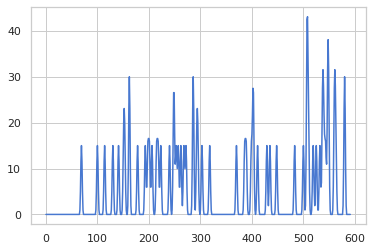

In [253]:
plt.plot(X[0][10])

<AxesSubplot:>

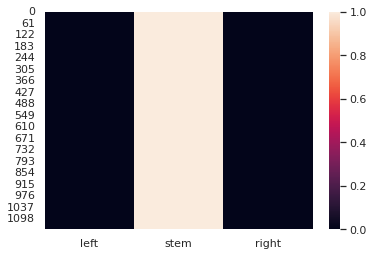

In [315]:
Z = si.ta.trial_zones['out']
sns.heatmap(si.ta.tmz.get_pos_zone_mat(Z[6], segment_type='bigseg'))

In [304]:
z = si.ta.get_trial_zones()

In [306]:
z[0]

array(['H', 'H', 'H', ..., 'G4', 'G4', 'G4'], dtype=object)

In [299]:
self = si.ta
trial_seg = 'out'
n_trials = self.n_trials
trials = self.all_trials
t0, tE = self.get_trials_t0_tE(trial_seg)

trial_zones = np.zeros(n_trials, dtype=object)
pz = self.pz
for ii, tr in enumerate(trials):
    trial_zones[ii] = pz[t0[tr]:(tE[tr] + 1)]

In [321]:
tr = 4
(trial_zones[tr]!='H').sum(), len(trial_zones[tr])

(0, 564)

In [319]:
(pz[t0[tr]:(tE[tr]+1)]!='H').sum()

0

In [320]:
trial_table.loc[tr]

t0         6823
tD         7085
tE         7386
tE_1       7386
tE_2       7386
tR         7882
dur         562
cue           R
dec           L
correct       0
long        NaN
goal        NaN
grw           0
sw            0
vsw           0
Name: 4, dtype: object

In [331]:
td = si.get_track_data()

<AxesSubplot:xlabel='x', ylabel='y'>

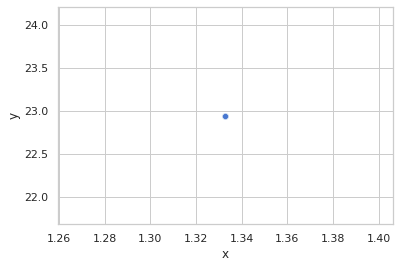

In [347]:
tr=60
sns.scatterplot(data=td.loc[t0[tr]:(tE[tr]+1)], x='x', y='y')

In [ ]:
td.loc[]

In [273]:
be = si.get_event_behavior()
trial_table = be.trial_table
event_table = be.event_table

In [281]:
event_table[event_table.trial_num==1]

,event,t0,tE,dur,trial_num,out_bound
28,CL,2679,3177,498,1,1
29,R_blank,2687,2712,25,1,1
30,DE1,2688,2693,5,1,1
31,RD,2688,2712,24,1,1
32,RW1,2688,2712,24,1,1
33,L2,2745,3027,282,1,1
34,DE1,2902,2907,5,1,1
35,R_blank,3026,3051,25,1,1
36,DE2,3027,3032,5,1,1
37,RW2,3027,3051,24,1,1


In [256]:
si.ta.trial_zones_rates['out']

array([           H        a_0        a_1        a_2        a_3       a_4       a_5  \
       0   5.555556  26.654508   9.940983  15.000000  10.772542  0.136416  8.125000
       1   3.324653  25.000000  21.500000   7.690983   8.125000  4.375000  1.488729
       2   3.056769   5.992486  35.000000  15.809017   0.000000  7.340847  5.954915
       3   4.789535        NaN        NaN        NaN        NaN       NaN       NaN
       4   5.762411        NaN        NaN        NaN        NaN       NaN       NaN
       ..       ...        ...        ...        ...        ...       ...       ...
       90  5.633803        NaN        NaN        NaN        NaN       NaN       NaN
       91  6.782713        NaN        NaN        NaN        NaN       NaN       NaN
       92  5.583438        NaN        NaN        NaN        NaN       NaN       NaN
       93  5.184738        NaN        NaN        NaN        NaN       NaN       NaN
       94  3.674352        NaN        NaN        NaN        NaN       NaN

In [16]:
x[func(x,val)].index

Int64Index([  16,  105,  141,  143,  157,  187,  190,  193,  240,  243,
            ...
            4234, 4236, 4292, 4302, 4303, 4311, 4312, 4322, 4359, 4383],
           dtype='int64', length=208)

In [170]:
l = ax.get_legend()

In [179]:
l.get_

TypeError: get_legend_handler() missing 2 required positional arguments: 'legend_handler_map' and 'orig_handle'

In [148]:
t[cue_c].value_counts().index==-1/3

array([ True, False, False, False])

In [149]:
{1='a'}


SyntaxError: invalid syntax (3397263219.py, line 1)

In [126]:
a[0]

(0.2213631, 0.16471913, 0.33041431)

<AxesSubplot:xlabel='remap_cue'>

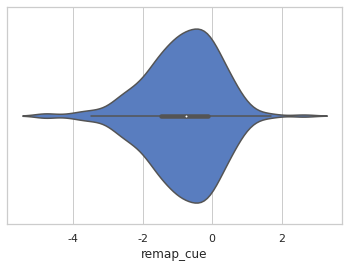

In [97]:
sns.violinplot(data=t, x='remap_cue', hue='fr_uz_tau_rw_correct')

In [62]:
for ii in range(2):
    for jj in range(2):
        func = func_set[ii][jj]
        val = comps_val_set[ii][jj]

        s1 = set(x[func(x, val)].index)
        s2 = set(y[func(y, val)].index) 
        print(max(len(s1), len(s2)))

58
204
196
410


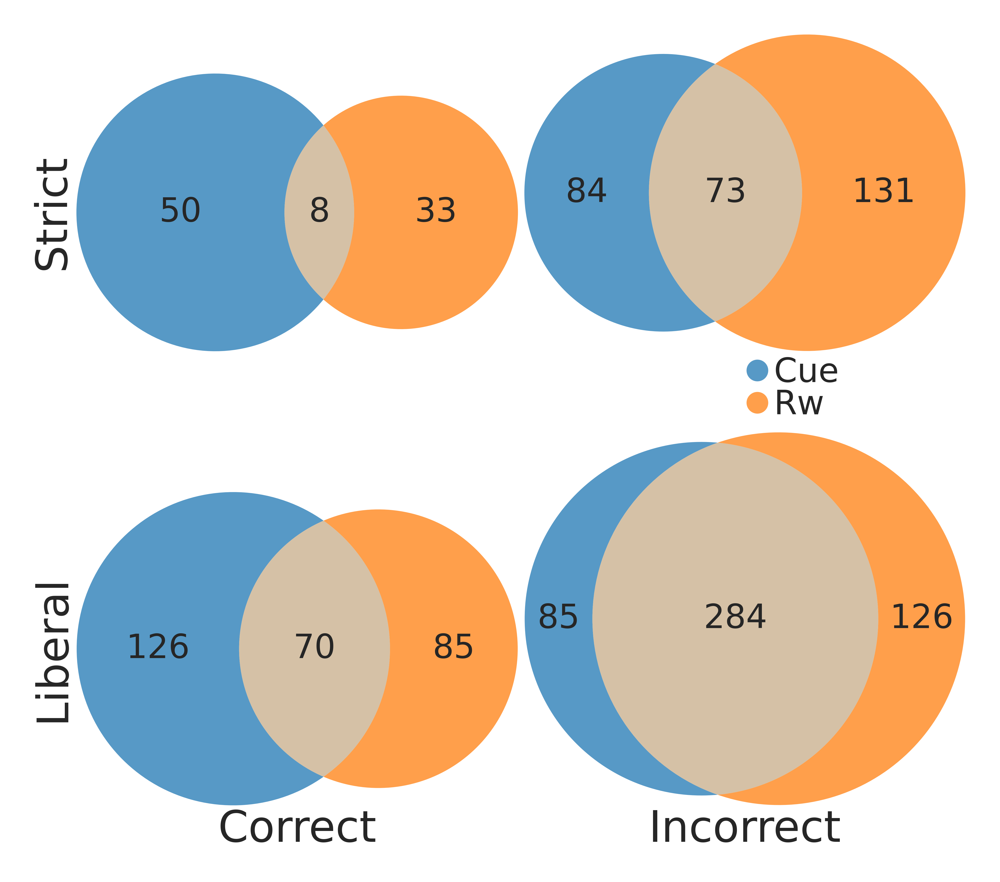

In [88]:
pf = reload(pf)
f = pf.RateCorrectGroupings()
_,ax =f.plot_cue_rw_correct_rate_coding_overlap()

In [77]:
xaxis = ax[1,0].xaxis
xaxis.get_visible()

True

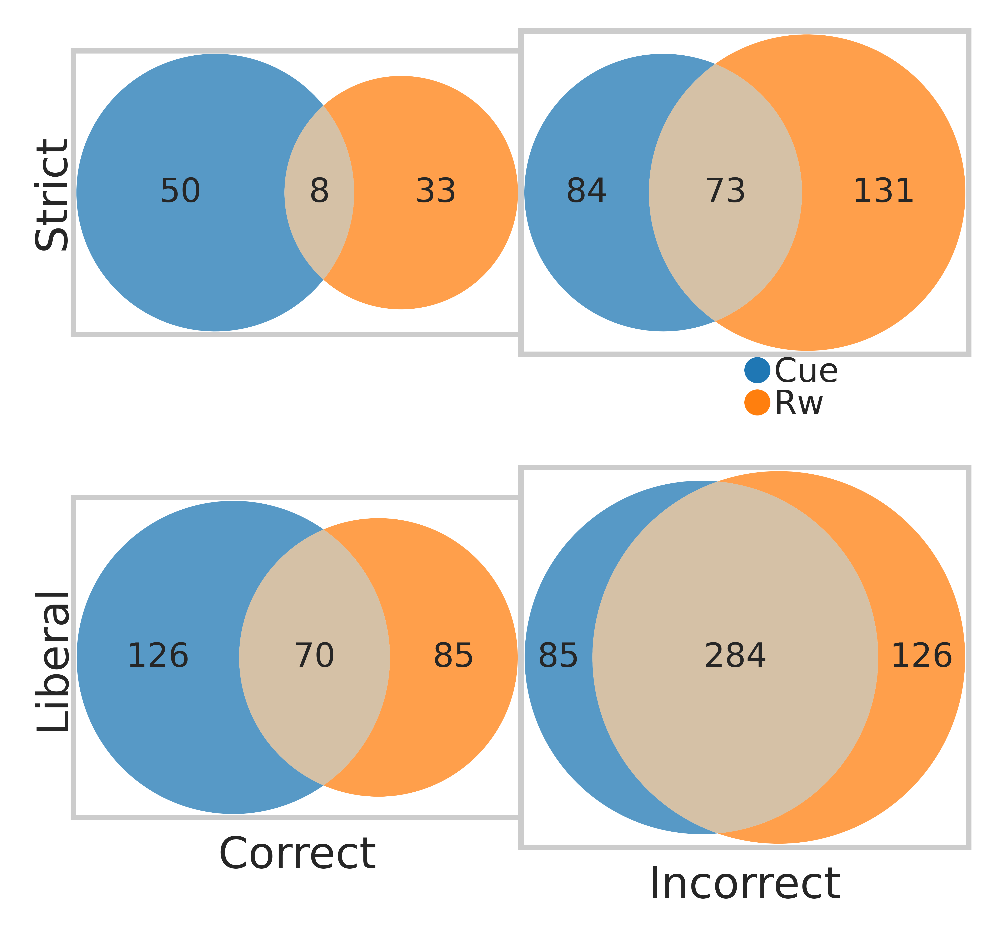

In [83]:
ax[0,1].set_axis_on()
_

In [340]:
b = info.get_behav_perf(overwrite=True)

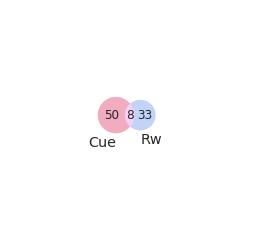

In [65]:
tt = t[t.unit_type=='cell']
x = tt['fr_uz_tau_cue_correct']
y = tt['fr_uz_tau_rw_correct']


venn2( (set(list(x[x==1].index)), set(list(y[y==1].index))), set_labels=['Cue', 'Rw'], set_colors=['#DE3163','#6495ED'], normalize_to=1/500)

In [415]:
set(x[x==1].index)

{21,
 32,
 42,
 66,
 69,
 71,
 77,
 85,
 88,
 107,
 116,
 134,
 136,
 148,
 151,
 180,
 190,
 193}

In [413]:
np.zeros((2,2)).size

4

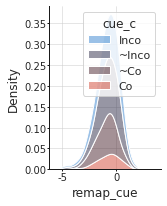

In [405]:
f

In [410]:
func_set = [[np.equal, np.equal], [np.greater, np.less]]

In [412]:
func_set[0][0]

<ufunc 'equal'>

In [356]:
t = info.get_combined_scores_matched_units()
c = info.get_matched_of_cell_clusters()
t[c.columns] = c

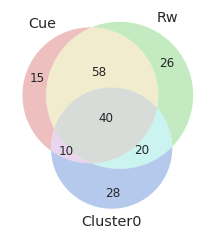

In [362]:
tt = t
x = tt['fr_uz_tau_cue_correct']
y = tt['fr_uz_tau_rw_correct']
z = tt['Cluster']
venn3( (set(list(x[x<0].index)), set(list(y[y<0].index)), set(list(z[z==0].index))), set_labels=['Cue', 'Rw', 'Cluster0'] )

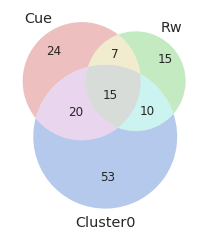

In [361]:
venn3( (set(list(x[x>0].index)), set(list(y[y>0].index)), set(list(z[z==0].index))), set_labels=['Cue', 'Rw', 'Cluster0'] )

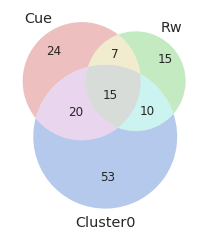

In [378]:
venn3( (set(list(x[x>0].index)), set(list(y[y>0].index)), set(list(z[z==0].index))), set_labels=['Cue', 'Rw', 'Cluster0'] )

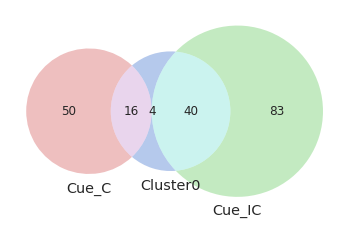

In [392]:
venn3( (set(list(x[x>0].index)), set(list(x[x<0].index)), set(list(z[z==2].index))), set_labels=['Cue_C','Cue_IC', 'Cluster0'] )

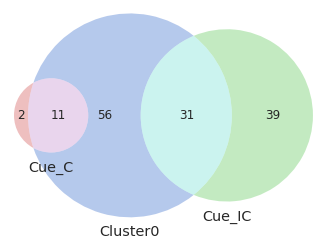

In [407]:
venn3( (set(list(y[y==1].index)), set(list(y[y==-1].index)), set(list(z[z==0].index))), set_labels=['Cue_C','Cue_IC', 'Cluster0'], normalize_to=10)

In [405]:
y

0     -0.333333
1     -0.333333
2     -0.333333
3     -1.000000
4           NaN
         ...   
212    0.333333
213    0.333333
214   -0.666667
215   -0.333333
216         NaN
Name: fr_uz_tau_rw_correct, Length: 217, dtype: float64

In [395]:
venn3?

Signature:
venn3(
    subsets,
    set_labels=('A', 'B', 'C'),
    set_colors=('r', 'g', 'b'),
    alpha=0.4,
    normalize_to=1.0,
    ax=None,
    subset_label_formatter=None,
)
Docstring:
Plots a 3-set area-weighted Venn diagram.
The subsets parameter can be one of the following:
 - A list (or a tuple), containing three set objects.
 - A dict, providing sizes of seven diagram regions.
   The regions are identified via three-letter binary codes ('100', '010', etc), hence a valid set could look like:
   {'001': 10, '010': 20, '110':30, ...}. Unmentioned codes are considered to map to 0.
 - A list (or a tuple) with 7 numbers, denoting the sizes of the regions in the following order:
   (100, 010, 110, 001, 101, 011, 111).

``set_labels`` parameter is a list of three strings - set labels. Set it to None to disable set labels.
The ``set_colors`` parameter should be a list of three elements, specifying the "base colors" of the three circles.
The colors of circle intersections will be comp

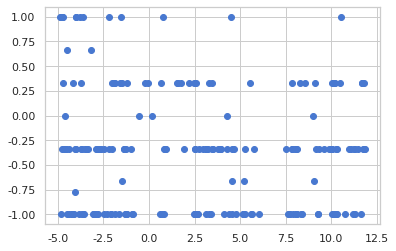

In [382]:
plt.scatter(data=p, x='UMAP-1', y='fr_uz_tau_rw_correct')

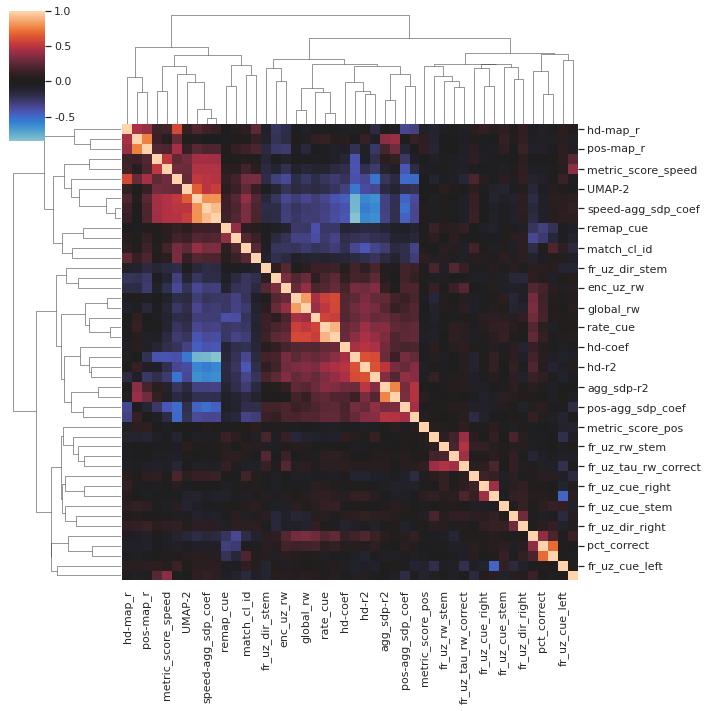

In [387]:
sns.clustermap(p.corr(method='kendall'), center=0)

In [371]:
p

,match_cl_id,subject,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,global_cue,global_rw,enc_uz_cue,...,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos,UMAP-1,UMAP-2,Cluster
0,0,Li,-0.477471,-0.992209,1.047540,0.043149,0.064612,0.036118,0.063609,-0.831522,...,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692,-2.638338,0.990572,0
1,1,Li,-0.137774,-1.618546,0.734345,0.024987,0.078723,0.006386,0.055165,-0.869318,...,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.442600,3.101047,3.932008,1
2,2,Li,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,0.063531,-0.907115,...,0.597518,0.020432,0.410825,-0.116138,0.052443,0.053874,0.425990,9.152409,4.889115,2
3,3,Li,-0.746639,-0.885057,0.796650,0.125429,0.096856,0.117374,0.074609,-0.302372,...,0.740471,0.067012,0.327252,NaN,0.033747,0.196234,0.290122,11.181856,5.648394,2
4,4,Li,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.294793,0.005219,-0.280860,-0.214551,0.855297,-0.019892,0.356961,-3.763964,1.916983,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,212,Ca,-0.290551,-0.706569,0.317611,-0.286214,-0.097742,-0.358769,-0.102196,-0.302372,...,0.559884,0.018422,0.404300,-0.188767,0.032119,0.038315,0.680981,7.853930,4.305125,2
213,213,Ca,0.621142,0.568547,0.205431,NaN,NaN,NaN,NaN,NaN,...,0.652530,0.013924,0.604265,-0.155380,0.058752,0.077930,0.535602,8.302361,4.307436,2
214,214,Ca,-0.057788,0.316063,0.169561,-0.007369,0.002454,-0.017487,NaN,-1.360672,...,0.638373,0.005161,0.497950,-0.044624,0.055150,0.044356,0.526737,5.213426,3.009110,1
215,215,Ca,-0.010541,0.006612,0.259065,-0.000106,-0.004049,-0.014130,-0.024333,-2.267787,...,0.639597,0.004767,0.515748,NaN,0.035599,-0.046795,0.400390,3.950651,2.857656,1


In [355]:
p

,match_cl_id,subject,session_T3,session_OF,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,global_cue,...,pos-r2,speed-agg_sdp_coef,speed-coef,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos
0,0,Li,Li_T3i_061218_0001,Li_OF_061318,NaN,NaN,NaN,NaN,NaN,NaN,...,0.023935,-0.609305,-0.434155,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692
1,0,Li,Li_T3g_061318,Li_OF_061318,-0.477471,-0.992209,1.04754,0.043149,0.064612,0.036118,...,0.023935,-0.609305,-0.434155,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692
2,1,Li,Li_T3g_061518,Li_OF_062618,0.202963,-1.901687,0.885659,0.023974,0.101113,-0.005791,...,0.022281,-0.281896,0.011609,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.4426
3,1,Li,Li_T3g_061818,Li_OF_062618,-0.478512,-1.335404,0.58303,0.026001,0.056333,0.018563,...,0.022281,-0.281896,0.011609,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.4426
4,2,Li,Li_T3g_061818,Li_OF_061818,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,...,0.09771,0.277598,-0.914265,0.579152,0.018964,0.372012,-0.116138,0.05834,-0.000942,0.434076
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,213,Ca,Ca_T3g_030619,Ca_OF_030619,0.621142,0.568547,0.205431,NaN,NaN,NaN,...,0.079137,0.204592,-0.580818,0.65253,0.013924,0.604265,-0.15538,0.058752,0.07793,0.535602
303,214,Ca,Ca_T3g_030619,Ca_OF_030619,-0.472366,0.446098,0.249059,NaN,NaN,NaN,...,0.046498,-0.096583,-0.046031,0.638373,0.005161,0.49795,-0.044624,0.05515,0.044356,0.526737
304,214,Ca,Ca_T3g_030719,Ca_OF_030619,0.356789,0.186027,0.090063,-0.007369,0.002454,-0.017487,...,0.046498,-0.096583,-0.046031,0.638373,0.005161,0.49795,-0.044624,0.05515,0.044356,0.526737
305,215,Ca,Ca_T3g_031219,Ca_OF_031219,-0.010541,0.006612,0.259065,-0.000106,-0.004049,-0.01413,...,0.036427,-0.183313,-0.803495,0.639597,0.004767,0.515748,NaN,0.035599,-0.046795,0.40039


In [356]:
ofc = info.get_matched_of_cell_clusters()

In [359]:
p[ofc.columns] = ofc
p

,match_cl_id,subject,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,global_cue,global_rw,enc_uz_cue,...,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos,UMAP-1,UMAP-2,Cluster
0,0,Li,-0.477471,-0.992209,1.047540,0.043149,0.064612,0.036118,0.063609,-0.831522,...,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692,-2.638338,0.990572,0
1,1,Li,-0.137774,-1.618546,0.734345,0.024987,0.078723,0.006386,0.055165,-0.869318,...,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.442600,3.101047,3.932008,1
2,2,Li,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,0.063531,-0.907115,...,0.597518,0.020432,0.410825,-0.116138,0.052443,0.053874,0.425990,9.152409,4.889115,2
3,3,Li,-0.746639,-0.885057,0.796650,0.125429,0.096856,0.117374,0.074609,-0.302372,...,0.740471,0.067012,0.327252,NaN,0.033747,0.196234,0.290122,11.181856,5.648394,2
4,4,Li,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.294793,0.005219,-0.280860,-0.214551,0.855297,-0.019892,0.356961,-3.763964,1.916983,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,212,Ca,-0.290551,-0.706569,0.317611,-0.286214,-0.097742,-0.358769,-0.102196,-0.302372,...,0.559884,0.018422,0.404300,-0.188767,0.032119,0.038315,0.680981,7.853930,4.305125,2
213,213,Ca,0.621142,0.568547,0.205431,NaN,NaN,NaN,NaN,NaN,...,0.652530,0.013924,0.604265,-0.155380,0.058752,0.077930,0.535602,8.302361,4.307436,2
214,214,Ca,-0.057788,0.316063,0.169561,-0.007369,0.002454,-0.017487,NaN,-1.360672,...,0.638373,0.005161,0.497950,-0.044624,0.055150,0.044356,0.526737,5.213426,3.009110,1
215,215,Ca,-0.010541,0.006612,0.259065,-0.000106,-0.004049,-0.014130,-0.024333,-2.267787,...,0.639597,0.004767,0.515748,NaN,0.035599,-0.046795,0.400390,3.950651,2.857656,1


In [350]:
?venn2

Signature:
venn2(
    subsets,
    set_labels=('A', 'B'),
    set_colors=('r', 'g'),
    alpha=0.4,
    normalize_to=1.0,
    ax=None,
    subset_label_formatter=None,
)
Docstring:
Plots a 2-set area-weighted Venn diagram.
The subsets parameter can be one of the following:
 - A list (or a tuple) containing two set objects.
 - A dict, providing sizes of three diagram regions.
   The regions are identified via two-letter binary codes ('10', '01', and '11'), hence a valid set could look like:
   {'10': 10, '01': 20, '11': 40}. Unmentioned codes are considered to map to 0.
 - A list (or a tuple) with three numbers, denoting the sizes of the regions in the following order:
   (10, 01, 11)

``set_labels`` parameter is a list of two strings - set labels. Set it to None to disable set labels.
The ``set_colors`` parameter should be a list of two elements, specifying the "base colors" of the two circles.
The color of circle intersection will be computed based on those.

The ``normalize_to`` para

0        NaN
1      155.0
2      130.0
3      156.0
4      156.0
       ...  
302     33.0
303     33.0
304     60.0
305     81.0
306      NaN
Name: n_trials, Length: 307, dtype: object

In [334]:
t

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,fr_uz_dir_stem,fr_uz_dir_right,fr_uz_rw_left,fr_uz_rw_stem,fr_uz_rw_right,fr_uz_tau_cue_correct,fr_uz_tau_rw_correct,n_trials,pct_correct,pct_sw_correct
0,Li,Li_T3g_052818,T3g,52818,0,mua,2,11,16.50,Li_T3g_052818-tt2_d16.5_cl11,...,7.804605,-2.388478,2.833333,0.287081,1.259762,-0.333333,1.000000,61.0,0.716667,0.750000
1,Li,Li_T3g_052818,T3g,52818,1,mua,2,14,16.50,Li_T3g_052818-tt2_d16.5_cl14,...,6.666703,-2.460492,2.388889,-0.032809,0.876356,-0.333333,0.333333,61.0,0.716667,0.750000
16,Li,Li_T3g_052918,T3g,52918,0,cell,2,18,16.50,Li_T3g_052918-tt2_d16.5_cl18,...,-7.808515,-1.627569,-0.035718,0.691382,0.765466,1.000000,0.333333,179.0,0.848315,0.843750
17,Li,Li_T3g_052918,T3g,52918,1,cell,8,0,16.25,Li_T3g_052918-tt8_d16.25_cl0,...,13.536947,7.252258,-1.523954,0.306155,-0.357217,-0.333333,-0.333333,179.0,0.848315,0.843750
18,Li,Li_T3g_052918,T3g,52918,2,cell,8,12,16.25,Li_T3g_052918-tt8_d16.25_cl12,...,4.847372,-1.374924,0.839365,-3.075738,1.816705,-0.333333,0.333333,179.0,0.848315,0.843750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4380,Ca,Ca_T3g_040919,T3g,40919,0,mua,11,8,18.50,Ca_T3g_040919-tt11_d18.5_cl8,...,-10.961443,3.710606,-2.829378,-0.096556,-3.143993,-1.000000,-1.000000,255.0,0.831373,0.851562
4381,Ca,Ca_T3g_041119,T3g,41119,0,mua,11,13,18.50,Ca_T3g_041119-tt11_d18.5_cl13,...,-6.686342,1.378017,0.434226,0.745368,0.559402,-0.333333,1.000000,89.0,0.704545,0.734694
4382,Ca,Ca_T3g_041619,T3g,41619,0,mua,11,4,18.75,Ca_T3g_041619-tt11_d18.75_cl4,...,-10.135077,2.879876,-0.718164,1.216184,-0.855844,-0.333333,-0.333333,95.0,0.627660,0.714286
4383,Ca,Ca_T3g_041919,T3g,41919,0,mua,11,13,19.25,Ca_T3g_041919-tt11_d19.25_cl13,...,-1.229513,0.119668,1.506619,0.383682,1.901597,1.000000,1.000000,98.0,0.708333,0.725490


In [225]:
o = info.get_of_scores()

In [243]:
a = pd.concat((t, o)).sort_index()
a

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,pos-r2,speed-agg_sdp_coef,speed-coef,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos
0,Li,Li_T3g_052818,T3g,52818,0,mua,2,11,16.50,Li_T3g_052818-tt2_d16.5_cl11,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Li,Li_T3g_052818,T3g,52818,1,mua,2,14,16.50,Li_T3g_052818-tt2_d16.5_cl14,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Li,Li_OF_052818,OF,52818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8,...,0.120764,0.222397,-0.569822,0.453846,0.028461,0.166983,NaN,0.062110,-0.183567,0.278829
3,Li,Li_OF_052818,OF,52818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4,...,0.049202,-0.709691,0.432544,0.336341,0.007533,0.067233,NaN,0.161624,-0.043260,0.037317
4,Li,Li_OF_052818,OF,52818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18,...,0.133296,-0.149871,-0.044256,0.516108,0.009722,0.281099,NaN,0.071380,-0.090343,0.249896
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4381,Ca,Ca_T3g_041119,T3g,41119,0,mua,11,13,18.50,Ca_T3g_041119-tt11_d18.5_cl13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4382,Ca,Ca_T3g_041619,T3g,41619,0,mua,11,4,18.75,Ca_T3g_041619-tt11_d18.75_cl4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4383,Ca,Ca_T3g_041919,T3g,41919,0,mua,11,13,19.25,Ca_T3g_041919-tt11_d19.25_cl13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4384,Ca,Ca_OF_042319,OF,42319,0,cell,11,3,19.75,Ca_OF_042319-tt11_d19.75_cl3,...,0.029361,0.229589,1.080589,0.661073,0.009398,0.261742,NaN,0.021097,0.060965,0.406585


In [284]:
b = info.get_behav_perf()
x = m.session_T3.map(lambda s: b.loc[b.session==s, 'pct_correct'].values)
x = x.to_numpy()

In [320]:
b

,n_trials,n_sw_trials,n_vsw_trials,n_L_trials,n_R_trials,pct_correct,pct_sw_correct,pct_vsw_correct,pct_L_correct,pct_R_correct,session,task,subject,n_units,n_cells,n_mua
0,61,28,21,27,34,0.716667,0.750000,0.809524,0.666667,0.735294,Li_T3g_052818,T3g,Li,2,0,2
1,179,64,52,86,93,0.848315,0.843750,0.865385,0.825581,0.860215,Li_T3g_052918,T3g,Li,14,6,8
2,146,58,43,64,82,0.786207,0.844828,0.813953,0.625000,0.902439,Li_T3g_053018,T3g,Li,9,5,4
3,161,77,65,78,83,0.800000,0.844156,0.861538,0.692308,0.891566,Li_T3g_053118,T3g,Li,16,5,11
4,176,65,52,85,91,0.833333,0.861538,0.942308,0.788235,0.857143,Li_T3g_060118,T3g,Li,14,5,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,89,49,32,50,39,0.704545,0.734694,0.718750,0.840000,0.512821,Ca_T3g_041119,T3g,Ca,1,0,1
164,95,42,28,52,43,0.627660,0.714286,0.750000,0.673077,0.558140,Ca_T3g_041619,T3g,Ca,1,0,1
165,98,51,31,54,44,0.708333,0.725490,0.709677,0.870370,0.477273,Ca_T3g_041919,T3g,Ca,1,0,1
166,101,46,25,57,44,0.613861,0.673913,0.800000,0.736842,0.454545,Ca_T3g_042219,T3g,Ca,0,0,0


In [329]:
# xx = np.zeros(len(x))
# for ii,v in enumerate(x):
#     if len(v)>0:
#         xx[ii]=v[0]
#     else:
#         xx[ii]=np.nan
# xx
def _map_behavior2(s, measure):
    x = b.loc[b.session==s, measure].values
    if len(x)>0:
        return x[0]
    else:
        return np.nan


def _map_behavior(s):
    x = b.loc[b.session==s, 'pct_correct'].values
    if len(x)>0:
        return x[0]
    else:
        return np.nan
    
m.session_T3.apply(_map_behavior2, args=('pct_correct',))
    

0           NaN
1      0.718954
2      0.632812
3      0.800000
4      0.800000
         ...   
302    0.545455
303    0.545455
304    0.525424
305    0.475000
306         NaN
Name: session_T3, Length: 307, dtype: float64

In [319]:
t.session.map(_map_behavior)

0       0.716667
1       0.716667
16      0.848315
17      0.848315
18      0.848315
          ...   
4380    0.831373
4381    0.704545
4382    0.627660
4383    0.708333
4385    0.708738
Name: session, Length: 2201, dtype: float64

In [272]:
def _get_mid(cl_name):
    task = cl_name.split('_')[1]
    if task in ['T3','T3g', 'T3i', 'T3j', 'TM']:
        x = m.loc[m.cl_name_T3==cl_name,'match_cl_id'].values
    elif task =='OF':
        x = m.loc[m.cl_name_OF==cl_name,'match_cl_id'].values
    else:
        return -1
        
    if len(x)==0:
        return -1
    else:
        return x[0]
def _get_TM_name(cl_name):
    if task in ['T3','T3g', 'T3i', 'T3j', 'TM']:
        return cl_name
    elif task =='OF':
        return ''
    https://numpy.org/doc/stable/reference/generated/numpy.ndarray.flatten.html
def _get_TM_name(cl_name):
    task = cl_name.split('_')[1]
    if task =='OF':
        return cl_name
    else:
        return ''
    
def _get_the_things(cl_name):
    task = cl_name.split('_')[1]
    if task in ['T3','T3g', 'T3i', 'T3j', 'TM']:
        temp = m.loc[m.cl_name_T3==cl_name]
        match_cl_id = temp['match_cl_id'].values
        cl_name = cl_name
        task = 'T3'
    elif task == 'OF':
        temp = m.loc[m.cl_name_OF==cl_name]
        match_cl_id = temp['match_cl_id'].values
        cl_name = cl_name
        session = temp['session_OF'].values[0]
        task = 'OF'
    else:
        mid = -1
        cl_name = ''
        task = task
        session = ''
        
    if len(match_cl_id)==0:
        mid = -1
        session = ''
    else:
        mid = match_cl_id[0]
        if task=='OF':
            session = temp['session_OF'].values[0]
        else:
            session = temp['session_T3'].values[0]
        
    return session, task, cl_name, mid

a.cl_name.map(_get_the_things)


IndexError: index 0 is out of bounds for axis 0 with size 0

In [291]:
tm_columns = t.columns[10:]
of_columns = o.columns[10:]
columns = list(tm_columns) + list(of_columns)

idx_cols = ['match_cl_id','subject', 'session_T3', 'session_OF']
p = pd.DataFrame(index=m.index.values, columns=idx_cols+columns)
p[idx_cols] = m[idx_cols].copy()

bool_idx = m.cl_name_T3.isin(t.cl_name)
cluster_names = m.cl_name_T3[bool_idx]
p.loc[bool_idx, tm_columns] = t.set_index('cl_name').loc[cluster_names, tm_columns].values

bool_idx = m.cl_name_OF.isin(o.cl_name)
cluster_names = m.cl_name_OF[bool_idx]
p.loc[bool_idx, of_columns] = o.set_index('cl_name').loc[cluster_names, of_columns].values
p



,match_cl_id,subject,session_T3,session_OF,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,global_cue,...,pos-r2,speed-agg_sdp_coef,speed-coef,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos
0,0,Li,Li_T3i_061218_0001,Li_OF_061318,NaN,NaN,NaN,NaN,NaN,NaN,...,0.023935,-0.609305,-0.434155,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692
1,0,Li,Li_T3g_061318,Li_OF_061318,-0.477471,-0.992209,1.04754,0.043149,0.064612,0.036118,...,0.023935,-0.609305,-0.434155,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692
2,1,Li,Li_T3g_061518,Li_OF_062618,0.202963,-1.901687,0.885659,0.023974,0.101113,-0.005791,...,0.022281,-0.281896,0.011609,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.4426
3,1,Li,Li_T3g_061818,Li_OF_062618,-0.478512,-1.335404,0.58303,0.026001,0.056333,0.018563,...,0.022281,-0.281896,0.011609,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.4426
4,2,Li,Li_T3g_061818,Li_OF_061818,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,...,0.09771,0.277598,-0.914265,0.579152,0.018964,0.372012,-0.116138,0.05834,-0.000942,0.434076
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,213,Ca,Ca_T3g_030619,Ca_OF_030619,0.621142,0.568547,0.205431,NaN,NaN,NaN,...,0.079137,0.204592,-0.580818,0.65253,0.013924,0.604265,-0.15538,0.058752,0.07793,0.535602
303,214,Ca,Ca_T3g_030619,Ca_OF_030619,-0.472366,0.446098,0.249059,NaN,NaN,NaN,...,0.046498,-0.096583,-0.046031,0.638373,0.005161,0.49795,-0.044624,0.05515,0.044356,0.526737
304,214,Ca,Ca_T3g_030719,Ca_OF_030619,0.356789,0.186027,0.090063,-0.007369,0.002454,-0.017487,...,0.046498,-0.096583,-0.046031,0.638373,0.005161,0.49795,-0.044624,0.05515,0.044356,0.526737
305,215,Ca,Ca_T3g_031219,Ca_OF_031219,-0.010541,0.006612,0.259065,-0.000106,-0.004049,-0.01413,...,0.036427,-0.183313,-0.803495,0.639597,0.004767,0.515748,NaN,0.035599,-0.046795,0.40039


,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,global_cue,global_rw,enc_uz_cue,enc_uz_rw,fr_uz_cue_left,fr_uz_cue_stem,fr_uz_cue_right,fr_uz_dir_left,fr_uz_dir_stem,fr_uz_dir_right,fr_uz_rw_left,fr_uz_rw_stem,fr_uz_rw_right,fr_uz_tau_cue_correct,fr_uz_tau_rw_correct
cl_name,,,,,,,,,,,,,,,,,,,,
Li_T3i_061218_0001-tt3_d17.5_cl10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Li_T3g_061318-tt3_d17.5_cl5,-0.477471,-0.992209,1.047540,0.043149,0.064612,0.036118,0.063609,-0.831522,0.000000,1.661583,0.184400,-1.856163,3.230786,10.024062,-3.897946,2.040715,-5.755994,-0.171802,-1.000000,-0.333333
Li_T3g_061518-tt3_d17.75_cl1,0.202963,-1.901687,0.885659,0.023974,0.101113,-0.005791,0.052273,-1.058301,-1.587451,0.457152,0.498023,-0.290957,2.386988,6.803068,-3.800605,0.210390,-3.892735,-4.608173,-0.333333,-0.333333
Li_T3g_061818-tt3_d17.75_cl7,-0.478512,-1.335404,0.583030,0.026001,0.056333,0.018563,0.058058,-0.680336,0.151186,-0.824801,0.265130,-0.449661,-2.851727,8.648221,-4.750310,2.696086,-5.263010,-3.089598,0.333333,-0.333333
Li_T3g_061818-tt3_d17.75_cl6,-0.183025,-0.372746,0.613068,0.024433,0.059178,0.019781,0.063531,-0.907115,0.377964,1.080373,1.137033,-2.335737,-2.793239,9.496061,-3.685294,1.771543,-4.825928,-2.962975,-0.333333,-0.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Ca_T3g_030519-tt11_d15.25_cl14,-0.290551,-0.706569,0.317611,-0.286214,-0.097742,-0.358769,-0.102196,-0.302372,-0.529150,1.140175,-0.774257,-1.273003,-0.855564,-1.493813,0.391555,0.904534,0.682086,-2.571429,-1.000000,0.333333
Ca_T3g_030619-tt11_d15.5_cl10,0.621142,0.568547,0.205431,NaN,NaN,NaN,NaN,NaN,NaN,0.142134,0.252153,0.000000,-0.067710,-3.443369,-0.103510,1.981735,-0.361551,0.525105,-0.333333,0.333333
Ca_T3g_030619-tt11_d15.5_cl12,-0.472366,0.446098,0.249059,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,-0.072044,0.266557,1.665664,-3.828103,1.828674,-0.165145,0.470016,-0.945189,0.333333,-0.333333


In [300]:
t.loc[t.cl_name.isin(cluster_names)]

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,fr_uz_cue_stem,fr_uz_cue_right,fr_uz_dir_left,fr_uz_dir_stem,fr_uz_dir_right,fr_uz_rw_left,fr_uz_rw_stem,fr_uz_rw_right,fr_uz_tau_cue_correct,fr_uz_tau_rw_correct
438,Li,Li_T3i_061218_0001,T3i,61218,0,cell,3,10,17.50,Li_T3i_061218_0001-tt3_d17.5_cl10,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
439,Li,Li_T3i_061218_0001,T3i,61218,1,cell,8,4,16.50,Li_T3i_061218_0001-tt8_d16.5_cl4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
440,Li,Li_T3i_061218_0001,T3i,61218,2,cell,8,5,16.50,Li_T3i_061218_0001-tt8_d16.5_cl5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
441,Li,Li_T3i_061218_0001,T3i,61218,3,cell,8,17,16.50,Li_T3i_061218_0001-tt8_d16.5_cl17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
443,Li,Li_T3i_061218_0001,T3i,61218,5,cell,10,2,17.75,Li_T3i_061218_0001-tt10_d17.75_cl2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4259,Ca,Ca_T3g_030519,T3g,30519,2,cell,11,14,15.25,Ca_T3g_030519-tt11_d15.25_cl14,...,-0.774257,-1.273003,-0.855564,-1.493813,0.391555,0.904534,0.682086,-2.571429,-1.000000,0.333333
4287,Ca,Ca_T3g_030619,T3g,30619,0,cell,11,10,15.50,Ca_T3g_030619-tt11_d15.5_cl10,...,0.252153,0.000000,-0.067710,-3.443369,-0.103510,1.981735,-0.361551,0.525105,-0.333333,0.333333
4288,Ca,Ca_T3g_030619,T3g,30619,1,cell,11,12,15.50,Ca_T3g_030619-tt11_d15.5_cl12,...,-0.072044,0.266557,1.665664,-3.828103,1.828674,-0.165145,0.470016,-0.945189,0.333333,-0.333333
4296,Ca,Ca_T3g_030719,T3g,30719,0,cell,11,9,15.50,Ca_T3g_030719-tt11_d15.5_cl9,...,-0.392005,-0.707107,0.407548,-3.693883,0.278607,-0.190826,-0.136615,-0.738549,-1.000000,-1.000000


,match_cl_id,subject,session_T3,session_OF,cl_id_T3,cl_id_OF,cl_name_T3,cl_name_OF,session_cl_id_T3,session_cl_id_OF,match_pair_number
0,0,Li,Li_T3i_061218_0001,Li_OF_061318,438,458,Li_T3i_061218_0001-tt3_d17.5_cl10,Li_OF_061318-tt3_d17.5_cl1,0,1,0
1,0,Li,Li_T3g_061318,Li_OF_061318,476,458,Li_T3g_061318-tt3_d17.5_cl5,Li_OF_061318-tt3_d17.5_cl1,0,1,1
2,1,Li,Li_T3g_061518,Li_OF_062618,563,778,Li_T3g_061518-tt3_d17.75_cl1,Li_OF_062618-tt3_d17.75_cl15,0,1,0
3,1,Li,Li_T3g_061818,Li_OF_062618,614,778,Li_T3g_061818-tt3_d17.75_cl7,Li_OF_062618-tt3_d17.75_cl15,1,1,1
4,2,Li,Li_T3g_061818,Li_OF_061818,613,587,Li_T3g_061818-tt3_d17.75_cl6,Li_OF_061818-tt3_d17.75_cl14,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
302,213,Ca,Ca_T3g_030619,Ca_OF_030619,4287,4279,Ca_T3g_030619-tt11_d15.5_cl10,Ca_OF_030619-tt11_d15.5_cl10,0,0,0
303,214,Ca,Ca_T3g_030619,Ca_OF_030619,4288,4280,Ca_T3g_030619-tt11_d15.5_cl12,Ca_OF_030619-tt11_d15.5_cl13,1,1,0
304,214,Ca,Ca_T3g_030719,Ca_OF_030619,4296,4280,Ca_T3g_030719-tt11_d15.5_cl9,Ca_OF_030619-tt11_d15.5_cl13,0,1,1
305,215,Ca,Ca_T3g_031219,Ca_OF_031219,4310,4313,Ca_T3g_031219-tt11_d16.25_cl2,Ca_OF_031219-tt11_d16.25_cl4,0,0,0


In [266]:
a.loc[a['match_cl_id']>=0].groupby(['match_cl_id', 'subject'], observed=True).mean()

,,date,suid,tt,cl,depth,remap_cue,remap_rw,stability_tm,rate_cue,rate_rw,...,pos-r2,speed-agg_sdp_coef,speed-coef,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos
match_cl_id,subject,,,,,,,,,,,,,,,,,,,,,
0,Li,61284.666667,0.333333,3.0,5.333333,17.50,-0.477471,-0.992209,1.047540,0.043149,0.064612,...,0.023935,-0.609305,-0.434155,0.529885,0.005991,0.026876,NaN,0.365053,-0.010321,0.290692
1,Li,61984.666667,0.666667,3.0,7.666667,17.75,-0.137774,-1.618546,0.734345,0.024987,0.078723,...,0.022281,-0.281896,0.011609,0.579419,0.008478,0.378885,NaN,0.055527,0.050962,0.442600
2,Li,62084.666667,1.000000,3.0,12.333333,17.75,-0.183025,-0.372746,0.613068,0.024433,0.059178,...,0.068407,0.295864,-0.026107,0.597518,0.020432,0.410825,-0.116138,0.052443,0.053874,0.425990
3,Li,71068.000000,0.000000,3.0,6.000000,18.50,-0.746639,-0.885057,0.796650,0.125429,0.096856,...,0.058297,0.582324,1.092153,0.740471,0.067012,0.327252,NaN,0.033747,0.196234,0.290122
4,Li,61268.000000,2.500000,8.0,2.000000,16.50,NaN,NaN,NaN,NaN,NaN,...,0.139372,-0.801568,-0.327554,0.294793,0.005219,-0.280860,-0.214551,0.855297,-0.019892,0.356961
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,Ca,30419.000000,2.500000,4.0,10.500000,15.25,NaN,NaN,0.295124,NaN,NaN,...,0.022479,0.516825,-0.451920,0.780925,0.023503,0.604657,-0.134958,0.055458,0.103448,0.887081
212,Ca,30485.666667,2.333333,11.0,13.333333,15.25,-0.290551,-0.706569,0.317611,-0.286214,-0.097742,...,0.060040,0.145216,-0.479382,0.559884,0.018422,0.404300,-0.188767,0.032119,0.038315,0.680981
213,Ca,30619.000000,0.000000,11.0,10.000000,15.50,0.621142,0.568547,0.205431,NaN,NaN,...,0.079137,0.204592,-0.580818,0.652530,0.013924,0.604265,-0.155380,0.058752,0.077930,0.535602


In [241]:
m = info.get_unit_match_table()

In [269]:
m

,match_cl_id,subject,session_T3,session_OF,cl_id_T3,cl_id_OF,cl_name_T3,cl_name_OF,session_cl_id_T3,session_cl_id_OF,match_pair_number
0,0,Li,Li_T3i_061218_0001,Li_OF_061318,438,458,Li_T3i_061218_0001-tt3_d17.5_cl10,Li_OF_061318-tt3_d17.5_cl1,0,1,0
1,0,Li,Li_T3g_061318,Li_OF_061318,476,458,Li_T3g_061318-tt3_d17.5_cl5,Li_OF_061318-tt3_d17.5_cl1,0,1,1
2,1,Li,Li_T3g_061518,Li_OF_062618,563,778,Li_T3g_061518-tt3_d17.75_cl1,Li_OF_062618-tt3_d17.75_cl15,0,1,0
3,1,Li,Li_T3g_061818,Li_OF_062618,614,778,Li_T3g_061818-tt3_d17.75_cl7,Li_OF_062618-tt3_d17.75_cl15,1,1,1
4,2,Li,Li_T3g_061818,Li_OF_061818,613,587,Li_T3g_061818-tt3_d17.75_cl6,Li_OF_061818-tt3_d17.75_cl14,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
302,213,Ca,Ca_T3g_030619,Ca_OF_030619,4287,4279,Ca_T3g_030619-tt11_d15.5_cl10,Ca_OF_030619-tt11_d15.5_cl10,0,0,0
303,214,Ca,Ca_T3g_030619,Ca_OF_030619,4288,4280,Ca_T3g_030619-tt11_d15.5_cl12,Ca_OF_030619-tt11_d15.5_cl13,1,1,0
304,214,Ca,Ca_T3g_030719,Ca_OF_030619,4296,4280,Ca_T3g_030719-tt11_d15.5_cl9,Ca_OF_030619-tt11_d15.5_cl13,0,1,1
305,215,Ca,Ca_T3g_031219,Ca_OF_031219,4310,4313,Ca_T3g_031219-tt11_d16.25_cl2,Ca_OF_031219-tt11_d16.25_cl4,0,0,0


In [258]:
x = m.loc[m.cl_name_T3=='Li_T3i_061218_0001-tt3_d17.5_cl10'].match_cl_id.values
len(x)

1

In [239]:
a =pd.concat((t,o)).sort_index()
a

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,pos-r2,speed-agg_sdp_coef,speed-coef,speed-map_r,speed-r2,metric_score_border,metric_score_grid,metric_score_hd,metric_score_speed,metric_score_pos
0,Li,Li_T3g_052818,T3g,52818,0,mua,2,11,16.50,Li_T3g_052818-tt2_d16.5_cl11,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Li,Li_T3g_052818,T3g,52818,1,mua,2,14,16.50,Li_T3g_052818-tt2_d16.5_cl14,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Li,Li_OF_052818,OF,52818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8,...,0.120764,0.222397,-0.569822,0.453846,0.028461,0.166983,NaN,0.062110,-0.183567,0.278829
3,Li,Li_OF_052818,OF,52818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4,...,0.049202,-0.709691,0.432544,0.336341,0.007533,0.067233,NaN,0.161624,-0.043260,0.037317
4,Li,Li_OF_052818,OF,52818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18,...,0.133296,-0.149871,-0.044256,0.516108,0.009722,0.281099,NaN,0.071380,-0.090343,0.249896
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4381,Ca,Ca_T3g_041119,T3g,41119,0,mua,11,13,18.50,Ca_T3g_041119-tt11_d18.5_cl13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4382,Ca,Ca_T3g_041619,T3g,41619,0,mua,11,4,18.75,Ca_T3g_041619-tt11_d18.75_cl4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4383,Ca,Ca_T3g_041919,T3g,41919,0,mua,11,13,19.25,Ca_T3g_041919-tt11_d19.25_cl13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4384,Ca,Ca_OF_042319,OF,42319,0,cell,11,3,19.75,Ca_OF_042319-tt11_d19.75_cl3,...,0.029361,0.229589,1.080589,0.661073,0.009398,0.261742,NaN,0.021097,0.060965,0.406585


In [240]:
t.columns[10:]

Index(['remap_cue', 'remap_rw', 'stability_tm', 'rate_cue', 'rate_rw',
       'global_cue', 'global_rw', 'enc_uz_cue', 'enc_uz_rw', 'fr_uz_cue_left',
       'fr_uz_cue_stem', 'fr_uz_cue_right', 'fr_uz_dir_left', 'fr_uz_dir_stem',
       'fr_uz_dir_right', 'fr_uz_rw_left', 'fr_uz_rw_stem', 'fr_uz_rw_right',
       'fr_uz_tau_cue_correct', 'fr_uz_tau_rw_correct'],
      dtype='object')

In [238]:
print(.head(10).iloc[:,:20])

  subject        session task   date  suid unit_type  tt  cl  depth  \
0      Li  Li_T3g_052818  T3g  52818     0       mua   2  11  16.50   
1      Li  Li_T3g_052818  T3g  52818     1       mua   2  14  16.50   
2      Li   Li_OF_052818   OF  52818     0      cell   7   8  17.25   
3      Li   Li_OF_052818   OF  52818     1      cell   8   4  16.25   
4      Li   Li_OF_052818   OF  52818     2      cell   8  18  16.25   
5      Li   Li_OF_052818   OF  52818     3       mua   7   0  17.25   
6      Li   Li_OF_052818   OF  52818     4       mua   7   1  17.25   
7      Li   Li_OF_052818   OF  52818     5       mua   7   3  17.25   
8      Li   Li_OF_052818   OF  52818     6       mua   7   7  17.25   
9      Li   Li_OF_052818   OF  52818     7       mua   7   9  17.25   

                        cl_name  remap_cue  remap_rw  stability_tm  rate_cue  \
0  Li_T3g_052818-tt2_d16.5_cl11  -0.709834 -0.355809      0.492538  0.084880   
1  Li_T3g_052818-tt2_d16.5_cl14  -0.108133  0.407815      

In [190]:
tt = t[t.unit_type=='cell']

x = tt['fr_uz_tau_cue_correct']

y = tt['fr_uz_tau_rw_correct']
venn2( (set(list(x[x==1].index)), set(list(y[y==1].index))) )

In [197]:
venn2?

Signature:
venn2(
    subsets,
    set_labels=('A', 'B'),
    set_colors=('r', 'g'),
    alpha=0.4,
    normalize_to=1.0,
    ax=None,
    subset_label_formatter=None,
)
Docstring:
Plots a 2-set area-weighted Venn diagram.
The subsets parameter can be one of the following:
 - A list (or a tuple) containing two set objects.
 - A dict, providing sizes of three diagram regions.
   The regions are identified via two-letter binary codes ('10', '01', and '11'), hence a valid set could look like:
   {'10': 10, '01': 20, '11': 40}. Unmentioned codes are considered to map to 0.
 - A list (or a tuple) with three numbers, denoting the sizes of the regions in the following order:
   (10, 01, 11)

``set_labels`` parameter is a list of two strings - set labels. Set it to None to disable set labels.
The ``set_colors`` parameter should be a list of two elements, specifying the "base colors" of the two circles.
The color of circle intersection will be computed based on those.

The ``normalize_to`` para

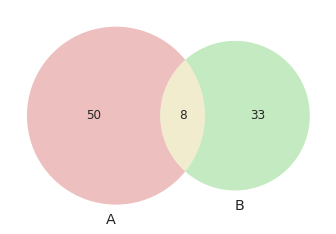

In [204]:
venn2( (set(list(x[x==1].index)), set(list(y[y==1].index))) )

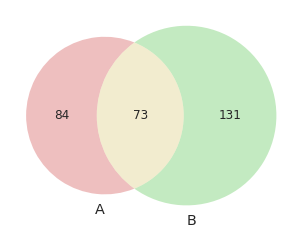

In [205]:
venn2( (set(list(x[x==-1].index)), set(list(y[y==-1].index))) )

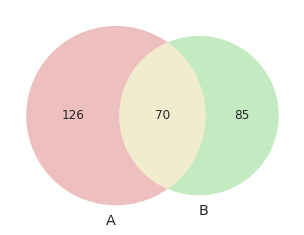

In [206]:
venn2( (set(list(x[x>0].index)), set(list(y[y>0].index))) )

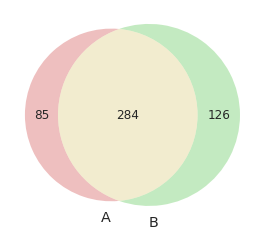

In [207]:
venn2( (set(list(x[x<0].index)), set(list(y[y<0].index))) )

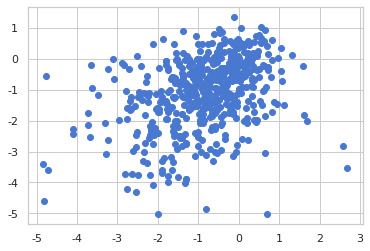

In [209]:
plt.scatter(tt['remap_cue'], tt['remap_rw'])

<AxesSubplot:xlabel='fr_uz_tau_cue_correct', ylabel='remap_cue'>

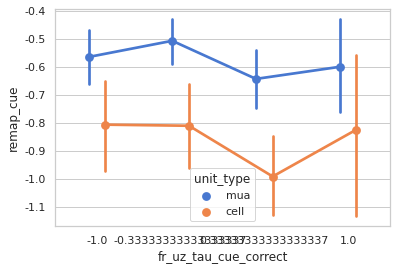

In [159]:
x = t['remap_cue']
y = t['fr_uz_tau_cue_correct']

sns.pointplot(x='fr_uz_tau_cue_correct', y='remap_cue', hue='unit_type', data=t, dodge=0.2)

In [160]:
x = 'remap_rw'
y = 'fr_uz_tau_rw_correct'

sns.pointplot(x=x, y=y, hue='unit_type', data=t, dodge=0.2)

<AxesSubplot:xlabel='remap_rw', ylabel='fr_uz_tau_rw_correct'>

Error in callback <function flush_figures at 0x7fb5c2717310> (for post_execute):



KeyboardInterrupt



In [175]:
x = 'remap_rw'
y = 'fr_uz_tau_rw_correct'
t2 = t.loc[t.unit_type=='cell']
#t2=t
ttest_ind(t2.loc[t2[y]==1, x].dropna(),t2.loc[t2[y]==-1, x].dropna() )

Ttest_indResult(statistic=0.5695434547287958, pvalue=0.5695360657555864)

In [179]:
rs.kendall(t[x], t[y])

-0.010901056294927101

In [137]:
table.loc[idx].values.astype(float)

array([[-0.61801654, -0.03753246,  1.16818734, ...,  0.76546554,
         1.        ,  0.33333333],
       [ 1.22479642,  5.20835051, -0.54161413, ..., -0.35721725,
        -0.33333333, -0.33333333],
       [ 0.3146266 , -0.15879117,  0.18053804, ...,  1.81670489,
        -0.33333333,  0.33333333],
       ...,
       [-0.02542464,  0.56709801, -0.04928641, ..., -0.61237244,
        -0.33333333, -0.33333333],
       [-0.30774443,  1.75686511, -0.24077171, ..., -1.66132477,
         0.33333333, -1.        ],
       [-0.70874474, -0.98003849,  0.68860708, ..., -0.73676142,
         0.33333333, -1.        ]])

In [140]:
tm_remap_table

,remap_cue,remap_rw,stability_tm
cl_name,,,
Li_T3g_052818-tt2_d16.5_cl11,-0.709834,-0.355809,0.492538
Li_T3g_052818-tt2_d16.5_cl14,-0.108133,0.407815,0.421864
Li_T3g_052918-tt2_d16.5_cl18,-1.291234,-1.920430,1.655246
Li_T3g_052918-tt8_d16.25_cl0,-0.572054,-1.123101,1.999858
Li_T3g_052918-tt8_d16.25_cl12,-1.309451,-3.906965,0.930531
...,...,...,...
Ca_T3g_040919-tt11_d18.5_cl8,1.007328,0.176929,0.236632
Ca_T3g_041119-tt11_d18.5_cl13,0.416993,-0.047233,0.651240
Ca_T3g_041619-tt11_d18.75_cl4,0.252286,0.429902,0.312486


In [139]:
out_df.loc[bool_table_match_idx]

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name,...,fr_uz_cue_stem,fr_uz_cue_right,fr_uz_dir_left,fr_uz_dir_stem,fr_uz_dir_right,fr_uz_rw_left,fr_uz_rw_stem,fr_uz_rw_right,fr_uz_tau_cue_correct,fr_uz_tau_rw_correct
16,Li,Li_T3g_052918,T3g,52918,0,cell,2,18,16.50,Li_T3g_052918-tt2_d16.5_cl18,...,-0.037532,1.168187,1.572674,-7.808515,-1.627569,-0.035718,0.691382,0.765466,1.0,0.333333
17,Li,Li_T3g_052918,T3g,52918,1,cell,8,0,16.25,Li_T3g_052918-tt8_d16.25_cl0,...,5.208351,-0.541614,5.166497,13.536947,7.252258,-1.523954,0.306155,-0.357217,-0.333333,-0.333333
18,Li,Li_T3g_052918,T3g,52918,2,cell,8,12,16.25,Li_T3g_052918-tt8_d16.25_cl12,...,-0.158791,0.180538,-0.645624,4.847372,-1.374924,0.839365,-3.075738,1.816705,-0.333333,0.333333
19,Li,Li_T3g_052918,T3g,52918,3,cell,8,16,16.25,Li_T3g_052918-tt8_d16.25_cl16,...,0.265614,-2.623112,-2.90305,-12.25587,-5.103441,-1.976377,-0.675162,-2.786295,-0.333333,-1.0
20,Li,Li_T3g_052918,T3g,52918,4,cell,8,17,16.25,Li_T3g_052918-tt8_d16.25_cl17,...,1.538831,0.084959,0.633584,-8.999331,-1.364286,-1.023906,0.533236,-2.592377,0.333333,-0.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4296,Ca,Ca_T3g_030719,T3g,30719,0,cell,11,9,15.50,Ca_T3g_030719-tt11_d15.5_cl9,...,-0.392005,-0.707107,0.407548,-3.693883,0.278607,-0.190826,-0.136615,-0.738549,-1.0,-1.0
4301,Ca,Ca_T3g_030819,T3g,30819,0,cell,11,15,15.75,Ca_T3g_030819-tt11_d15.75_cl15,...,0.897798,-0.997605,0.794105,-3.006047,2.185959,-2.135416,-0.176842,-0.360288,-0.333333,-1.0
4310,Ca,Ca_T3g_031219,T3g,31219,0,cell,11,2,16.25,Ca_T3g_031219-tt11_d16.25_cl2,...,0.567098,-0.049286,0.546771,-2.887377,0.470016,-2.325551,1.07907,-0.612372,-0.333333,-0.333333
4360,Ca,Ca_T3g_032119,T3g,32119,0,cell,4,14,17.00,Ca_T3g_032119-tt4_d17.0_cl14,...,1.756865,-0.240772,-6.765159,8.991293,-8.997129,-2.879084,-2.173232,-1.661325,0.333333,-1.0


In [109]:
#a = info.get_combined_scores_matched_units(overwrite=True, trial_remap_params=dict(speed_blank=True))
a = info.get_combined_scores_matched_units(overwrite=True)

In [110]:
a

Index(['match_cl_id', 'subject', 'TM-remap_cue', 'TM-remap_rw',
       'TM-stability_tm', 'TM-rate_cue', 'TM-rate_rw', 'TM-global_cue',
       'TM-global_rw', 'TM-enc_uz_cue', 'TM-enc_uz_rw', 'TM-fr_uz_cue_left',
       'TM-fr_uz_cue_stem', 'TM-fr_uz_cue_right', 'TM-fr_uz_dir_left',
       'TM-fr_uz_dir_stem', 'TM-fr_uz_dir_right', 'TM-fr_uz_rw_left',
       'TM-fr_uz_rw_stem', 'TM-fr_uz_rw_right', 'TM-fr_uz_tau_cue_correct',
       'TM-fr_uz_tau_rw_correct', 'OF-agg_sdp-map_r', 'OF-agg_sdp-r2',
       'OF-hd-agg_sdp_coef', 'OF-hd-coef', 'OF-hd-map_r', 'OF-hd-r2',
       'OF-pos-agg_sdp_coef', 'OF-pos-coef', 'OF-pos-map_r', 'OF-pos-r2',
       'OF-speed-agg_sdp_coef', 'OF-speed-coef', 'OF-speed-map_r',
       'OF-speed-r2', 'OF-metric_score_border', 'OF-metric_score_grid',
       'OF-metric_score_hd', 'OF-metric_score_speed', 'OF-metric_score_pos'],
      dtype='object')

In [74]:
a = info.get_combined_scores_matched_units(trial_remap_params=dict(speed_blank=True))
a['Cluster'] = info.get_matched_of_cell_clusters()['Cluster']

In [75]:
a.columns

Index(['match_cl_id', 'subject', 'TM-remap_cue', 'TM-remap_rw',
       'TM-stability_tm', 'TM-rate_cue', 'TM-rate_rw', 'TM-global_cue',
       'TM-global_rw', 'TM-enc_uz_cue', 'TM-enc_uz_rw', 'TM-fr_uz_cue_left',
       'TM-fr_uz_cue_stem', 'TM-fr_uz_cue_right', 'TM-fr_uz_dir_left',
       'TM-fr_uz_dir_stem', 'TM-fr_uz_dir_right', 'TM-fr_uz_rw_left',
       'TM-fr_uz_rw_stem', 'TM-fr_uz_rw_right', 'OF-agg_sdp-map_r',
       'OF-agg_sdp-r2', 'OF-hd-agg_sdp_coef', 'OF-hd-coef', 'OF-hd-map_r',
       'OF-hd-r2', 'OF-pos-agg_sdp_coef', 'OF-pos-coef', 'OF-pos-map_r',
       'OF-pos-r2', 'OF-speed-agg_sdp_coef', 'OF-speed-coef', 'OF-speed-map_r',
       'OF-speed-r2', 'OF-metric_score_border', 'OF-metric_score_grid',
       'OF-metric_score_hd', 'OF-metric_score_speed', 'OF-metric_score_pos',
       'Cluster'],
      dtype='object')

In [97]:
columns = []

for c in ['cue', 'rw']:#, 'rw', 'dir']:
    columns += [f'TM-fr_uz_{c}_{s}' for s in ['left', 'stem', 'right']]

a2 = a[columns].dropna()


In [102]:
#sns.clustermap(a2.T.corr(method='kendall'), center=0, vmax=0.5, vmin=-0.5, row_cluster=a.Cluster)
a3 = a2.corr(method='kendall')
a3

,TM-fr_uz_cue_left,TM-fr_uz_cue_stem,TM-fr_uz_cue_right,TM-fr_uz_rw_left,TM-fr_uz_rw_stem,TM-fr_uz_rw_right
TM-fr_uz_cue_left,1.000000,0.046631,-0.099773,-0.212160,-0.052815,0.011579
TM-fr_uz_cue_stem,0.046631,1.000000,-0.039551,0.004230,0.003172,0.072541
TM-fr_uz_cue_right,-0.099773,-0.039551,1.000000,-0.010099,0.094274,0.044575
TM-fr_uz_rw_left,-0.212160,0.004230,-0.010099,1.000000,0.095427,0.075235
TM-fr_uz_rw_stem,-0.052815,0.003172,0.094274,0.095427,1.000000,0.161098
TM-fr_uz_rw_right,0.011579,0.072541,0.044575,0.075235,0.161098,1.000000


In [99]:
c = sns.color_palette(palette='colorblind', n_colors=3, as_cmap=True)
cols = a.Cluster.map(lambda ii: c[ii])


In [89]:
sns.clustermap?

Signature:
sns.clustermap(
    data,
    *,
    pivot_kws=None,
    method='average',
    metric='euclidean',
    z_score=None,
    standard_scale=None,
    figsize=(10, 10),
    cbar_kws=None,
    row_cluster=True,
    col_cluster=True,
    row_linkage=None,
    col_linkage=None,
    row_colors=None,
    col_colors=None,
    mask=None,
    dendrogram_ratio=0.2,
    colors_ratio=0.03,
    cbar_pos=(0.02, 0.8, 0.05, 0.18),
    tree_kws=None,
    **kwargs,
)
Docstring:
Plot a matrix dataset as a hierarchically-clustered heatmap.

Parameters
----------
data : 2D array-like
    Rectangular data for clustering. Cannot contain NAs.
pivot_kws : dict, optional
    If `data` is a tidy dataframe, can provide keyword arguments for
    pivot to create a rectangular dataframe.
method : str, optional
    Linkage method to use for calculating clusters. See
    :func:`scipy.cluster.hierarchy.linkage` documentation for more
    information.
metric : str, optional
    Distance metric to use for the data

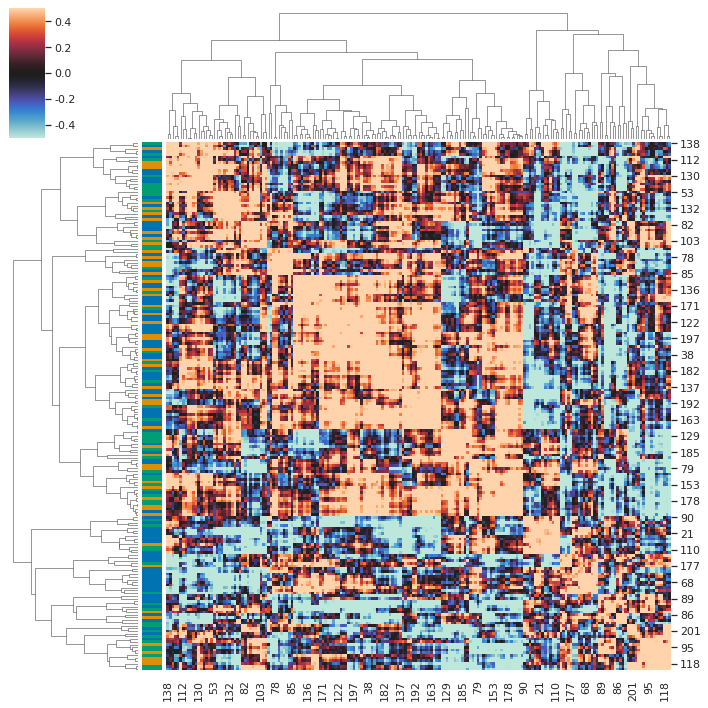

In [100]:
sns.clustermap(a3, center=0, vmax=0.5, vmin=-0.5, row_colors=cols[a3.index].values, metric='correlation')

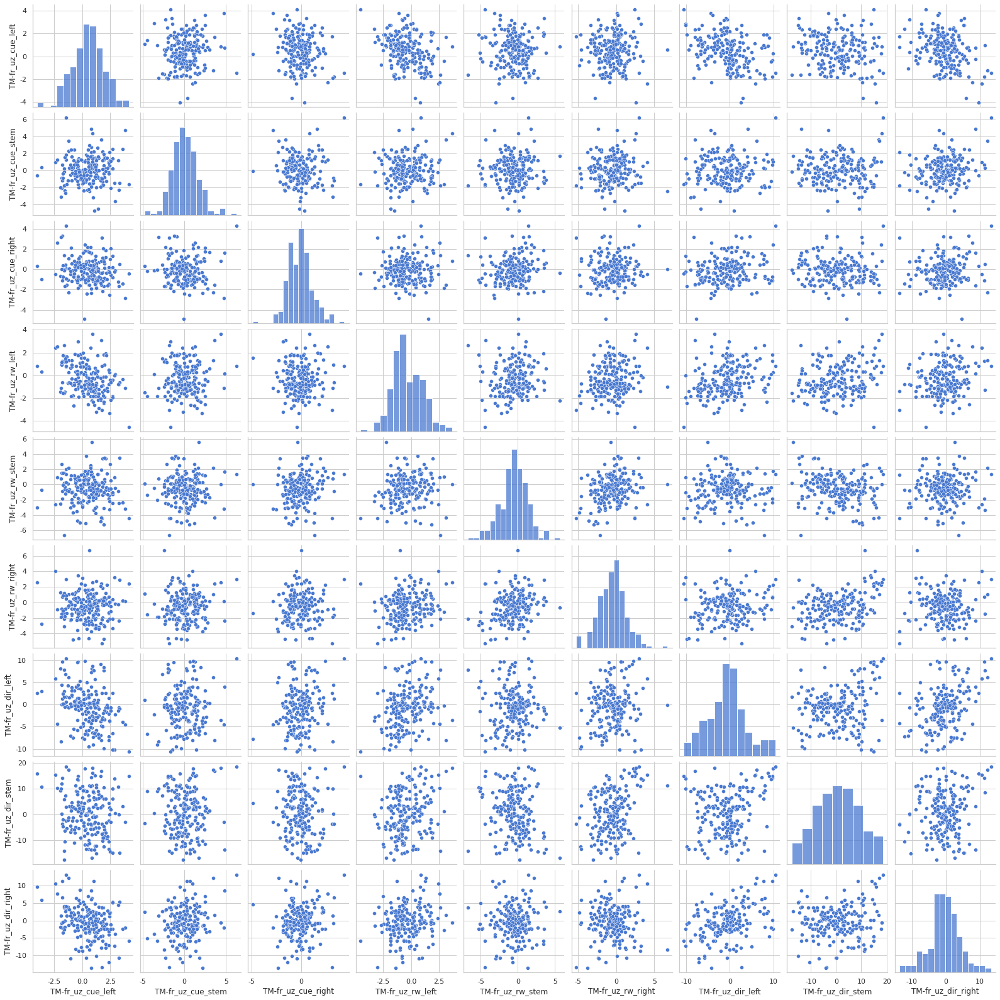

In [64]:
sns.pairplot(a2)

In [49]:
c = dict(a=1)
c.update(None)
c

TypeError: 'NoneType' object is not iterable

[(('stem', 2), ('stem', 1))] [0.04418349802989178]


(<Figure size 3000x2250 with 1 Axes>,
 <AxesSubplot:xlabel='Segment', ylabel='LC $\\leftarrow U_Z \\rightarrow$ RC'>)

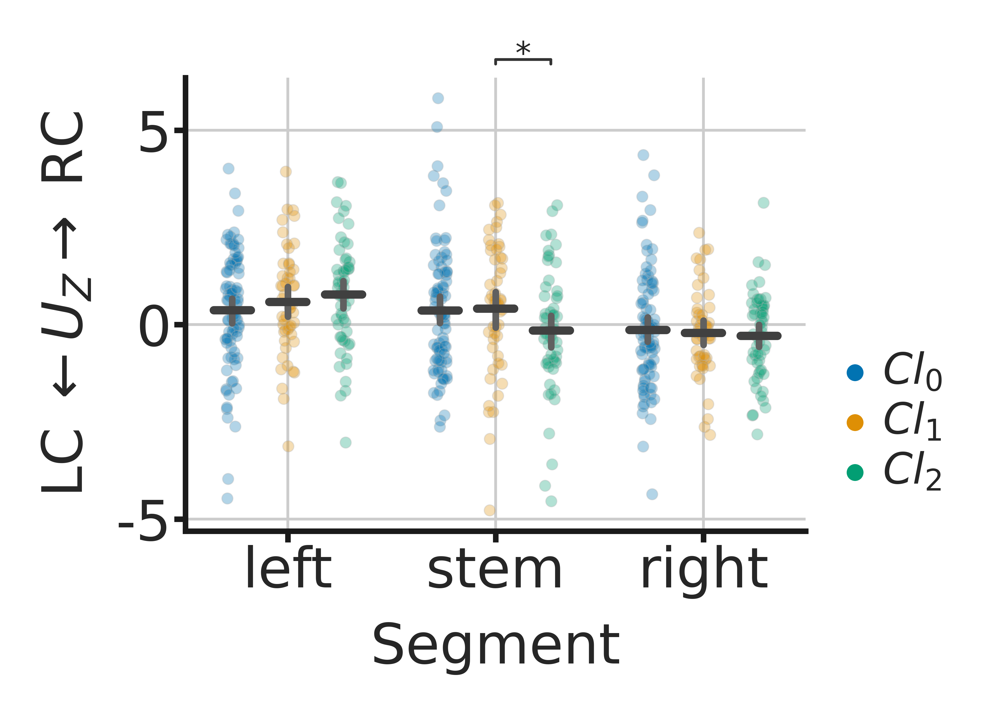

In [30]:
pf = reload(pf)
f = pf.CrossTaskFigures()
f.plot_scores_by_group(score_group='fr_cue')


In [23]:
self = f

table = None
score_group='fr_rw'
select_columns, x_vals = self.get_score_table_columns_by_group(score_group)

if 'metric' in score_group:
    y_label = "Metric Score (a.u.)"
    x_var = "var"
    x_label = ""
    x_ticklabels = ['p', 's', 'h']
elif 'of_model' in score_group:
    y_label = " Model Coef. (a.u.)"
    x_var = "var"
    x_label = ""
    x_ticklabels = ['p', 's', 'h']
elif 'remap' in score_group:
    y_label = r"$\bar{z}_{\Delta \tau}$"
    x_var = ''
    x_label = x_var
elif 'enc' in score_group:
    y_label = r"$R^2$"
    x_var = ""
    x_label = x_var
elif 'delta_enc' in score_group:
    y_label = r"$U_{\Delta R^2}$"
    x_var = "Remap"
    x_label = x_var
elif 'fr' in score_group:
    y_label = f'$U_Z$'
    x_var = 'var'
    x_label = ""
    x_ticklabels = ['left', 'stem', 'right']
else:
    raise ValueError

if table is None:
    table = self.match_scores_table[select_columns].copy()
    table['Cluster'] = self.match_of_clusters['Cluster']
    table = table.rename(columns={s1: s2 for s1, s2 in zip(select_columns, x_vals)})

In [25]:
table

,left,stem,right,Cluster
0,2.040715,-5.755994,-0.171802,0
1,1.453238,-4.577873,-3.848885,1
2,1.771543,-4.825928,-2.962975,2
3,-1.523179,-2.428119,-2.944026,2
4,NaN,NaN,NaN,0
...,...,...,...,...
212,0.904534,0.682086,-2.571429,2
213,1.981735,-0.361551,0.525105,2
214,-0.177985,0.166701,-0.841869,1
215,-2.325551,1.079070,-0.612372,1


In [63]:
pf = reload(pf)


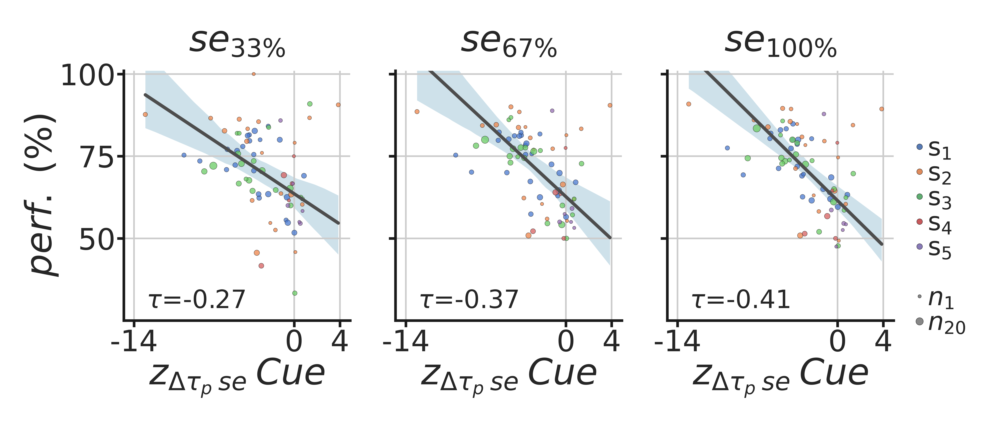

In [66]:
t = f._get_session_remap_scores_v_partitions()
table['x'] = table['r']
for ii, a in enumerate(ax):
    table['y'] = table[f"co_cp{ii+1}"]
    
    

,subject,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r,n
session,,,,,,,,,,
Li_T3g_052918,Li,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315,-3.902680,6
Li_T3g_053018,Li,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207,-3.530672,5
Li_T3g_053118,Li,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000,-3.929051,5
Li_T3g_060118,Li,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333,-4.491450,5
Li_T3g_060418,Li,T3g,0.770833,0.875000,0.812500,0.770833,0.822917,0.819444,-5.844225,6
...,...,...,...,...,...,...,...,...,...,...
Ca_T3g_030619,Ca,T3g,0.545455,0.636364,0.454545,0.545455,0.590909,0.545455,0.539025,3
Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.473684,0.550000,0.550000,0.525424,0.454038,1
Ca_T3g_030819,Ca,T3g,0.583333,0.478261,0.565217,0.583333,0.531915,0.542857,0.731701,1


In [73]:
t = f._get_session_remap_scores_v_partitions()
t = t.reset_index()
t[['session', 'subject','task','co_cp1', 'co_cp2','co_cp3','r','n']]

,session,subject,task,co_cp1,co_cp2,co_cp3,r,n
0,Li_T3g_052918,Li,T3g,0.796610,0.813559,0.848315,-3.902680,6
1,Li_T3g_053018,Li,T3g,0.755102,0.783505,0.786207,-3.530672,5
2,Li_T3g_053118,Li,T3g,0.814815,0.822430,0.800000,-3.929051,5
3,Li_T3g_060118,Li,T3g,0.779661,0.811966,0.833333,-4.491450,5
4,Li_T3g_060418,Li,T3g,0.770833,0.822917,0.819444,-5.844225,6
...,...,...,...,...,...,...,...,...
70,Ca_T3g_030619,Ca,T3g,0.545455,0.590909,0.545455,0.539025,3
71,Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.525424,0.454038,1
72,Ca_T3g_030819,Ca,T3g,0.583333,0.531915,0.542857,0.731701,1
73,Ca_T3g_031219,Ca,T3g,0.666667,0.574074,0.475000,-0.109147,1


In [80]:
tt = t.melt(id_vars=['session', 'subject', 'task','r','n'], value_vars=[f'co_cp{ii}' for ii in range(1,4)], value_name='perf', var_name='part')

In [89]:
vc_formula = {'task': f"1+C(task)"}
include_n_units=False
if include_n_units:
    re_formula = "1+n"
else:
    re_formula = "1"
full_formula = "perf ~ 1 + r:part+r"
null_formula = "perf ~ 1 + r"

m_full_ML = smf.mixedlm(formula=full_formula,
                     groups='subject', re_formula=re_formula, vc_formula=vc_formula,
                     data=tt).fit(reml=False)
m_full_ML.summary()

m_null_ML = smf.mixedlm(formula=null_formula,
                        groups='subject', re_formula=re_formula, vc_formula=vc_formula,
                        data=tt).fit(reml=False)

lrt, chi2_p = ps.LRT(m_full_ML, m_null_ML)
print(f"LRT = {lrt:0.2f}; Chi2_p={chi2_p}")
print(f"Full Model ML converged = {m_full_ML.converged}")
print(f"Null Model ML converged = {m_null_ML.converged}")

LRT = 2.22; Chi2_p=0.32881165927456313
Full Model ML converged = True
Null Model ML converged = True


In [85]:
m_full.wald_test_terms()

<class 'statsmodels.stats.contrast.WaldTestResults'>
                 chi2        P>chi2  df constraint
Intercept  156.444087  6.770575e-36              1
r            3.745730  5.294258e-02              1
r:part       2.204332  3.321508e-01              2

In [7]:
f.be_partitions

,subject,session,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3
0,Li,Li_T3g_052818,T3g,0.650000,0.800000,0.700000,0.650000,0.725000,0.716667
1,Li,Li_T3g_052918,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315
2,Li,Li_T3g_053018,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207
3,Li,Li_T3g_053118,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000
4,Li,Li_T3g_060118,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333
...,...,...,...,...,...,...,...,...,...
138,Ca,Ca_T3g_040919,T3g,0.776471,0.929412,0.788235,0.776471,0.852941,0.831373
139,Ca,Ca_T3g_041119,T3g,0.733333,0.793103,0.586207,0.733333,0.762712,0.704545
140,Ca,Ca_T3g_041619,T3g,0.625000,0.612903,0.645161,0.625000,0.619048,0.627660
141,Ca,Ca_T3g_041919,T3g,0.787879,0.741935,0.593750,0.787879,0.765625,0.708333


In [54]:
(np.array([0.5, 0.75, 1.0])*100).astype(str)

array(['50.0', '75.0', '100.0'], dtype='<U32')

In [19]:
f._get_session_remap_scores_v_partitions('pop')

,subject,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r,n
session,,,,,,,,,,
Li_T3g_052918,Li,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315,-3.902680,6
Li_T3g_053018,Li,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207,-3.530672,5
Li_T3g_053118,Li,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000,-3.929051,5
Li_T3g_060118,Li,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333,-4.491450,5
Li_T3g_060418,Li,T3g,0.770833,0.875000,0.812500,0.770833,0.822917,0.819444,-5.844225,6
...,...,...,...,...,...,...,...,...,...,...
Ca_T3g_030619,Ca,T3g,0.545455,0.636364,0.454545,0.545455,0.590909,0.545455,0.539025,3
Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.473684,0.550000,0.550000,0.525424,0.454038,1
Ca_T3g_030819,Ca,T3g,0.583333,0.478261,0.565217,0.583333,0.531915,0.542857,0.731701,1


(<Figure size 259.2x86.4 with 3 Axes>,
 array([<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>], dtype=object))

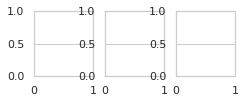

,subject,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r,n
session,,,,,,,,,,
Li_T3g_052918,Li,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315,-3.902680,6
Li_T3g_053018,Li,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207,-3.530672,5
Li_T3g_053118,Li,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000,-3.929051,5
Li_T3g_060118,Li,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333,-4.491450,5
Li_T3g_060418,Li,T3g,0.770833,0.875000,0.812500,0.770833,0.822917,0.819444,-5.844225,6
...,...,...,...,...,...,...,...,...,...,...
Ca_T3g_030619,Ca,T3g,0.545455,0.636364,0.454545,0.545455,0.590909,0.545455,0.539025,3
Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.473684,0.550000,0.550000,0.525424,0.454038,1
Ca_T3g_030819,Ca,T3g,0.583333,0.478261,0.565217,0.583333,0.531915,0.542857,0.731701,1


In [12]:
self = f
r = self.pzrc
cols = ['session', 'n_units'] + list(r.columns[8:])
r = r[cols].copy()
r = r.set_index('session')

r = r.dropna()
p = self.be_partitions.set_index('session')
t = p.loc[r.index].copy()
t['r'] = r[self.remap_score]

t

,subject,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r
session,,,,,,,,,
Li_T3g_052918,Li,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315,-3.902680
Li_T3g_053018,Li,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207,-3.530672
Li_T3g_053118,Li,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000,-3.929051
Li_T3g_060118,Li,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333,-4.491450
Li_T3g_060418,Li,T3g,0.770833,0.875000,0.812500,0.770833,0.822917,0.819444,-5.844225
...,...,...,...,...,...,...,...,...,...
Ca_T3g_030619,Ca,T3g,0.545455,0.636364,0.454545,0.545455,0.590909,0.545455,0.539025
Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.473684,0.550000,0.550000,0.525424,0.454038
Ca_T3g_030819,Ca,T3g,0.583333,0.478261,0.565217,0.583333,0.531915,0.542857,0.731701


In [15]:
self.pzrc

,subject,session,session_pct_cov,session_valid,n_session_all,n_session_cells,n_session_muas,pop_type,CR_bo-CL_bo-corr_m,CR_bo-CL_bo-corr_z,...,CR_bo-CL_bo-Even_bo-Odd_bo-corr_ztp,Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zm,Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zp,Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zt,Co_bo-Inco_bo-Even_bo-Odd_bo-corr_ztp,Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zm,Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zp,Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zt,Co_bi-Inco_bi-Even_bi-Odd_bi-corr_ztp,n_units
0,Li,Li_T3g_052818,0,0,2,0,2,cells,NaN,NaN,...,NaN,NaN,1.0,NaN,NaN,NaN,1.000000e+00,NaN,NaN,0
3,Li,Li_T3g_052918,0,0,14,6,8,cells,0.707729,1.455152,...,5.281613e-42,-5.729448,0.0,-30.469076,4.247630e-52,-8.083766,0.000000e+00,-45.138985,7.524665e-68,6
6,Li,Li_T3g_053018,0,0,9,5,4,cells,0.633611,1.219455,...,1.177765e-40,-4.309267,0.0,-29.379415,1.095308e-50,-2.411670,1.999796e-211,-19.155756,4.520735e-35,5
9,Li,Li_T3g_053118,0,0,16,5,11,cells,0.714280,1.479108,...,7.365048e-38,-5.219356,0.0,-29.741050,3.685851e-51,-5.743810,0.000000e+00,-41.263672,3.489955e-64,5
12,Li,Li_T3g_060118,0,0,14,5,9,cells,0.832564,2.025617,...,1.433644e-48,-6.128017,0.0,-31.750614,1.046189e-53,-9.927324,0.000000e+00,-55.942650,9.943107e-77,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,Ca,Ca_T3g_040919,0,0,1,0,1,cells,NaN,NaN,...,NaN,NaN,1.0,NaN,NaN,NaN,1.000000e+00,NaN,NaN,0
327,Ca,Ca_T3g_041119,0,0,1,0,1,cells,NaN,NaN,...,NaN,NaN,1.0,NaN,NaN,NaN,1.000000e+00,NaN,NaN,0
330,Ca,Ca_T3g_041619,0,0,1,0,1,cells,NaN,NaN,...,NaN,NaN,1.0,NaN,NaN,NaN,1.000000e+00,NaN,NaN,0
333,Ca,Ca_T3g_041919,0,0,1,0,1,cells,NaN,NaN,...,NaN,NaN,1.0,NaN,NaN,NaN,1.000000e+00,NaN,NaN,0


In [23]:
p = info.get_session_perf_partitions()

In [25]:
pp = p.set_index('session')

In [43]:
pr = info.get_pop_zone_rates_remap()
r = info.get_zone_rates_remap()

In [ ]:
pr.set_index('session')

Index(['subject', 'session', 'session_pct_cov', 'session_valid',
       'n_session_all', 'n_session_cells', 'n_session_muas', 'pop_type',
       'CR_bo-CL_bo-corr_m', 'CR_bo-CL_bo-corr_z', 'Co_bo-Inco_bo-corr_m',
       'Co_bo-Inco_bo-corr_z', 'Co_bi-Inco_bi-corr_m', 'Co_bi-Inco_bi-corr_z',
       'Even_bo-Odd_bo-corr_m', 'Even_bo-Odd_bo-corr_z',
       'Even_bi-Odd_bi-corr_m', 'Even_bi-Odd_bi-corr_z',
       'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm',
       'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zp',
       'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zt',
       'CR_bo-CL_bo-Even_bo-Odd_bo-corr_ztp',
       'Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zm',
       'Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zp',
       'Co_bo-Inco_bo-Even_bo-Odd_bo-corr_zt',
       'Co_bo-Inco_bo-Even_bo-Odd_bo-corr_ztp',
       'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zm',
       'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zp',
       'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zt',
       'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_ztp'],
      dtype='object')

In [92]:
def get_session_wide_remap_score(unit_type='cell', remap='pop', **trial_params):
    if remap=='pop':
        r = info.get_pop_zone_rates_remap(**trial_params)
       
        cols = ['session'] + list(r.columns[8:]) 
        if unit_type=='all':
            r = r[r.pop_type==unit_type]
            r2 = r[cols].copy()
            r2['n'] = r['n_session_all']
        else:
            r = r[r.pop_type==f"{unit_type}s"]
            r2 = r[cols].copy()
            r2['n'] = r[f'n_session_{unit_type}s']
        r = r2.set_index('session')
    else:
        r = info.get_zone_rates_remap(**trial_params)
        cols = r.columns[10:]
        if unit_type!='all':
            r = r[r.unit_type==unit_type]
        r2 = r.groupby('session').mean()
        r2 = r2[cols]
        r2['n'] = r[r.unit_type==unit_type].groupby('session')['unit_id'].count()
        r = r2
        
    return r


In [116]:
unit_type ='cell'
remap = 'pop'
#z_var = 'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm'
z_var = 'Co_bi-Inco_bi-Even_bi-Odd_bi-corr_zm'
r = get_session_wide_remap_score(unit_type=unit_type, remap=remap)
r = r.dropna()

t = pp.loc[r.index].copy()
t['r'] = r[z_var]
t.corr(method='kendall')




,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r
co_p1,1.000000,0.384448,0.438654,1.000000,0.695936,0.629924,-0.290306
co_p2,0.384448,1.000000,0.496744,0.384448,0.689182,0.672327,-0.366721
co_p3,0.438654,0.496744,1.000000,0.438654,0.563890,0.723428,-0.436339
co_cp1,1.000000,0.384448,0.438654,1.000000,0.695936,0.629924,-0.290306
co_cp2,0.695936,0.689182,0.563890,0.695936,1.000000,0.842447,-0.391273
co_cp3,0.629924,0.672327,0.723428,0.629924,0.842447,1.000000,-0.435708
r,-0.290306,-0.366721,-0.436339,-0.290306,-0.391273,-0.435708,1.000000


In [85]:
r = get_session_wide_remap_score(remap='c')

,subject,task,co_p1,co_p2,co_p3,co_cp1,co_cp2,co_cp3,r
session,,,,,,,,,
Li_T3g_052918,Li,T3g,0.796610,0.830508,0.916667,0.796610,0.813559,0.848315,-3.902680
Li_T3g_053018,Li,T3g,0.755102,0.812500,0.791667,0.755102,0.783505,0.786207,-3.530672
Li_T3g_053118,Li,T3g,0.814815,0.830189,0.754717,0.814815,0.822430,0.800000,-3.929051
Li_T3g_060118,Li,T3g,0.779661,0.844828,0.877193,0.779661,0.811966,0.833333,-4.491450
Li_T3g_060418,Li,T3g,0.770833,0.875000,0.812500,0.770833,0.822917,0.819444,-5.844225
...,...,...,...,...,...,...,...,...,...
Ca_T3g_030619,Ca,T3g,0.545455,0.636364,0.454545,0.545455,0.590909,0.545455,0.539025
Ca_T3g_030719,Ca,T3g,0.550000,0.550000,0.473684,0.550000,0.550000,0.525424,0.454038
Ca_T3g_030819,Ca,T3g,0.583333,0.478261,0.565217,0.583333,0.531915,0.542857,0.731701


<AxesSubplot:xlabel='r', ylabel='co_p1'>

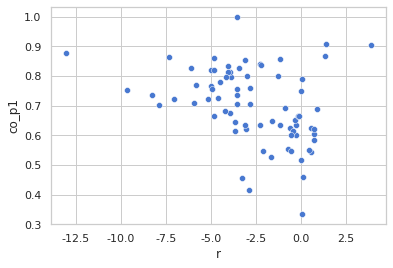

In [106]:
sns.scatterplot(data=t, x='r', y='co_p3')

In [37]:
unit_type = 'cell'
z_vars = 'CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm'


session
Al_T3g_092618     3
Al_T3g_092718    10
Al_T3g_092818     7
Al_T3g_101018     1
Al_T3g_111418     1
                 ..
NE_T3i_062918     1
NE_T3i_070218     2
NE_T3i_070518     1
NE_T3i_071018     8
Ne_T3g_060118     7
Name: unit_id, Length: 103, dtype: int64

In [62]:
si.task

'T3g'

In [3]:
o = info.select_session()

interactive(children=(Dropdown(description='subject', options=('Li', 'Ne', 'Cl', 'Al', 'Ca'), value='Li'), Dro…

In [6]:
si = o.result


In [7]:
%%time
ta = si.get_trial_analyses()

CPU times: user 20.7 s, sys: 283 ms, total: 20.9 s
Wall time: 3.4 s


In [45]:
%%time
be = si.get_event_behavior()

CPU times: user 152 ms, sys: 20.2 ms, total: 172 ms
Wall time: 170 ms


In [56]:
be = si.get_event_behavior()

trials = np.arange(be.n_trials)
a = be.trial_table
qs = np.quantile(trials, np.linspace(0, 1, n_partitions + 1))
qs[-1] += 1

d = np.digitize(trials, qs)
print([a.loc[d == ii, 'correct'].mean() for ii in range(1, n_partitions + 1)])
print([a.loc[d <= ii, 'correct'].mean() for ii in range(1, n_partitions + 1)])

[0.7708333333333334, 0.875, 0.8125]
[0.7708333333333334, 0.8229166666666666, 0.8194444444444444]


In [13]:
a = ta.trial_condition_table
a

,CL,CR,DL,DR,Co,Inco,CoCL,CoCR,IncoCL,IncoCR,Sw,CoSw,IncoSw,Even,Odd,Out,In,All
0,True,False,True,False,True,False,True,False,False,False,False,False,False,False,True,True,True,True
1,True,False,False,True,False,True,False,False,True,False,False,False,False,True,False,True,True,True
2,True,False,True,False,True,False,True,False,False,False,False,False,False,False,True,True,True,True
3,True,False,True,False,True,False,True,False,False,False,False,False,False,True,False,True,True,True
4,True,False,False,True,False,True,False,False,True,False,False,False,False,False,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140,False,True,True,False,False,True,False,False,False,True,False,False,False,False,True,True,True,True
141,False,True,False,True,True,False,False,True,False,False,False,False,False,True,False,True,True,True
142,False,True,False,True,True,False,False,True,False,False,False,False,False,False,True,True,True,True
143,False,True,True,False,False,True,False,False,False,True,False,False,False,True,False,True,True,True


In [18]:
n_partitions = 3
[a.loc[:(ta.n_trials//n_partitions*ii),'correct'].mean() for ii in range(1,n_partitions+1)]

[0.7755102040816326, 0.8144329896907216, 0.8137931034482758]

In [ ]:
n_partitions = 3
[a.loc[:(ta.n_trials//n_partitions*ii),'Co'].mean() for ii in range(1,n_partitions+1)]

[0.7708333333333334, 0.875, 0.7959183673469388]

[0.7708333333333334, 0.8229166666666666, 0.8137931034482758]

In [32]:
qs

array([  0.  ,  47.52,  95.04, 144.  ])

In [30]:
np.digitize?

Signature: np.digitize(x, bins, right=False)
Docstring:
Return the indices of the bins to which each value in input array belongs.

=========  =============  ============================
`right`    order of bins  returned index `i` satisfies
=========  =============  ============================
``False``  increasing     ``bins[i-1] <= x < bins[i]``
``True``   increasing     ``bins[i-1] < x <= bins[i]``
``False``  decreasing     ``bins[i-1] > x >= bins[i]``
``True``   decreasing     ``bins[i-1] >= x > bins[i]``
=========  =============  ============================

If values in `x` are beyond the bounds of `bins`, 0 or ``len(bins)`` is
returned as appropriate.

Parameters
----------
x : array_like
    Input array to be binned. Prior to NumPy 1.10.0, this array had to
    be 1-dimensional, but can now have any shape.
bins : array_like
    Array of bins. It has to be 1-dimensional and monotonic.
right : bool, optional
    Indicating whether the intervals include the right or the left bi

In [4]:
%%time
overwrite=False
a = info.get_segment_selective_units()
b = info.get_segment_selective_unit_rates(overwrite=overwrite)

CPU times: user 24min 41s, sys: 27 s, total: 25min 8s
Wall time: 3min 52s


In [41]:
pf = reload(pf)
f = pf.ZoneRatesFigures(info)
f.plot_segment_selective_units_out_in(save_flag=True)

In [262]:
16*3*2

96

In [260]:
f.segment_selective_unit_rates.index

Int64Index([ 0,  2,  4,  6,  8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
            34, 36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66,
            68, 70, 72, 74, 76, 78, 80, 82, 84, 86, 88, 90, 92, 94,  1,  3,  5,
             7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31, 33, 35, 37, 39,
            41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65, 67, 69, 71, 73,
            75, 77, 79, 81, 83, 85, 87, 89, 91, 93, 95],
           dtype='int64')

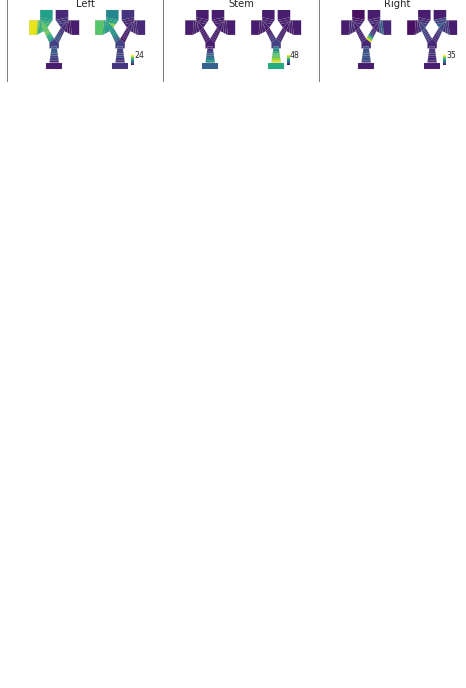

In [21]:
def example_plot(ax, fontsize=12, hide_labels=False):
    pc = ax.pcolormesh(np.random.randn(30, 30), vmin=-2.5, vmax=2.5)
    if not hide_labels:
        ax.set_xlabel('x-label', fontsize=fontsize)
        ax.set_ylabel('y-label', fontsize=fontsize)
        ax.set_title('Title', fontsize=fontsize)
    return pc

np.random.seed(19680808)
# gridspec inside gridspec
fig = plt.figure(constrained_layout=False, figsize=(6.5,9.5))
subfigs = fig.subfigures(8, 3, wspace=0.05)

tmz = tmf.TreeMazeZones()
zones = tmz.all_segs_names 
uuids = b.uuid.unique()
segments = ['left', 'stem', 'right']
for ii in range(8):
    for jj in range(3):
        uuid = a.loc[ii, segments[jj]]
        
        zr1 = b.loc[(b.uuid==uuid)&(b.ts=='out'), zones].iloc[0].astype(float)
        zr2 = b.loc[(b.uuid==uuid)&(b.ts=='in'), zones].iloc[0].astype(float)
        ax = subfigs[ii,jj].subplots(1,2)
        f.plot_2_zone_rates(zr1, zr2, ax=ax)
        subfigs[ii,jj].set_edgecolor('0.5')
        subfigs[ii,jj].set_frameon(True)
        subfigs[ii,jj].set_linewidth(1)
    break

for ii,s in enumerate(segments):
    subfigs[0,ii].suptitle(s.capitalize(), fontsize=10)
# axsLeft = subfigs[0].subplots(1, 2, sharey=True)
# subfigs[0].set_facecolor('0.75')
# for ax in axsLeft:
#     pc = example_plot(ax)
# subfigs[0].suptitle('Left plots', fontsize='x-large')
# subfigs[0].colorbar(pc, shrink=0.6, ax=axsLeft, location='bottom')

# axsRight = subfigs[1].subplots(3, 1, sharex=True)
# for nn, ax in enumerate(axsRight):
#     pc = example_plot(ax, hide_labels=True)
#     if nn == 2:
#         ax.set_xlabel('xlabel')
#     if nn == 1:b
#         ax.set_ylabel('ylabel')

# subfigs[1].set_facecolor('0.85')
# subfigs[1].colorbar(pc, shrink=0.6, ax=axsRight)
# subfigs[1].suptitle('Right plots', fontsize='x-large')

# fig.suptitle('Figure suptitle', fontsize='xx-large')

# plt.show()

In [240]:
zr1 = b.loc[(b.uuid==uuid)&(b.ts=='out'), zones]
zr1.iloc[0]

H       3.562916
a_0     2.960125
a_1     1.681232
a_2     1.510752
a_3     1.852842
a_4     3.118723
a_5     5.410538
a_6     6.910340
D       3.589380
b_0     2.145072
b_1     2.275118
b_2     3.254211
b_3     2.693626
b_4     2.184934
b_5     2.860294
i1      3.716705
c_0     7.149325
c_1     9.982703
c_2    24.419702
G1     35.159508
d_0     5.383229
d_1     4.960803
d_2     7.002666
G2      9.855385
e_0     1.081845
e_1     1.600892
e_2     2.753924
e_3     2.886829
e_4     4.462710
e_5     5.522580
i2      5.023826
f_0     4.926825
f_1     5.919783
f_2     7.609778
G3      5.662505
g_0     6.011271
g_1     1.542995
g_2     2.577510
G4      2.591652
Name: 46, dtype: float64

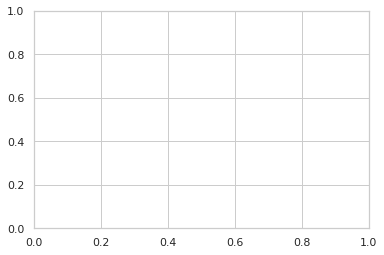

In [230]:
f.plot_2_zone_rates(b.loc[0, zones].astype(float), b.loc[1, zones].astype(float), ax=subfigs[0,0].subplots(1,2))


In [198]:
b.loc[0, zones]

H       4.070782
a_0     4.340414
a_1     6.003171
a_2      6.44576
a_3     7.181194
a_4     8.733019
a_5     7.915504
a_6     8.428471
D       6.815243
b_0     7.042979
b_1     7.049643
b_2     7.129838
b_3       6.5396
b_4     5.903597
b_5      4.38769
i1      4.478166
c_0     3.648007
c_1     3.148153
c_2     3.232937
G1      3.357278
d_0      5.33337
d_1      5.40757
d_2      5.23212
G2       4.36945
e_0    13.903007
e_1    16.110248
e_2     16.56701
e_3    19.211899
e_4    21.651045
e_5    18.965339
i2     20.399243
f_0    18.768484
f_1    17.754718
f_2    15.180813
G3     15.401985
g_0    18.455294
g_1    16.765784
g_2    19.580004
G4     24.430318
Name: 0, dtype: object

H       4.070782
a_0     4.340414
a_1     6.003171
a_2      6.44576
a_3     7.181194
a_4     8.733019
a_5     7.915504
a_6     8.428471
D       6.815243
b_0     7.042979
b_1     7.049643
b_2     7.129838
b_3       6.5396
b_4     5.903597
b_5      4.38769
i1      4.478166
c_0     3.648007
c_1     3.148153
c_2     3.232937
G1      3.357278
d_0      5.33337
d_1      5.40757
d_2      5.23212
G2       4.36945
e_0    13.903007
e_1    16.110248
e_2     16.56701
e_3    19.211899
e_4    21.651045
e_5    18.965339
i2     20.399243
f_0    18.768484
f_1    17.754718
f_2    15.180813
G3     15.401985
g_0    18.455294
g_1    16.765784
g_2    19.580004
G4     24.430318
Name: 0, dtype: object

In [184]:
zones = tmz.all_segs_names
b.uuid.value_counts()

1042    4
674     4
2002    4
225     4
1751    4
1651    2
1697    2
2873    2
134     2
1652    2
3711    2
148     2
1999    2
150     2
3787    2
3803    2
1449    2
4217    2
750     2
Name: uuid, dtype: int64

In [181]:
max(b.loc[0, zones].max(),b.loc[3, zones].max())

48.22801188823571

In [169]:
%%time
a = info.get_segment_selective_unit_rates(overwrite=True)

IndexError: index 12 is out of bounds for axis 0 with size 12

<AxesSubplot:>

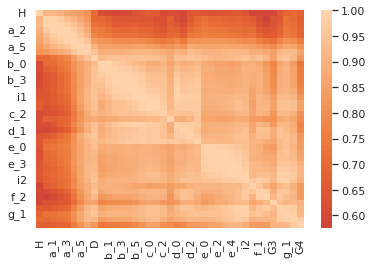

In [155]:
A = a[tmz.all_segs_names]
A = A.fillna(0)
sns.heatmap(A.corr(), center=0)

(<Figure size 144x72 with 2 Axes>,
 array([<AxesSubplot:>, <AxesSubplot:>], dtype=object))

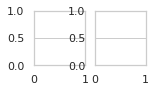

In [158]:
plt.subplots(1,2,figsize=(2,1))

In [20]:
a = info.get_bigseg_comps()
b = info.get_bigseg_cond_rates()

<AxesSubplot:ylabel='Density'>

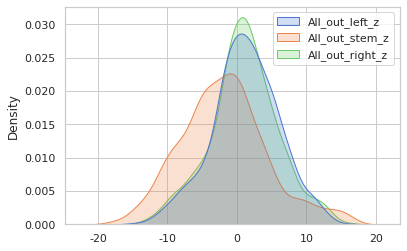

In [38]:
a = info.get_bigseg_comps()
data_columns = a.columns[6:]
segments = ['left', 'stem', 'right']
selected_columns = [f'All_out_{s}_z' for s in segments]
sns.kdeplot(data=a[selected_columns], fill=True)

/tmp/ipykernel_16107/3061111795.py:4: FutureWarning: The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.
  sns.displot(aa.lookup(ii.index,ii))


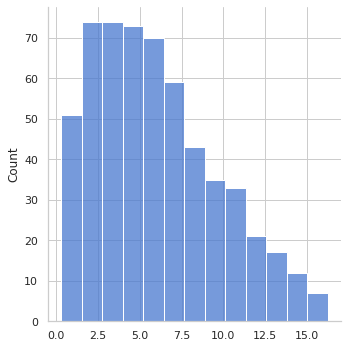

In [72]:
aa = a.loc[a.unit_type=='cell',selected_columns].rename(columns={k:v for k,v in zip(selected_columns, segments)})
aa.dropna(inplace=True)
ii = aa.idxmax(axis='columns')
sns.displot(aa.lookup(ii.index,ii))

<AxesSubplot:ylabel='count'>

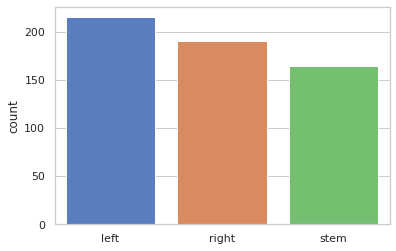

In [76]:
sns.countplot(x=ii)

In [108]:
%%time
df = info.get_bigseg_comps()
data_columns = df.columns[6:]
maze_segments = ['left', 'stem', 'right']
trial_segments = ['out','in']
unit_types = ['cell']
n_units = 4

top_selective_units = pd.DataFrame(index=range(n_units*2),columns=['ts', 'rank']+segments)

cnt = 0 

for ts in trial_segments:
    block_idx = np.arange(n_units)+cnt
    
    top_selective_units.loc[block_idx, 'ts'] = ts
    top_selective_units.loc[block_idx, 'rank'] = np.arange(n_units)+1
    
    selected_columns = [f'All_{ts}_{s}_z' for s in segments]
    aa = df.loc[df.unit_type.isin(unit_types),selected_columns].rename(columns={k:v for k,v in zip(selected_columns, segments)})
    for ss in segments:
        top_selective_units.loc[block_idx, ss] = aa.sort_values(ss,ascending=False).index[:n_units].values
    cnt +=n_units

top_selective_units


CPU times: user 31.9 ms, sys: 73 µs, total: 32 ms
Wall time: 30.6 ms


,ts,rank,left,stem,right
0,out,1,1042,150,4217
1,out,2,1449,3803,674
2,out,3,2002,3787,225
3,out,4,148,1751,1999
4,in,1,1042,1751,674
5,in,2,2002,1651,225
6,in,3,3711,1652,134
7,in,4,2873,1697,750


In [122]:
n_total_units = n_units*len(trial_segments)*len(maze_segments)
selected_units_ids = np.zeros(n_total_units, dtype=int)
cnt = 0
for ts in trial_segments:
    for r in range(1,1+n_units):
        for s in maze_segments:
            idx = top_selective_units.loc[(top_selective_units['ts']==ts) 
                                          & (top_selective_units['rank']==r), s].values[0]
            selected_units_ids[cnt] = idx
            print(df.loc[idx,['session', 'suid']])
            cnt+=1

session    Li_T3g_070618
suid                   5
Name: 1042, dtype: object
session    Li_T3g_060118
suid                   3
Name: 150, dtype: object
session    Al_T3g_111418
suid                   0
Name: 4217, dtype: object
session    NE_T3g_053118
suid                   0
Name: 1449, dtype: object
session    Cl_T3g_013019
suid                   2
Name: 3803, dtype: object
session    Li_T3g_062018
suid                   4
Name: 674, dtype: object
session    NE_T3i_071018
suid                   5
Name: 2002, dtype: object
session    Cl_T3g_012919
suid                   2
Name: 3787, dtype: object
session    Li_T3i_060518
suid                   3
Name: 225, dtype: object
session    Li_T3g_060118
suid                   1
Name: 148, dtype: object
session    NE_T3g_061418
suid                   0
Name: 1751, dtype: object
session    NE_T3i_071018
suid                   2
Name: 1999, dtype: object
session    Li_T3g_070618
suid                   5
Name: 1042, dtype: object
session    NE_T3

In [123]:
selected_units_ids

array([1042,  150, 4217, 1449, 3803,  674, 2002, 3787,  225,  148, 1751,
       1999, 1042, 1751,  674, 2002, 1651,  225, 3711, 1652,  134, 2873,
       1697,  750])

In [118]:
session, suid = df.loc[idx,['session', 'suid']]
session, suid

('Li_T3g_062618', 4)

In [110]:
si = info.get_session('Li_T3g_070618')
ta = tmf.TrialAnalyses(si)

In [116]:
tmz = tmf.TreeMazeZones()

zone_data = pd.DataFrame(index=selected_units_ids*len(trial_segments), ['ts'] + tmz.all_segs_names),
            
for unit in selected_units_ids:
    session, suid = df.loc[unit,['session', 'suid']]
    si = info.get_session(session)
    
    ta = tmf.TrialAnalyses(si)
    for ts in ['out', 'in']:
        zone_data.loc[unit] = ta.get_avg_trial_zone_rates(trial_seg=ts).loc[suid]
    
    

['H',
 'a_0',
 'a_1',
 'a_2',
 'a_3',
 'a_4',
 'a_5',
 'a_6',
 'D',
 'b_0',
 'b_1',
 'b_2',
 'b_3',
 'b_4',
 'b_5',
 'i1',
 'c_0',
 'c_1',
 'c_2',
 'G1',
 'd_0',
 'd_1',
 'd_2',
 'G2',
 'e_0',
 'e_1',
 'e_2',
 'e_3',
 'e_4',
 'e_5',
 'i2',
 'f_0',
 'f_1',
 'f_2',
 'G3',
 'g_0',
 'g_1',
 'g_2',
 'G4']

In [129]:
x = ta.get_avg_trial_zone_rates(trial_seg='out').loc[5]
x.values

array([ 4.0707818 ,  4.34041415,  6.00317105,  6.44576034,  7.18119375,
        8.73301857,  7.91550362,  8.42847089,  6.81524282,  7.04297878,
        7.04964266,  7.1298377 ,  6.53959956,  5.90359683,  4.38768978,
        4.47816639,  3.64800737,  3.14815303,  3.23293701,  3.35727777,
        5.33337013,  5.40757032,  5.23212011,  4.36945003, 13.90300666,
       16.11024771, 16.56700985, 19.21189868, 21.651045  , 18.96533888,
       20.39924347, 18.76848355, 17.75471779, 15.18081273, 15.40198497,
       18.45529379, 16.76578428, 19.58000359, 24.43031811])

In [104]:
maze_segments[0]

'left'

In [97]:
ts='out'
r=1
s='left'

1042

In [91]:
top_selective_units.query?

Signature: top_selective_units.query(expr: 'str', inplace: 'bool' = False, **kwargs)
Docstring:
Query the columns of a DataFrame with a boolean expression.

Parameters
----------
expr : str
    The query string to evaluate.

    You can refer to variables
    in the environment by prefixing them with an '@' character like
    ``@a + b``.

    You can refer to column names that are not valid Python variable names
    by surrounding them in backticks. Thus, column names containing spaces
    or punctuations (besides underscores) or starting with digits must be
    surrounded by backticks. (For example, a column named "Area (cm^2)" would
    be referenced as ```Area (cm^2)```). Column names which are Python keywords
    (like "list", "for", "import", etc) cannot be used.

    For example, if one of your columns is called ``a a`` and you want
    to sum it with ``b``, your query should be ```a a` + b``.

    .. versionadded:: 0.25.0
        Backtick quoting introduced.

    .. versionadded

In [78]:
aa.sort_values('left',ascending=False).index[:10].values

array([1042, 1449, 2002,  148, 1078, 3786,  147, 1134,  801,  498])

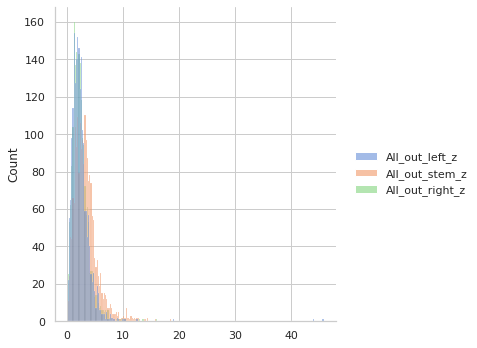

In [30]:
sns.displot(b[selected_columns])

In [9]:
%%time
info.update_paths()

CPU times: user 218 ms, sys: 11.9 ms, total: 230 ms
Wall time: 232 ms


In [10]:
si = info.get_session('Li_T3g_052918')

In [10]:
plt.subplots()

In [11]:
a = si.get_bigseg_comps()

<AxesSubplot:>

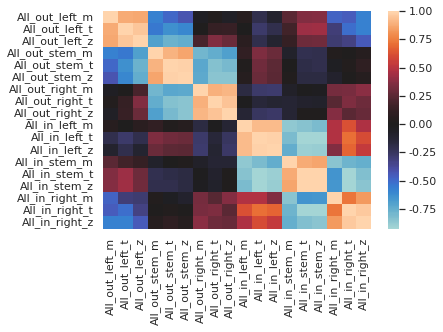

In [14]:
sns.heatmap(a.corr(), center=0)

In [125]:
%%time 
a = info.get_bigseg_cond_rates()
b = info.get_segment_rate_comps()

CPU times: user 67.4 ms, sys: 0 ns, total: 67.4 ms
Wall time: 66.3 ms


In [133]:
b

,session_unit_id,segment,t_val,uz_val,comp,subject,session,session_pct_cov,unit_type,tt,tt_cl,cl_name,task,unit_id
0,0,left,0.376219,0.555556,cue,Li,Li_T3g_052818,NaN,mua,2,11,Li_T3g_052818-tt2_d16.5_cl11,T3g,0
1,1,left,0.071601,0.444444,cue,Li,Li_T3g_052818,NaN,mua,2,14,Li_T3g_052818-tt2_d16.5_cl14,T3g,1
2,0,stem,-1.954606,-1.742427,cue,Li,Li_T3g_052818,NaN,mua,2,11,Li_T3g_052818-tt2_d16.5_cl11,T3g,0
3,1,stem,-1.457019,-1.350381,cue,Li,Li_T3g_052818,NaN,mua,2,14,Li_T3g_052818-tt2_d16.5_cl14,T3g,1
4,0,right,0.272000,-0.136626,cue,Li,Li_T3g_052818,NaN,mua,2,11,Li_T3g_052818-tt2_d16.5_cl11,T3g,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17527,0,stem,1.940023,2.025145,rw,Ca,Ca_T3g_042319,NaN,mua,11,10,Ca_T3g_042319-tt11_d19.75_cl10,T3g,1947
17528,0,right,-0.874881,0.000000,rw,Ca,Ca_T3g_042319,NaN,mua,11,10,Ca_T3g_042319-tt11_d19.75_cl10,T3g,1947
17529,0,left,2.313544,2.292170,dir,Ca,Ca_T3g_042319,NaN,mua,11,10,Ca_T3g_042319-tt11_d19.75_cl10,T3g,1947
17530,0,stem,-6.169414,-5.551174,dir,Ca,Ca_T3g_042319,NaN,mua,11,10,Ca_T3g_042319-tt11_d19.75_cl10,T3g,1947


In [135]:
ta = tmf.TrialAnalyses(si)

In [146]:
tmf = reload(tmf)
md = tmf.mean_segment_rates_diff_analysis(si, ta)
md

,All_out_left_m,All_out_left_t,All_out_left_z,All_out_stem_m,All_out_stem_t,All_out_stem_z,All_out_right_m,All_out_right_t,All_out_right_z,All_in_left_m,All_in_left_t,All_in_left_z,All_in_stem_m,All_in_stem_t,All_in_stem_z,All_in_right_m,All_in_right_t,All_in_right_z
0,2.556318,5.247238,4.465350,-1.539187,-3.620351,-3.195227,-0.433809,-0.881373,-0.714865,-2.288037,-3.153451,-2.622821,3.375470,5.575180,4.969163,-2.184157,-3.085742,-3.089782
1,-0.116769,-0.286660,3.672719,-4.098580,-14.991503,-14.638081,5.421664,19.725874,13.083180,0.918232,3.548404,4.897885,-2.433533,-13.089423,-11.806346,2.269853,9.995352,8.641459
2,1.447007,2.960991,2.884821,-2.764740,-6.955269,-6.068855,2.207924,4.720320,4.096637,2.195165,3.578692,4.206467,-4.611667,-9.663692,-9.251695,3.868896,6.746993,6.412455
3,1.001956,1.956249,0.842909,-1.377561,-3.168157,-2.744482,0.833232,1.666768,2.302557,-3.704418,-5.246337,-5.736251,3.574189,5.960583,6.171647,-1.094373,-1.537181,-1.420741
4,4.002365,7.367557,6.636212,-4.229788,-9.477858,-9.015413,1.678961,2.991701,3.794549,-0.076119,-0.112645,0.153388,0.386419,0.666918,0.522885,-0.426673,-0.647976,-0.743763
5,2.649649,4.141020,5.366819,-8.106037,-22.398957,-15.300525,7.986549,16.676515,12.186140,-1.284010,-3.106158,-3.346439,-0.337168,-0.939347,-0.958873,1.656009,4.150752,4.352409
6,0.716407,4.798553,3.502954,-0.341539,-2.614491,-2.023796,-0.237956,-1.590760,-1.110347,0.451969,3.042194,3.483435,-0.531738,-4.219714,-4.475411,0.257058,1.759780,1.689591
7,-0.421848,-1.650354,-1.976253,-0.252554,-1.151749,-0.814887,0.727955,2.946090,2.853695,1.172151,3.363968,3.452991,-1.539255,-5.261124,-5.260492,0.873584,2.554787,2.611446
8,1.455566,3.276337,2.545291,-0.998629,-2.611367,-2.150916,-0.088648,-0.201744,-0.032284,5.769775,8.048438,8.237298,-8.305215,-16.454667,-13.125362,5.240809,7.410569,6.884513
9,-1.902537,-4.629936,-4.027629,-0.729139,-2.024515,-2.183329,2.751980,7.133135,6.410724,3.347653,6.137555,6.438792,-5.490479,-13.805606,-11.571274,3.908260,7.521882,6.871955


In [136]:
si = info.get_session('Li_T3g_052918')
c = si.get_bigseg_cond_rates()


conds = ['All']
trial_segs = ['out', 'in']
segs = ['left', 'stem', 'right']

cols = []
for c in conds:
    for ts in trial_segs:
        for s in segs:
            cols += [f'{c}_{ts}_{s}_m', f'{c}_{ts}_{s}_z', f'{c}_{ts}_{s}_n']

df = pd.DataFrame(index=range(ta.n_units), columns=cols)
for c in conds:
    cond_trials = ta.get_condition_trials(condition=c)
    for ts in trial_segs:
        cond_rates = ta.get_trial_segment_rates(trials=cond_trials, segment_type='bigseg', trial_seg=ts)
        for unit in range(ta.n_units):
            m = cond_rates[unit].mean()
            n = (~cond_rates[unit].isna()).sum()


In [145]:
s = 'left'
s2 = np.setdiff1d(segs,s)

def diff_stats(x,y):
    x = x[~np.isnan(x)]
    y = y[~np.isnan(y)]
    
    md = x.mean()- y.mean()
    t = ttest_ind(x,y)[0]
    z = rs.mannwhitney_z(x,y)[0]

    return md, t, z

x = cond_rates[unit][s].values
y = cond_rates[unit][s2].values.flatten()

diff_stats(x,y)

(-3.3584668091972896, -2.064855974528649, -4.800699805121846)

In [128]:
d = tmf.mean_segment_rates_analysis(si)

In [130]:
d = si.get_bal_conds_seg_rates()
d

,CR_bo-left-m,CR_bo-left-n,CL_bo-left-m,CL_bo-left-n,Co_bo-left-m,Co_bo-left-n,Inco_bo-left-m,Inco_bo-left-n,Co_bi-left-m,Co_bi-left-n,...,CR_bo-CL_bo-right-t,CR_bo-CL_bo-right-p,Co_bo-Inco_bo-right-t,Co_bo-Inco_bo-right-p,Co_bi-Inco_bi-right-t,Co_bi-Inco_bi-right-p,Even_bo-Odd_bo-right-t,Even_bo-Odd_bo-right-p,Even_bi-Odd_bi-right-t,Even_bi-Odd_bi-right-p
0,20.855414,47.19,19.560894,45.72,19.168810,76.85,21.198280,14.97,19.850765,77.74,...,3.511225,0.000000e+00,2.040138,0.000000e+00,-0.124900,4.654608e-02,-0.874340,1.763847e-05,0.075705,4.838793e-01
1,3.450191,47.19,3.244984,45.72,3.374506,76.85,3.348075,14.97,1.917820,77.74,...,-1.644632,0.000000e+00,-1.096203,5.551115e-16,-0.458931,4.582069e-01,-0.113275,6.371360e-01,0.332199,2.372038e-01
2,7.658376,47.19,7.411614,45.72,7.772300,76.85,7.177412,14.97,7.931414,77.74,...,0.154926,3.128574e-01,0.023711,9.193860e-04,2.113693,0.000000e+00,-1.237119,1.105560e-12,-1.537541,0.000000e+00
3,18.496911,47.19,19.927784,45.72,20.260605,76.85,18.290363,14.97,19.296302,77.74,...,-3.692054,0.000000e+00,-2.420886,0.000000e+00,-2.084773,0.000000e+00,1.358192,0.000000e+00,-0.002903,5.433053e-01
4,15.826058,47.19,18.297178,45.72,18.356957,76.85,15.663204,14.97,16.932577,77.74,...,0.754585,3.461188e-05,0.412460,1.534445e-02,-2.748120,0.000000e+00,-1.009437,7.016605e-09,-1.535661,0.000000e+00
5,12.805358,47.19,13.007815,45.72,13.456589,76.85,12.231029,14.97,10.204883,77.74,...,-2.261640,0.000000e+00,-1.620148,0.000000e+00,-0.601450,7.008349e-11,-0.126783,6.345100e-01,1.061669,1.732652e-08
6,4.524132,47.19,3.751116,45.72,3.621869,76.85,4.609814,14.97,2.257208,77.74,...,1.897172,0.000000e+00,1.516435,0.000000e+00,1.621044,0.000000e+00,0.303345,3.486410e-01,0.248897,6.265073e-02
7,6.270616,47.19,7.758209,45.72,7.656626,76.85,6.455844,14.97,8.688353,77.74,...,-2.061887,0.000000e+00,-1.524019,0.000000e+00,-6.244397,0.000000e+00,2.242993,0.000000e+00,-0.662635,1.331715e-01
8,24.427358,47.19,21.707293,45.72,21.993490,76.85,24.097322,14.97,22.359859,77.74,...,-2.460437,0.000000e+00,-1.600016,0.000000e+00,-1.940626,0.000000e+00,-0.784222,5.022208e-04,1.362229,0.000000e+00
9,10.002885,47.19,9.567948,45.72,9.656975,76.85,9.912166,14.97,14.792112,77.74,...,-1.585190,0.000000e+00,-1.286379,0.000000e+00,0.485160,1.300095e-02,-0.214574,3.425921e-01,-1.483791,0.000000e+00


In [132]:
d.columns

Index(['CR_bo-left-m', 'CR_bo-left-n', 'CL_bo-left-m', 'CL_bo-left-n',
       'Co_bo-left-m', 'Co_bo-left-n', 'Inco_bo-left-m', 'Inco_bo-left-n',
       'Co_bi-left-m', 'Co_bi-left-n', 'Inco_bi-left-m', 'Inco_bi-left-n',
       'Even_bo-left-m', 'Even_bo-left-n', 'Odd_bo-left-m', 'Odd_bo-left-n',
       'Even_bi-left-m', 'Even_bi-left-n', 'Odd_bi-left-m', 'Odd_bi-left-n',
       'CR_bo-stem-m', 'CR_bo-stem-n', 'CL_bo-stem-m', 'CL_bo-stem-n',
       'Co_bo-stem-m', 'Co_bo-stem-n', 'Inco_bo-stem-m', 'Inco_bo-stem-n',
       'Co_bi-stem-m', 'Co_bi-stem-n', 'Inco_bi-stem-m', 'Inco_bi-stem-n',
       'Even_bo-stem-m', 'Even_bo-stem-n', 'Odd_bo-stem-m', 'Odd_bo-stem-n',
       'Even_bi-stem-m', 'Even_bi-stem-n', 'Odd_bi-stem-m', 'Odd_bi-stem-n',
       'CR_bo-right-m', 'CR_bo-right-n', 'CL_bo-right-m', 'CL_bo-right-n',
       'Co_bo-right-m', 'Co_bo-right-n', 'Inco_bo-right-m', 'Inco_bo-right-n',
       'Co_bi-right-m', 'Co_bi-right-n', 'Inco_bi-right-m', 'Inco_bi-right-n',
       'Even_bo-r

In [131]:
a.columns

Index(['subject', 'session', 'task', 'suid', 'unit_type', 'cl_name',
       'CR_out_left_m', 'CR_out_left_z', 'CR_out_left_n', 'CR_out_stem_m',
       'CR_out_stem_z', 'CR_out_stem_n', 'CR_out_right_m', 'CR_out_right_z',
       'CR_out_right_n', 'CR_in_left_m', 'CR_in_left_z', 'CR_in_left_n',
       'CR_in_stem_m', 'CR_in_stem_z', 'CR_in_stem_n', 'CR_in_right_m',
       'CR_in_right_z', 'CR_in_right_n', 'CL_out_left_m', 'CL_out_left_z',
       'CL_out_left_n', 'CL_out_stem_m', 'CL_out_stem_z', 'CL_out_stem_n',
       'CL_out_right_m', 'CL_out_right_z', 'CL_out_right_n', 'CL_in_left_m',
       'CL_in_left_z', 'CL_in_left_n', 'CL_in_stem_m', 'CL_in_stem_z',
       'CL_in_stem_n', 'CL_in_right_m', 'CL_in_right_z', 'CL_in_right_n',
       'Co_out_left_m', 'Co_out_left_z', 'Co_out_left_n', 'Co_out_stem_m',
       'Co_out_stem_z', 'Co_out_stem_n', 'Co_out_right_m', 'Co_out_right_z',
       'Co_out_right_n', 'Co_in_left_m', 'Co_in_left_z', 'Co_in_left_n',
       'Co_in_stem_m', 'Co_in_stem_z'

In [109]:
%%time
template_df = info.get_data_template_df(overwrite=True)
template_df

CPU times: user 19.9 s, sys: 139 ms, total: 20 s
Wall time: 21 s


,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
0,Li,Li_T3g_052818,T3g,052818,0,mua,2,11,16.5,Li_T3g_052818-tt2_d16.5_cl11
1,Li,Li_T3g_052818,T3g,052818,1,mua,2,14,16.5,Li_T3g_052818-tt2_d16.5_cl14
2,Li,Li_OF_052818,OF,052818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8
3,Li,Li_OF_052818,OF,052818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4
4,Li,Li_OF_052818,OF,052818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18
...,...,...,...,...,...,...,...,...,...,...
4381,Ca,Ca_T3g_041119,T3g,041119,0,mua,11,13,18.5,Ca_T3g_041119-tt11_d18.5_cl13
4382,Ca,Ca_T3g_041619,T3g,041619,0,mua,11,4,18.75,Ca_T3g_041619-tt11_d18.75_cl4
4383,Ca,Ca_T3g_041919,T3g,041919,0,mua,11,13,19.25,Ca_T3g_041919-tt11_d19.25_cl13


In [120]:
%%time
out_df = template_df.copy()
out_df = out_df.loc[out_df.task!='OF', ['subject', 'session','task','suid','unit_type','cl_name']]

data_columns = info.get_session('Li_T3g_052918').get_bigseg_cond_rates().columns
out_df[new_columns]=np.nan

for s in info.subjects:
    sessions = out_df.loc[out_df.subject==s, 'session']
    for se in sessions:
        si = info.get_session(se)
        n_se_units = si.n_units
        
        idx = out_df.session==se
        assert idx.sum()==n_se_units
        
        try:
            se_data = si.get_bigseg_cond_rates()
            out_df.loc[idx, data_columns]=se_data.values
        except:
            pass

/home/alexgonzalez/Documents/TreeMazeAnalyses2/Analyses/tree_maze_functions.py:5490: RuntimeWarning: invalid value encountered in double_scalars
  z = m[s] / sd


CPU times: user 14min 34s, sys: 12.5 s, total: 14min 46s
Wall time: 6min 1s


In [119]:
se

'Li_T3i_061218_0001'

In [117]:
out_df.loc[idx, new_columns]=a.values
out_df.loc[idx,new_columns]

,CR_out_left_m,CR_out_left_z,CR_out_left_n,CR_out_stem_m,CR_out_stem_z,CR_out_stem_n,CR_out_right_m,CR_out_right_z,CR_out_right_n,CR_in_left_m,...,All_out_right_n,All_in_left_m,All_in_left_z,All_in_left_n,All_in_stem_m,All_in_stem_z,All_in_stem_n,All_in_right_m,All_in_right_z,All_in_right_n
uuid,,,,,,,,,,,,,,,,,,,,,
16,20.077061,2.310343,15.0,17.605263,5.496994,93.0,18.281587,5.290552,80.0,20.001351,...,94.0,18.670666,2.811640,88.0,22.108879,3.653144,179.0,18.791529,4.576831,95.0
17,3.490047,2.981310,15.0,1.518077,1.862171,93.0,7.182253,1.957701,80.0,4.015603,...,94.0,2.012541,0.923191,88.0,0.087315,0.299656,179.0,2.991700,1.134540,95.0
18,8.062416,1.825526,15.0,5.187581,1.673064,93.0,8.215850,1.871336,80.0,8.026352,...,94.0,8.114207,1.955688,88.0,4.121361,0.911172,179.0,9.306252,1.917365,95.0
19,20.636512,2.581271,15.0,18.009178,5.285528,93.0,18.738570,4.418670,80.0,22.356215,...,94.0,21.231998,4.336885,88.0,25.842736,4.265842,179.0,23.228718,4.172530,95.0
20,16.398524,2.448753,15.0,13.097429,4.985761,93.0,16.240731,3.568362,80.0,18.088474,...,94.0,17.777369,4.129507,88.0,18.030329,2.884553,179.0,17.520284,3.491914,95.0
21,14.784006,2.432295,15.0,6.595405,4.557950,93.0,16.338992,4.244933,80.0,11.838003,...,94.0,11.088711,3.536435,88.0,11.890138,3.458094,179.0,13.282006,4.036969,95.0
22,3.813520,1.371566,15.0,2.726654,3.014115,93.0,2.801279,2.541234,80.0,2.608038,...,94.0,2.486193,2.304567,88.0,1.875288,1.549964,179.0,2.333693,1.820870,95.0
23,5.964289,2.413630,15.0,7.655545,4.742378,93.0,8.179725,3.499534,80.0,9.135169,...,94.0,9.321419,3.389230,88.0,7.656079,2.584844,179.0,9.078539,3.699463,95.0
24,25.037847,5.079807,15.0,21.084353,7.927789,93.0,20.928532,4.442358,80.0,25.620233,...,94.0,23.266725,5.578170,88.0,14.701054,3.408150,179.0,22.765006,3.751225,95.0


In [82]:
si = info.get_session('Li_T3g_052918')
a = si.get_bigseg_cond_rates()
a

,CR_out_left_m,CR_out_left_z,CR_out_left_n,CR_out_stem_m,CR_out_stem_z,CR_out_stem_n,CR_out_right_m,CR_out_right_z,CR_out_right_n,CR_in_left_m,...,All_out_right_n,All_in_left_m,All_in_left_z,All_in_left_n,All_in_stem_m,All_in_stem_z,All_in_stem_n,All_in_right_m,All_in_right_z,All_in_right_n
0,20.077061,2.310343,15.0,17.605263,5.496994,93.0,18.281587,5.290552,80.0,20.001351,...,94.0,18.670666,2.811640,88.0,22.108879,3.653144,179.0,18.791529,4.576831,95.0
1,3.490047,2.981310,15.0,1.518077,1.862171,93.0,7.182253,1.957701,80.0,4.015603,...,94.0,2.012541,0.923191,88.0,0.087315,0.299656,179.0,2.991700,1.134540,95.0
2,8.062416,1.825526,15.0,5.187581,1.673064,93.0,8.215850,1.871336,80.0,8.026352,...,94.0,8.114207,1.955688,88.0,4.121361,0.911172,179.0,9.306252,1.917365,95.0
3,20.636512,2.581271,15.0,18.009178,5.285528,93.0,18.738570,4.418670,80.0,22.356215,...,94.0,21.231998,4.336885,88.0,25.842736,4.265842,179.0,23.228718,4.172530,95.0
4,16.398524,2.448753,15.0,13.097429,4.985761,93.0,16.240731,3.568362,80.0,18.088474,...,94.0,17.777369,4.129507,88.0,18.030329,2.884553,179.0,17.520284,3.491914,95.0
5,14.784006,2.432295,15.0,6.595405,4.557950,93.0,16.338992,4.244933,80.0,11.838003,...,94.0,11.088711,3.536435,88.0,11.890138,3.458094,179.0,13.282006,4.036969,95.0
6,3.813520,1.371566,15.0,2.726654,3.014115,93.0,2.801279,2.541234,80.0,2.608038,...,94.0,2.486193,2.304567,88.0,1.875288,1.549964,179.0,2.333693,1.820870,95.0
7,5.964289,2.413630,15.0,7.655545,4.742378,93.0,8.179725,3.499534,80.0,9.135169,...,94.0,9.321419,3.389230,88.0,7.656079,2.584844,179.0,9.078539,3.699463,95.0
8,25.037847,5.079807,15.0,21.084353,7.927789,93.0,20.928532,4.442358,80.0,25.620233,...,94.0,23.266725,5.578170,88.0,14.701054,3.408150,179.0,22.765006,3.751225,95.0
9,11.057650,2.541678,15.0,11.365392,3.934007,93.0,13.422407,4.075585,80.0,15.348656,...,94.0,15.385290,4.396784,88.0,10.075857,2.832809,179.0,15.734042,3.566322,95.0


In [18]:
si.date

'052918'

In [78]:

template_columns = ['subject','session', 'task', 'date', 'suid', 'unit_type','tt', 'cl', 'depth', 'cl_name']
template_df = pd.DataFrame(index=pd.Series(name='uuid'), columns=template_columns)
out_df = template_df.copy()

uuid_cnt = 0
for s in info.subjects:
    suid_cnt = 0
    for se in info.sessions_by_subject['Li']:
        si = info.get_session(se)
        n_se_units = si.n_units
        
        se_df = pd.DataFrame(index=pd.Series(np.arange(n_se_units)+uuid_cnt, name='uuid'), columns=template_columns)
        se_df[['subject', 'session', 'task', 'date']] = s, se, si.task, si.date
        se_df['suid'] = np.arange(n_se_units)
        
        se_df['unit_type'] = se_df['suid'].map(si.unit_type_map)
        
        f_tt = lambda suid: si.cluster_ids[str(suid)][1]
        f_cl = lambda suid: si.cluster_ids[str(suid)][2]

        se_df['tt'] = se_df['suid'].map(f_tt).astype(int)
        se_df['cl'] = se_df['suid'].map(f_cl).astype(int)

        for suid in se_df['suid']:
            tt = se_df.loc[se_df.suid==suid, 'tt'].values[0]
            cl = se_df.loc[se_df.suid==suid, 'cl'].values[0]
            d = si.sessions_tt_positions.loc[se, f"tt_{tt}"]
            se_df.loc[se_df.suid==suid, 'depth'] = d
            se_df.loc[se_df.suid==suid, 'cl_name'] = f"{se}-tt{tt}_d{d}_cl{cl}"
        
        uuid_cnt += n_se_units
        out_df = out_df.append(se_df)
    break
out_df

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
0,Li,Li_T3g_052818,T3g,052818,0,mua,2,11,16.5,Li_T3g_052818-tt2_d16.5_cl11
1,Li,Li_T3g_052818,T3g,052818,1,mua,2,14,16.5,Li_T3g_052818-tt2_d16.5_cl14
2,Li,Li_OF_052818,OF,052818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8
3,Li,Li_OF_052818,OF,052818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4
4,Li,Li_OF_052818,OF,052818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18
...,...,...,...,...,...,...,...,...,...,...
1323,Li,Li_OF_080718,OF,080718,17,mua,14,11,19.0,Li_OF_080718-tt14_d19.0_cl11
1324,Li,Li_OF_080718,OF,080718,18,mua,14,12,19.0,Li_OF_080718-tt14_d19.0_cl12
1325,Li,Li_OF_080718,OF,080718,19,mua,14,13,19.0,Li_OF_080718-tt14_d19.0_cl13


In [76]:
out_df

,subject,session,task,date,suid,unit_type,tt,cl,depth,cl_name
uuid,,,,,,,,,,
0,Li,Li_T3g_052818,T3g,052818,0,mua,2,11,16.5,Li_T3g_052818-tt2_d16.5_cl11
1,Li,Li_T3g_052818,T3g,052818,1,mua,2,14,16.5,Li_T3g_052818-tt2_d16.5_cl14
0,Li,Li_OF_052818,OF,052818,0,cell,7,8,17.25,Li_OF_052818-tt7_d17.25_cl8
1,Li,Li_OF_052818,OF,052818,1,cell,8,4,16.25,Li_OF_052818-tt8_d16.25_cl4
2,Li,Li_OF_052818,OF,052818,2,cell,8,18,16.25,Li_OF_052818-tt8_d16.25_cl18
...,...,...,...,...,...,...,...,...,...,...
17,Li,Li_OF_080718,OF,080718,17,mua,14,11,19.0,Li_OF_080718-tt14_d19.0_cl11
18,Li,Li_OF_080718,OF,080718,18,mua,14,12,19.0,Li_OF_080718-tt14_d19.0_cl12
19,Li,Li_OF_080718,OF,080718,19,mua,14,13,19.0,Li_OF_080718-tt14_d19.0_cl13


In [66]:
tt = se_df.loc[se_df.suid==suid, 'tt'].values[0]
cl = se_df.loc[se_df.suid==suid, 'cl'].values[0]
tt, cl    
    

(2, 11)

In [29]:
template_columns = ['subject','session', 'task', 'date', 'suid', 'unit_type','tt', 'cl', 'depth', 'cl_name']
a = pd.DataFrame(index=pd.Series(np.arange(14), name='uuid'), columns=template_columns)
a['suid'] = np.arange(14)
a['unit_type'] = a['suid'].map(si.unit_type_map)
a

,subject,session,task,date,suid,unit_type,tt,cl,depth
uuid,,,,,,,,,
0,NaN,NaN,NaN,NaN,0,cell,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,1,cell,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,2,cell,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,3,cell,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,4,cell,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,5,cell,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,6,mua,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,7,mua,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,8,mua,NaN,NaN,NaN


In [45]:
f_tt = lambda suid: si.cluster_ids[str(suid)][1]
f_cl = lambda suid: si.cluster_ids[str(suid)][2]

a['tt']=a['suid'].map(f_tt)
a['cl']= a['suid'].map(f_cl) 

cl_names = []
for k, v in session_info.cluster_ids.items():
    tt = v[1]
    cl = v[2]
    depth = subject_info.sessions_tt_positions.loc[session, f"tt_{tt}"]
    cl_name = f"{session}-tt{tt}_d{depth}_cl{cl}"
    cl_names.append(cl_name)


,subject,session,task,date,suid,unit_type,tt,cl,depth,"(unit_type, tt, cl)"
uuid,,,,,,,,,,
0,NaN,NaN,NaN,NaN,0,cell,2,18,NaN,"[cell, 2, 18]"
1,NaN,NaN,NaN,NaN,1,cell,8,0,NaN,"[cell, 8, 0]"
2,NaN,NaN,NaN,NaN,2,cell,8,12,NaN,"[cell, 8, 12]"
3,NaN,NaN,NaN,NaN,3,cell,8,16,NaN,"[cell, 8, 16]"
4,NaN,NaN,NaN,NaN,4,cell,8,17,NaN,"[cell, 8, 17]"
5,NaN,NaN,NaN,NaN,5,cell,14,0,NaN,"[cell, 14, 0]"
6,NaN,NaN,NaN,NaN,6,mua,3,10,NaN,"[mua, 3, 10]"
7,NaN,NaN,NaN,NaN,7,mua,7,8,NaN,"[mua, 7, 8]"
8,NaN,NaN,NaN,NaN,8,mua,7,19,NaN,"[mua, 7, 19]"


In [51]:
si.sessions_tt_positions.loc[]

,tt_1,tt_2,tt_3,tt_4,tt_5,tt_6,tt_7,tt_8,tt_9,tt_10,tt_11,tt_12,tt_13,tt_14,tt_15,tt_16
Li_T3g_052818,18.75,16.5,16.5,18.25,17.5,17.5,17.25,16.25,17.25,17.0,17.5,18.0,17.75,16.75,18.25,17.5
Li_OF_052818,18.75,16.5,16.5,18.25,17.5,17.5,17.25,16.25,17.25,17.0,17.5,18.0,17.75,16.75,18.25,17.5
Li_T3g_052918,19.0,16.5,16.75,18.5,17.75,17.75,17.25,16.25,17.5,17.25,17.75,18.25,18.0,16.75,18.5,17.75
Li_OF_052918,19.0,16.5,16.75,18.5,17.75,17.75,17.25,16.25,17.5,17.25,17.75,18.25,18.0,16.75,18.5,17.75
Li_OF_053018,19.25,16.75,16.75,18.5,18.0,17.75,17.25,16.25,17.75,17.25,18.0,18.5,18.0,16.75,18.75,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Li_T3g_080218,23.25,19.75,19.25,22.5,21.5,21.25,19.5,18.25,21.25,19.75,22.0,22.5,21.5,18.75,22.75,22.25
Li_OF_080218,23.25,19.75,19.25,22.5,21.5,21.25,19.5,18.25,21.25,19.75,22.0,22.5,21.5,18.75,22.75,22.25
Li_T3g_080318,23.5,20.0,19.5,22.75,21.75,21.5,19.75,18.5,21.5,20.0,22.25,22.75,21.75,18.75,23.0,22.5
Li_T3g_080618,23.75,20.25,19.75,23.0,22.0,21.75,20.0,18.75,21.75,20.25,22.5,23.0,22.0,19.0,23.25,22.75


In [44]:
a['suid'].map(f_tt)

uuid
0      2
1      8
2      8
3      8
4      8
5     14
6      3
7      7
8      7
9      7
10     8
11     8
12    10
13    14
Name: suid, dtype: object

In [10]:
info.sessions_by_subject['Li']

array(['Li_T3g_052818', 'Li_OF_052818', 'Li_T3g_052918', 'Li_OF_052918',
       'Li_OF_053018', 'Li_T3g_053018', 'Li_OF_053118', 'Li_T3g_053118',
       'Li_T3g_060118', 'Li_OF_060118', 'Li_T3g_060418', 'Li_OF_060418',
       'Li_T3i_060518', 'Li_OF_060518', 'Li_T3i_060618', 'Li_OF_060718',
       'Li_T3i_060818', 'Li_OF_060818', 'Li_OF_061118', 'Li_T3i_061118',
       'Li_OF_061218', 'Li_T3i_061218_0001', 'Li_OF_061318',
       'Li_T3g_061318', 'Li_T3g_061418', 'Li_OF_061418', 'Li_OF_061518',
       'Li_T3g_061518', 'Li_OF_061818', 'Li_T3g_061818', 'Li_OF_062018',
       'Li_T3g_062018', 'Li_T3g_062518', 'Li_OF_062518', 'Li_T3g_062618',
       'Li_OF_062618', 'Li_T3g_062718', 'Li_OF_062718', 'Li_T3g_062818',
       'Li_OF_062818', 'Li_OF_062918', 'Li_T3g_062918', 'Li_OF_070218',
       'Li_T3g_070218', 'Li_T3g_070518_0001', 'Li_T3g_070618',
       'Li_OF_070618', 'Li_T3g_070918', 'Li_OF_071018', 'Li_T3g_071018',
       'Li_T3g_071118', 'Li_T3g_072518', 'Li_T3g_072618', 'Li_T3g_073018'

In [20]:
%%time
pf = reload(pf)
f = pf.RemapFigures(remap_comp='cue')

CPU times: user 1.81 s, sys: 3.91 ms, total: 1.81 s
Wall time: 1.81 s


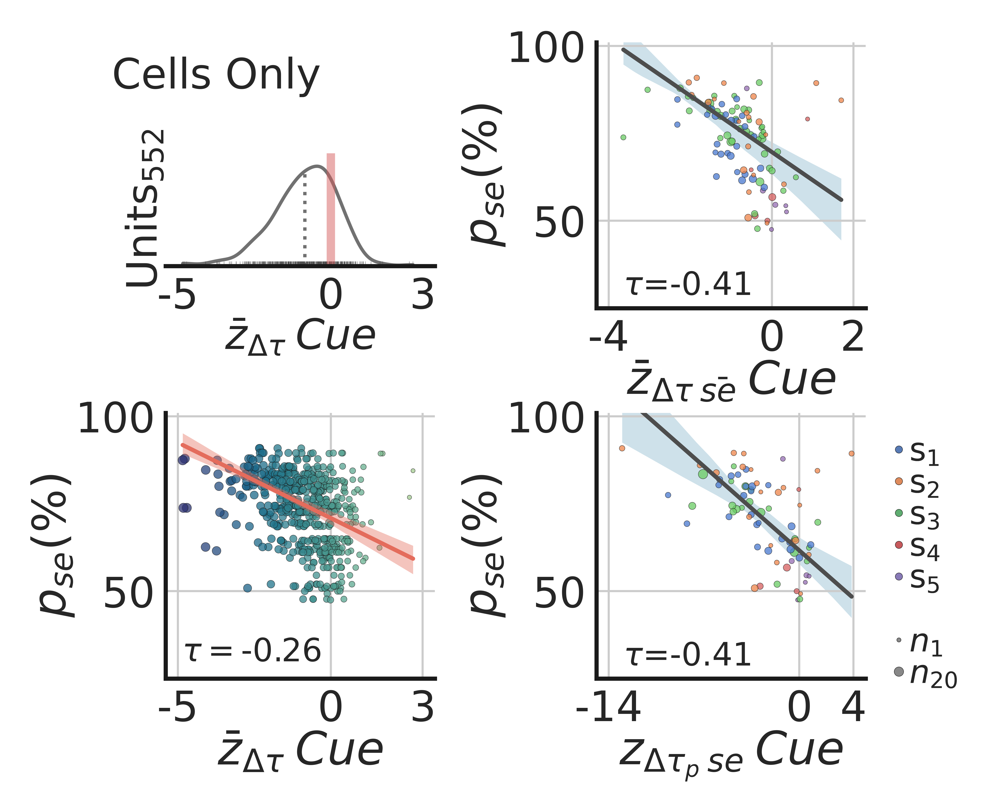

In [21]:
f.plot_remap_behav_summary(text=r'Cells Only')

In [16]:
print(f.mean_remap_score_label)

$\bar{z}_\Delta \tau \: \bar{se} \: Cue$


Text(0, 0, '$\\bar{z}_\\Delta \\rho \\: Cue$')

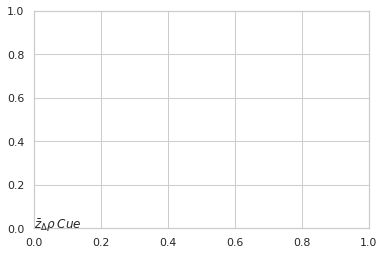

In [12]:
corr_str = r"\rho"
inner_str = r"\Delta {}".format(corr_str)
remap_score_label = r"$\bar{}_{} \: Cue$".format('{z}',inner_str)
plt.text(0,0,remap_score_label)
#print(inner_str)

In [415]:
'asdas'.capitalize()

'Asdas'

(<Figure size 2250x3300 with 2 Axes>,
 array([<AxesSubplot:xlabel='$\\bar{z}_{\\Delta \\tau \\: \\bar{se}} \\: Cue$', ylabel='$p_{se} (\\%)$'>,
        <AxesSubplot:xlabel='$z_{\\Delta \\tau_p \\:se} \\: Cue$', ylabel='$p_{se} (\\%)$'>],
       dtype=object))

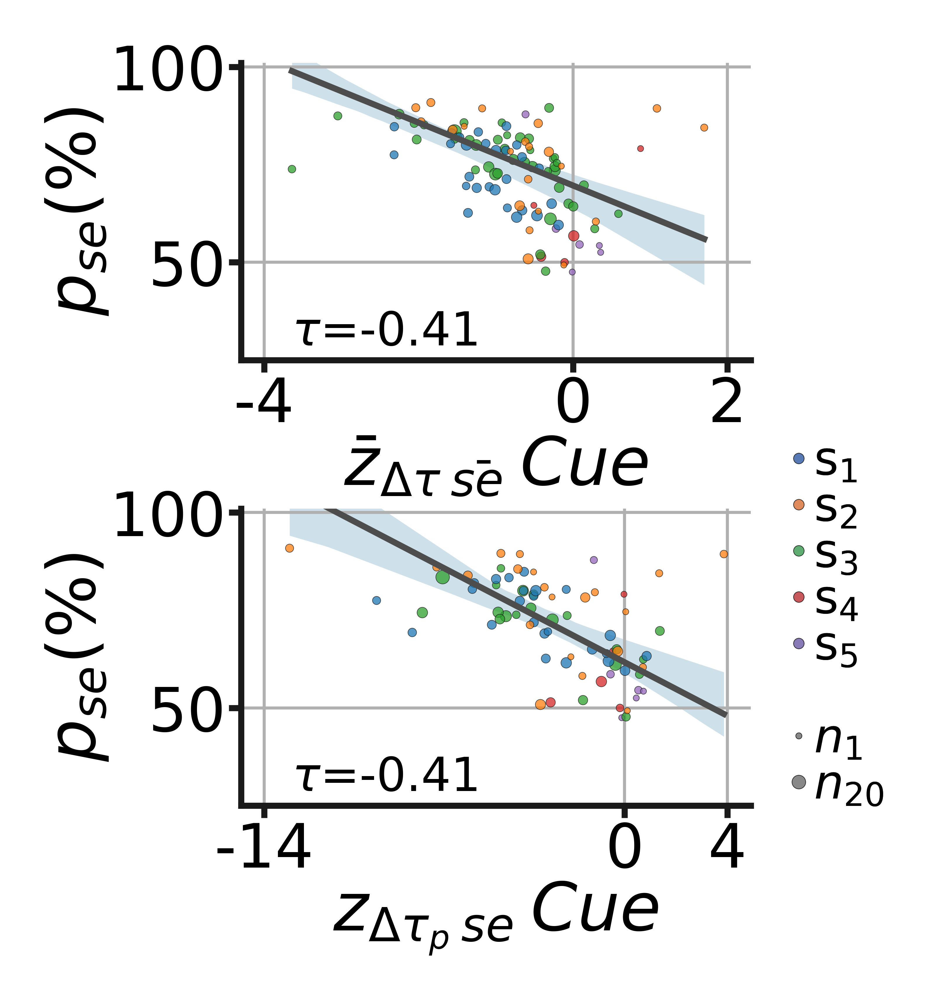

In [366]:
f.plot_stacked_pop_remap_behav()

(<Figure size 2250x3000 with 2 Axes>,
 [<AxesSubplot:label='A', ylabel='Units$_{552}$'>,
  <AxesSubplot:label='B', xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='$p_{se} (\\%)$'>])

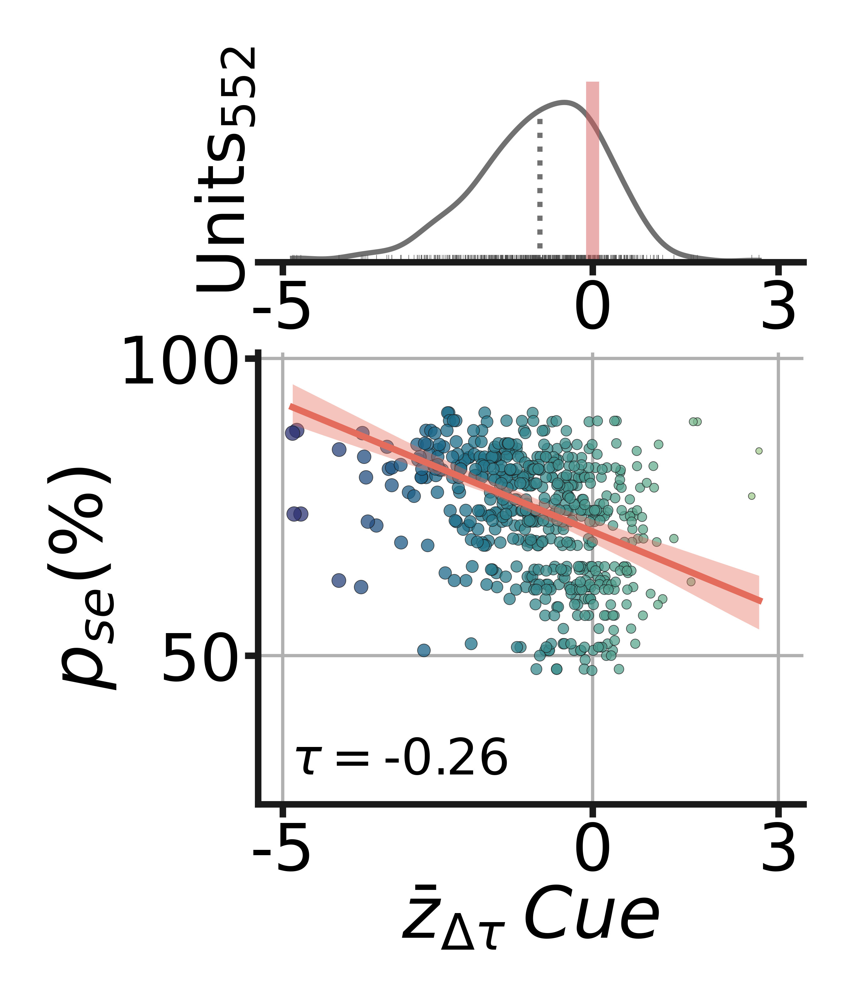

In [347]:
f.plot_stacked_unit_remap_dist_behav()

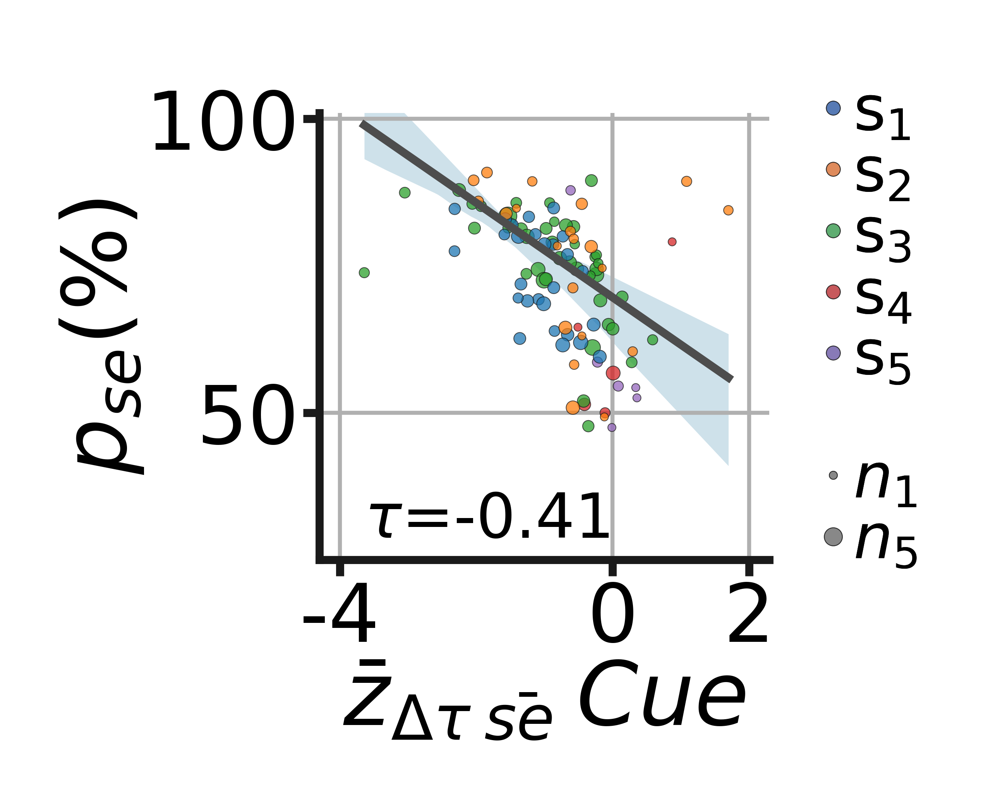

In [326]:
_, ax =f.plot_pop_mean_remap_v_beh()

# f._subj_marker_legend(ax,[1,5])

(<Figure size 1500x1500 with 1 Axes>,
 <AxesSubplot:xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='$p_{se} (\\%)$'>)

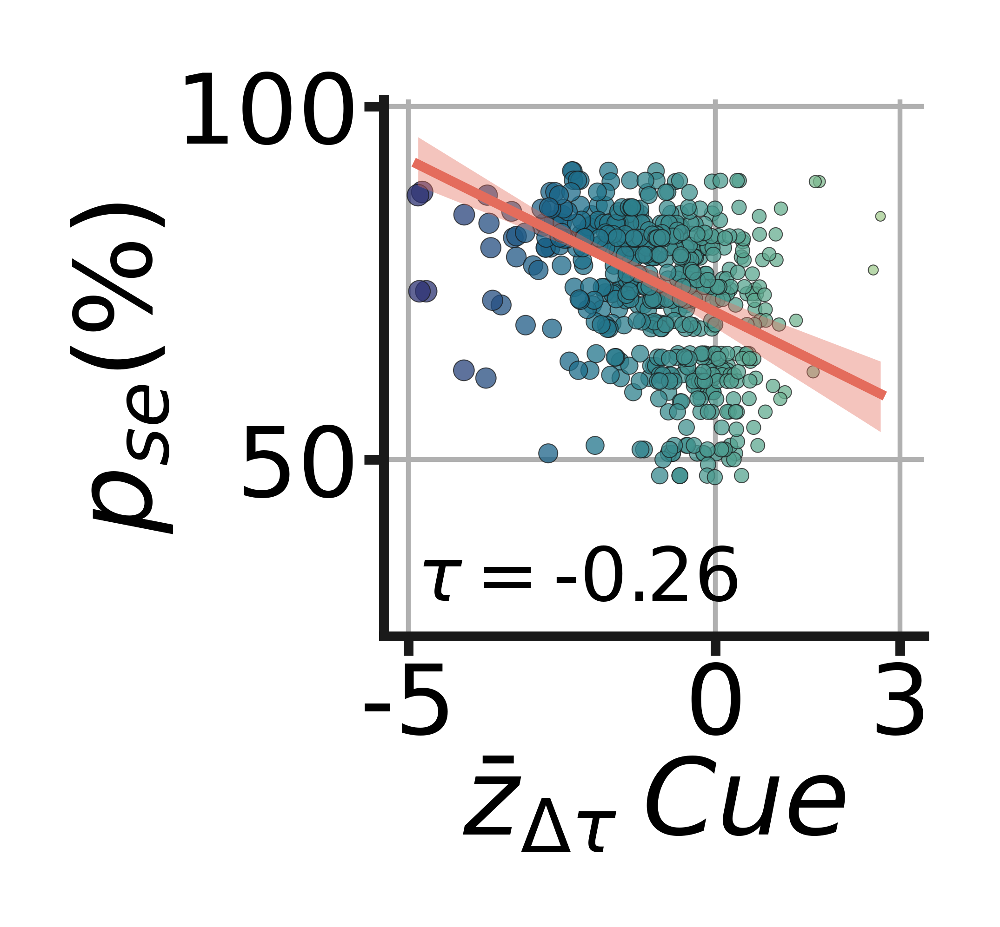

In [271]:
f.plot_unit_remap_v_beh()

In [265]:
min_marker_size = 1
max_marker_size = 5
n_marker_sizes = 21
marker_vals = np.linspace(min_marker_size, max_marker_size, n_marker_sizes)
marker_vals
np.digitize()


array([1. , 1.2, 1.4, 1.6, 1.8, 2. , 2.2, 2.4, 2.6, 2.8, 3. , 3.2, 3.4,
       3.6, 3.8, 4. , 4.2, 4.4, 4.6, 4.8, 5. ])

(<Figure size 1500x1500 with 4 Axes>,
 <AxesSubplot:label='D', xlabel='$z_{\\Delta \\tau_p \\:se} \\: Cue$', ylabel='$p_{se} (\\%)$'>)

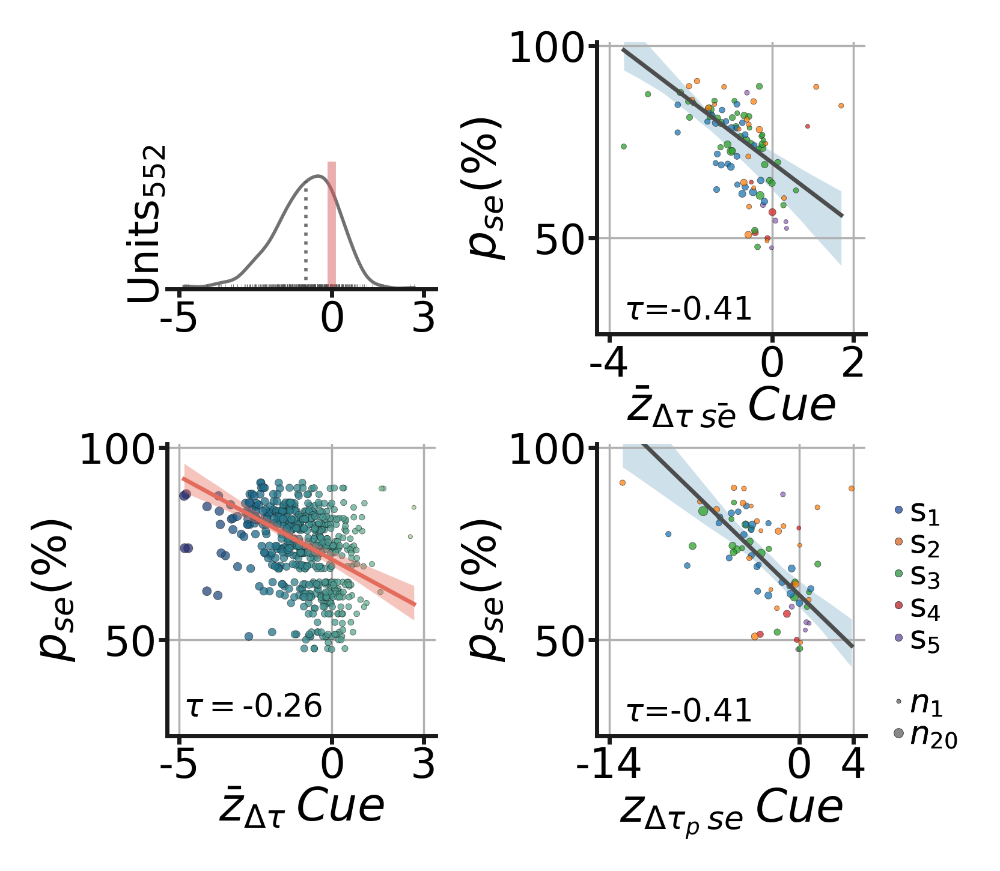

In [379]:
#fig, axs = plt.subplots(1,2, figsize=(3.5, 1.2), dpi=500)
fig, axs = plt.subplot_mosaic('''.C
                                 AC
                                 BD
                                 BD''', 
                              figsize=(3, 3), dpi=500, 
                              gridspec_kw={"hspace": 1.2, "wspace":0.6})

f.plot_unit_remap_dist(ax=axs['A'])
axs['A'].set_xlabel('')
p = axs['A'].get_position()
axs['A'].set_position([p.x0, p.y0+0.05, p.width, p.height*1.4])
f.plot_unit_remap_v_beh(ax=axs['B'])
f.plot_pop_mean_remap_v_beh(ax=axs['C'], legend=False)
f.plot_pop_corr_remap_v_beh(ax=axs['D'], legend=True)

#f.plot_pop_mean_remap_v_beh(ax=axs['C'])

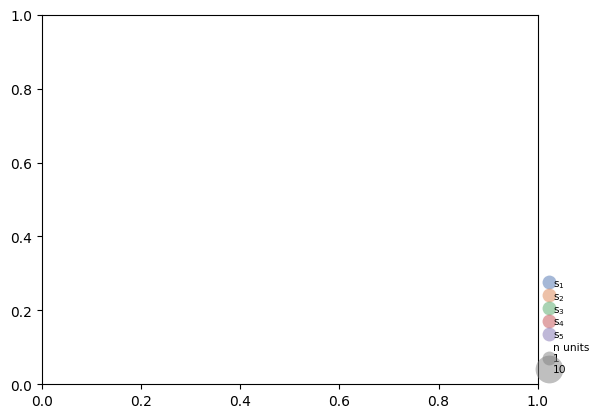

In [227]:
self = f

legend_params = dict(handlelength=0.25, handletextpad=0.2, bbox_to_anchor=[1.0,1.0], loc='upper left',
                             frameon=False, labelspacing=0.02,
                             fontsize=self.legend_fontsize)

legend_elements = []
labels = []
pal = [sns.palettes.color_palette(self.subject_palette)[ii] for ii in range(5)]
for ii, ss in enumerate(self.summary_info.subjects):
    legend_elements.append(
        plt.Line2D([0], [0], marker='o', alpha=0.5, markersize=10,
                   lw=0, mew=0, color=pal[ii], label=f"s$_{{{ii + 1}}}$"))
    labels.append(f"s$_{{{ii + 1}}}$")
legend_elements.append(plt.Line2D([],[], lw=0,label='n units'))
labels.append("n=")
legend_elements += [plt.Line2D([0], [0], marker='o', alpha=0.5, markersize=1,
                                   lw=0, mew=0, color='0.5', label=1),
                    plt.Line2D([0], [0], marker='o', alpha=0.5, markersize=5,
                               lw=0, mew=0, color='0.5', label=10)]
    
labels += [1,10]
legend_params = dict(handlelength=0.25, handletextpad=0.3, bbox_to_anchor=[1.0, 0], loc='lower left',
                     frameon=False, fontsize=self.legend_fontsize,
                     labelspacing=0.1)

plt.legend(handles=legend_elements, **legend_params)


In [221]:
legend_elements

 [],

In [215]:
f.summary_info.


[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254)]

In [236]:
v = f.pzrc_b['n_session_all']
min_n, max_n = np.percentile(v, [0,100])


np.linspace(5,15,6)





array([ 5.,  7.,  9., 11., 13., 15.])

In [266]:
np.digitize(v,np.linspace(min_n,max_n,6))

array([1, 1, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 4,
       4, 4, 1, 1, 1, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 4, 4, 4, 3, 3, 3, 3, 3, 3, 4, 4, 4, 2, 2, 2, 2, 2, 2,
       3, 3, 3, 2, 2, 2, 3, 3, 3, 1, 1, 1, 2, 2, 2, 1, 1, 1, 3, 3, 3, 3,
       3, 3, 4, 4, 4, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4,
       4, 2, 2, 2, 3, 3, 3, 3, 3, 3, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 3, 3, 3, 1, 1, 1, 2, 2, 2, 3, 3,
       3, 2, 2, 2, 4, 4, 4, 5, 5, 5, 5, 5, 5, 6, 6, 6, 4, 4, 4, 3, 3, 3,
       4, 4, 4, 4, 4, 4, 3, 3, 3, 4, 4, 4, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1,
       1, 1, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4,
       4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [143]:
scores = f.zrc_b[f.remap_score].copy()
scores.replace([np.inf, -np.inf], np.nan, inplace=True)
scores.dropna(inplace=True)
scores

2      -1.291234
3      -0.572054
4      -1.309451
5      -0.057607
6      -0.727981
          ...   
1926    0.356789
1930    0.339808
1936   -0.010541
1978   -0.423915
1979   -0.808466
Name: CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm, Length: 552, dtype: float64

In [158]:
pf = reload(pf)
a,(b1,b2)=pf.format_lims(scores)
#print(a, b1,b2)

print(pf.get_3nice_ticks(scores))

(array([-5.,  0.,  3.]), array(['-5', '0', '3.0'], dtype=object))


In [177]:
import copy
n_decimals=0
ticks,_ = pf.get_3nice_ticks(scores)

ticks2 = copy.deepcopy(ticks)
ticklabels = np.zeros(len(ticks), dtype=object)
for ii, t in enumerate(ticks):
    if isinstance(t, str):
        continue

    if t == 0:
        ticklabels[ii] = '0'
        continue

    t_str = f"{t}"
    t_split = t_str.split('.')

    if len(t_split) == 1:
        ticks2[ii] = int(t)
        ticklabels[ii] = f"{ticks2[ii]}"
    else:
        if len(t_split[0]) > 1:
            ticklabels[ii] = t_split[0]
            ticks2[ii] = int(t)
        else:
            if t >= 0:
                ticks2[ii] = np.ceil(t * 10 ** n_decimals) / 10 ** n_decimals  # np.around(t, n_decimals)
            else:
                ticks2[ii] = np.floor(t * 10 ** n_decimals) / 10 ** n_decimals
                
            if n_decimals==0:
                ticks2[ii] = int(ticks2[ii])   
            ticklabels[ii] = f"{ticks2[ii]}"
            

'3.0'

'3'

In [142]:
minV = np.floor(np.min(scores))
maxV = np.ceil(np.max(scores))
rangeV = maxV-minV
lims = minV-rangeV*0.05, maxV+rangeV*0.05
lims

(-5.4, 3.4)

In [157]:
a = np.append(lims, 0)
a.sort()
a

array([-5.4,  0. ,  3.4])

In [117]:
list(axs.values())

[<AxesSubplot:label='A', xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='Units (552)'>,
 <AxesSubplot:label='B', xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='$p_{se} (\\%)$'>]

In [104]:
axs

{'A': <AxesSubplot:label='A', xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='Units (552)'>,
 'B': <AxesSubplot:label='B', xlabel='$\\bar{z}_{\\Delta \\tau} \\: Cue$', ylabel='$p_{se} (\\%)$'>,
 ' ': <AxesSubplot:label=' '>}

In [96]:
a

(<Figure size 1000x1500 with 2 Axes>,
 {'A': <AxesSubplot:label='A'>, 'B': <AxesSubplot:label='B'>})

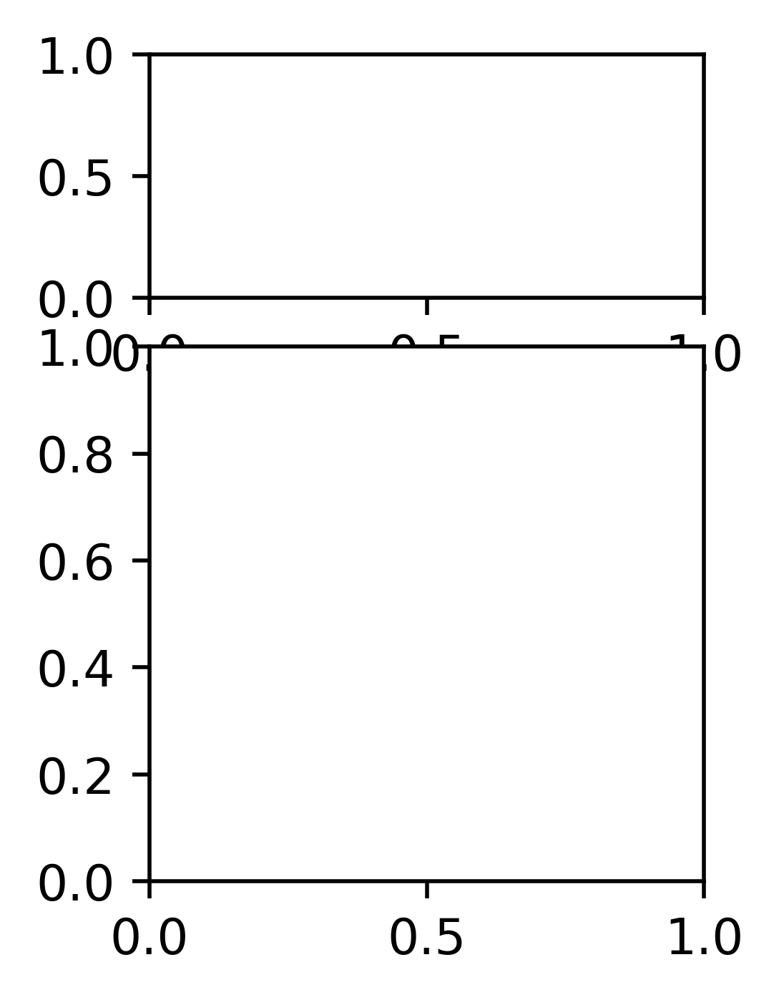

In [95]:
#plt.subplot_mosaic?



<AxesSubplot:xlabel='CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm'>

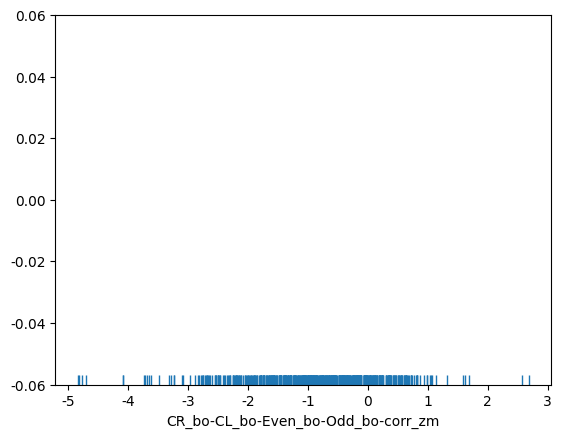

In [74]:
table = f.zrc_b
sns.rugplot(table[f.remap_score])

<AxesSubplot:xlabel='CR_bo-CL_bo-Even_bo-Odd_bo-corr_zm', ylabel='Density'>

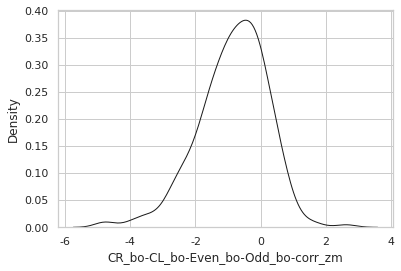

In [23]:
pf.plot_kde_dist(table[f.remap_score])

In [19]:
f.remap_score

'CR_bo-CL_bo-Even_bo-Odd_bo_corr_zm'

In [89]:
def foo(a):
    return a**2
x = p(delayed(foo)(i) for i in range(4))
x

[0, 1, 4, 9]

9
9
4
1
0
0
9
0
1
4
9
0
4
4
1
1
